# *Experiment 1*



Random Forest Models


### 0. Import Packages

In [ ]:
! pip install -r https://raw.githubusercontent.com/aso-uts/labs_datasets/main/36106-mlaa/requirements.txt

  Using cached pandas-2.1.1-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.3 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 1.5.3
    Uninstalling pandas-1.5.3:
      Successfully uninstalled pandas-1.5.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 1.2.0 requires sqlalchemy<3.0dev,>=1.4, but you have sqlalchemy 1.3.24 which is incompatible.
dataprep 0.4.5 requires pandas<2.0,>=1.1, but you have pandas 2.1.1 which is incompatible.
google-colab 1.0.0 requires pandas==2.0.3, but you have pandas 2.1.1 which is incompatible.
panel 1.3.8 requires bokeh<3.4.0,>=3.2.0, but you have bokeh 2.4.3 which is incompatible.


In [ ]:
! pip install dataprep

  Using cached pandas-1.5.3-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.1 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 2.1.1
    Uninstalling pandas-2.1.1:
      Successfully uninstalled pandas-2.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 1.2.0 requires sqlalchemy<3.0dev,>=1.4, but you have sqlalchemy 1.3.24 which is incompatible.
google-colab 1.0.0 requires pandas==2.0.3, but you have pandas 1.5.3 which is incompatible.
panel 1.3.8 requires bokeh<3.4.0,>=3.2.0, but you have bokeh 2.4.3 which is incompatible.


In [ ]:
import pandas as pd
import numpy as np
from dataprep.eda import plot, plot_correlation
from sklearn.metrics import fbeta_score, f1_score, accuracy_score, precision_score, recall_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.ensemble import RandomForestClassifier
from matplotlib import pyplot as plt

In [ ]:
# initializing lists for storing metrics and results
model_names_list = []
number_of_estimators_list = []
max_depth_list = []
avg_depth_list = []
min_samples_leaf_list = []
max_features_list = []
class_weights = []
criteria = []
training_accuracy_list = []
training_precision_list = []
training_recall_list = []
training_f1_list = []
training_f2_list = []
training_f3_list = []
validation_accuracy_list = []
validation_precision_list = []
validation_recall_list = []
validation_f1_list = []
validation_f2_list = []
validation_f3_list = []
accuracy_losses_list = []
precision_losses_list = []
recall_losses_list = []
f1_losses_list = []
f2_losses_list = []
f3_losses_list = []
cm_train_list = []
cm_val_list = []

In [ ]:
# preferences for ConfusionMatrixDisplay

def configure_CM(cm_display, title):
  cm_display.ax_.set_xlabel("Target?")
  cm_display.ax_.set_ylabel("Buys")
  cm_display.ax_.set_xticklabels(["Yes", "No"])
  cm_display.ax_.set_yticklabels(["Yes", "No"])
  cm_display.ax_.set_title(title)

In [ ]:
# Function to generate an RFC and store metrics

def plant_forest(name, n_estimators=100, max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0, max_features='sqrt', max_leaf_nodes=None, class_weight=None, criterion='gini', min_impurity_decrease=0.0):
  # instantiating model with specified hyperparameters
  model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf, min_weight_fraction_leaf=min_weight_fraction_leaf, max_features=max_features, max_leaf_nodes=max_leaf_nodes, min_impurity_decrease=min_impurity_decrease, random_state=1917, class_weight=class_weight, criterion=criterion)
  # fitting model
  model.fit(X_train, y_train)
  # training results
  preds_train = model.predict(X_train)
  accuracy_train = accuracy_score(y_train, preds_train)
  precision_train = precision_score(y_train, preds_train, labels=[1, 0])
  recall_train = recall_score(y_train, preds_train, labels=[1, 0])
  f1_train = f1_score(y_train, preds_train, labels=[1, 0])
  f2_train = fbeta_score(y_train, preds_train, beta=2, labels=[1, 0])
  f3_train = fbeta_score(y_train, preds_train, beta=3, labels=[1, 0])
  # validation results
  preds_val = model.predict(X_val)
  accuracy_val = accuracy_score(y_val, preds_val)
  precision_val = precision_score(y_val, preds_val, labels=[1, 0])
  recall_val = recall_score(y_val, preds_val, labels=[1, 0])
  f1_val = f1_score(y_val, preds_val, labels=[1, 0])
  f2_val = fbeta_score(y_val, preds_val, beta=2, labels=[1, 0])
  f3_val = fbeta_score(y_val, preds_val, beta=2, labels=[1, 0])
  # Generalization loss
  accuracy_loss = accuracy_train - accuracy_val
  precision_loss = precision_train - precision_val
  recall_loss = recall_train - recall_val
  f1_loss = f1_train - f1_val
  f2_loss = f2_train - f2_val
  f3_loss = f3_train - f3_val
  # Storing info in lists
  model_params = model.get_params
  avg_depth = np.mean([estimator.tree_.max_depth for estimator in model.estimators_])
  model_names_list.append(name)
  number_of_estimators_list.append(n_estimators)
  max_depth_list.append(max_depth)
  avg_depth_list.append(avg_depth)
  min_samples_leaf_list.append(min_samples_leaf)
  max_features_list.append(max_features)
  class_weights.append(class_weight)
  criteria.append(criterion)
  training_accuracy_list.append(accuracy_train)
  training_precision_list.append(precision_train)
  training_recall_list.append(recall_train)
  training_f1_list.append(f1_train)
  training_f2_list.append(f2_train)
  validation_accuracy_list.append(accuracy_val)
  validation_precision_list.append(precision_val)
  validation_recall_list.append(recall_val)
  validation_f1_list.append(f1_val)
  validation_f2_list.append(f2_val)
  accuracy_losses_list.append(accuracy_loss)
  precision_losses_list.append(precision_loss)
  recall_losses_list.append(recall_loss)
  f1_losses_list.append(f1_loss)
  f2_losses_list.append(f2_loss)
  f3_losses_list.append(f3_loss)
  # Printing key measures
  print(f"Training Accuracy for {name}: ", accuracy_train)
  print(f"Training Precision for {name}: ", precision_train)
  print(f"Training Recall for {name}: ", recall_train)
  print(f"Training F1 Score for {name}: ", f1_train)
  print(f"Training F2 Score for {name}: ", f2_train)
  print(f"Training F3 Score for {name}: ", f3_train)
  print("")
  print(f"Validation Accuracy for {name}: ", accuracy_val)
  print(f"Validation Precision for {name}: ", precision_val)
  print(f"Validation Recall for {name}: ", recall_val)
  print(f"Validation F1 Score for {name}: ", f1_val)
  print(f"Validation F2 Score for {name}: ", f2_val)
  print(f"Validation F3 Score for {name}: ", f3_val)
  print("")
  print(f"Accuracy Generalization Loss for {name}: ", accuracy_loss)
  print(f"Precision Generalization Loss for {name}: ", precision_loss)
  print(f"Recall Generalization Loss for {name}: ", recall_loss)
  print(f"F1 Generalization Loss for {name}: ", f1_loss)
  print(f"F2 Generalization Loss for {name}: ", f2_loss)
  print(f"F3 Generalization Loss for {name}: ", f3_loss)
  print("")
  # Confusion Matrices
  cm_train = confusion_matrix(y_train, preds_train, labels=[1, 0])
  cm_val = confusion_matrix(y_val, preds_val, labels=[1, 0])
  cm_train_list.append(cm_train)
  cm_val_list.append(cm_val)
  CM_train = ConfusionMatrixDisplay.from_predictions(y_train, preds_train, labels=[1, 0])
  configure_CM(CM_train, f"Confusion Matrix for {name} on training data")
  plt.show()
  CM_val = ConfusionMatrixDisplay.from_predictions(y_val, preds_val, labels=[1, 0])
  configure_CM(CM_val, f"Confusion Matrix for {name} on validation data")

  # return model
  return model


### 1.   Load Dataset

In [ ]:
file_url = 'https://raw.githubusercontent.com/karlcatsky/MLAA-Assignment-2/main/repurchase_dataset%20-%20repurchase_dataset.csv'

In [ ]:
df = pd.read_csv(file_url)

### 2. Explore Dataset

In [ ]:
df.head()

,ID,Target,age_band,gender,car_model,car_segment,age_of_vehicle_years,sched_serv_warr,non_sched_serv_warr,sched_serv_paid,non_sched_serv_paid,total_paid_services,total_services,mth_since_last_serv,annualised_mileage,num_dealers_visited,num_serv_dealer_purchased
0,1,0,3. 35 to 44,Male,model_1,LCV,9,2,10,3,7,5,6,9,8,10,4
1,2,0,NaN,NaN,model_2,Small/Medium,6,10,3,10,4,9,10,6,10,7,10
2,3,0,NaN,Male,model_3,Large/SUV,9,10,9,10,9,10,10,7,10,6,10
3,5,0,NaN,NaN,model_3,Large/SUV,5,8,5,8,4,5,6,4,10,9,7
4,6,0,NaN,Female,model_2,Small/Medium,8,9,4,10,7,9,8,5,4,4,9


In [ ]:
df['sched_serv_warr'].unique()

array([ 2, 10,  8,  9,  4,  1,  3,  7,  5,  6])

In [ ]:
df.tail()

,ID,Target,age_band,gender,car_model,car_segment,age_of_vehicle_years,sched_serv_warr,non_sched_serv_warr,sched_serv_paid,non_sched_serv_paid,total_paid_services,total_services,mth_since_last_serv,annualised_mileage,num_dealers_visited,num_serv_dealer_purchased
131332,154134,1,NaN,NaN,model_3,Large/SUV,7,10,10,9,10,10,10,3,6,10,10
131333,154135,1,NaN,NaN,model_3,Large/SUV,4,10,10,10,10,10,10,2,3,10,10
131334,154137,1,NaN,NaN,model_5,Large/SUV,4,4,9,5,4,3,8,4,7,10,10
131335,154138,1,NaN,NaN,model_5,Large/SUV,2,1,10,1,10,9,8,3,6,7,10
131336,154139,1,NaN,NaN,model_1,LCV,6,1,7,1,10,10,5,3,4,9,10


In [ ]:
df.describe()

,ID,Target,age_of_vehicle_years,sched_serv_warr,non_sched_serv_warr,sched_serv_paid,non_sched_serv_paid,total_paid_services,total_services,mth_since_last_serv,annualised_mileage,num_dealers_visited,num_serv_dealer_purchased
count,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000,131337.000000
mean,77097.384180,0.026809,5.493022,5.452500,5.472517,5.452287,5.497050,5.481692,5.454967,5.469807,5.502836,5.485438,5.480778
std,44501.636704,0.161525,2.843299,2.884328,2.870665,2.886528,2.878699,2.880408,2.875961,2.859756,2.854896,2.876772,2.867524
min,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,38563.000000,0.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
50%,77132.000000,0.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
75%,115668.000000,0.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000
max,154139.000000,1.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 131337 entries, 0 to 131336
Data columns (total 17 columns):
 #   Column                     Non-Null Count   Dtype 
---  ------                     --------------   ----- 
 0   ID                         131337 non-null  int64 
 1   Target                     131337 non-null  int64 
 2   age_band                   18962 non-null   object
 3   gender                     62029 non-null   object
 4   car_model                  131337 non-null  object
 5   car_segment                131337 non-null  object
 6   age_of_vehicle_years       131337 non-null  int64 
 7   sched_serv_warr            131337 non-null  int64 
 8   non_sched_serv_warr        131337 non-null  int64 
 9   sched_serv_paid            131337 non-null  int64 
 10  non_sched_serv_paid        131337 non-null  int64 
 11  total_paid_services        131337 non-null  int64 
 12  total_services             131337 non-null  int64 
 13  mth_since_last_serv        131337 non-null  

In [ ]:
print(df['car_segment'].unique())

['LCV' 'Small/Medium' 'Large/SUV' 'Other']


In [ ]:
print(df['car_model'].unique())

['model_1' 'model_2' 'model_3' 'model_5' 'model_6' 'model_4' 'model_7'
 'model_8' 'model_9' 'model_10' 'model_11' 'model_13' 'model_12'
 'model_14' 'model_15' 'model_16' 'model_17' 'model_18' 'model_19']


Given that we only get nulls in age_band and gender (and a lot of them), we would be justified in simply dropping these columns.

no duplicates

In [ ]:
duplicates_binary = df.duplicated()
duplicates = duplicates_binary.loc[duplicates_binary == True]
duplicates

Series([], dtype: bool)

### 3. Explore Target variable

In [ ]:
target = df['Target']

In [ ]:
target.describe()

count    131337.000000
mean          0.026809
std           0.161525
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: Target, dtype: float64

In [ ]:
target.info()

<class 'pandas.core.series.Series'>
RangeIndex: 131337 entries, 0 to 131336
Series name: Target
Non-Null Count   Dtype
--------------   -----
131337 non-null  int64
dtypes: int64(1)
memory usage: 1.0 MB


In [ ]:
target_counts = target.value_counts()

In [ ]:
target_counts

0    127816
1      3521
Name: Target, dtype: int64

In [ ]:
class_imbalance = target_counts[0] / target_counts[1]
print("Class Imbalance: ", class_imbalance)

Class Imbalance:  36.30105083783016


by convention, actual 0 represents positive and actually 1 represents negative, so the confusion matrix interprets 0 (only bought one vehicle) as positive and 1 (bought more than one vehicle) as negative. We could swap these around to make them more intuitive. It is more intuitive to say we are trying to predict positive cases where the customer did buy more than one vehicle.

Target is imbalanced in favour of 0 (customer has only purchased 1 vehicle)

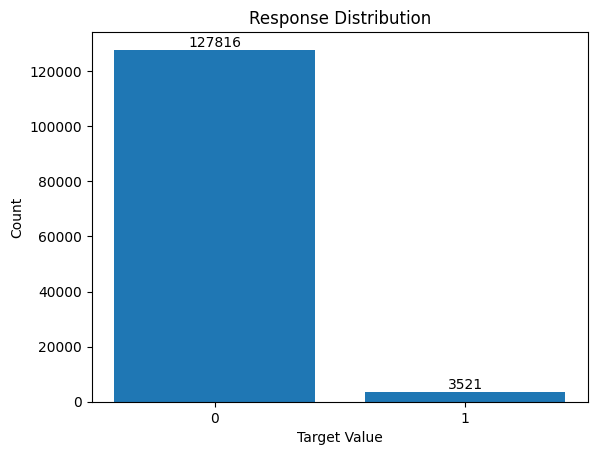

In [ ]:
import matplotlib.pyplot as plt

plt.bar(target_counts.index, target_counts.values)
plt.xlabel('Target Value')
plt.ylabel('Count')
plt.title('Response Distribution')

plt.xticks([0, 1])

for i, value in enumerate(target_counts.values):
  plt.text(i, value, str(value), ha='center', va='bottom')

plt.show()


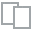
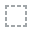
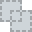
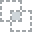
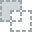
...
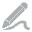
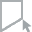
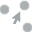
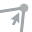
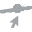

In [ ]:
plot_correlation(df, 'Target')

### 4. Explore Variables of Interest

In [ ]:
# Defining a function to:
#   Calculate a response rate for each unique value in a column
#   Display a barchart showing response rates
#   Take as input: dataframe, column

def respond(data, col, target):
  # unique values
  vals = data[col].unique()
  # rr dict
  RRs = {}
  # locate unique vals
  for val in vals:
    rows = data.loc[data[col] == val]
    rr = rows[target].mean()
    # store in a dict
    RRs[val] = rr
  # make and display barchart
  plt.bar(*zip(*RRs.items()))
  plt.xlabel(f"{col}")
  plt.ylabel('Response Rate')
  plt.title(f'Response Rate by {col}')
  plt.xticks(rotation=90)
  plt.show()

  return RRs

In [ ]:
df.columns

Index(['ID', 'Target', 'age_band', 'gender', 'car_model', 'car_segment',
       'age_of_vehicle_years', 'sched_serv_warr', 'non_sched_serv_warr',
       'sched_serv_paid', 'non_sched_serv_paid', 'total_paid_services',
       'total_services', 'mth_since_last_serv', 'annualised_mileage',
       'num_dealers_visited', 'num_serv_dealer_purchased'],
      dtype='object')

Car Model

/usr/local/lib/python3.10/dist-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))



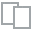
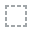
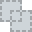
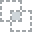
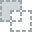
...
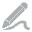
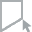
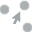
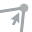
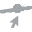

In [ ]:
plot(df, 'car_model')

In [ ]:
df['car_model'].describe()

count      131337
unique         19
top       model_2
freq        34491
Name: car_model, dtype: object

In [ ]:
df['car_model'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 131337 entries, 0 to 131336
Series name: car_model
Non-Null Count   Dtype 
--------------   ----- 
131337 non-null  object
dtypes: object(1)
memory usage: 1.0+ MB


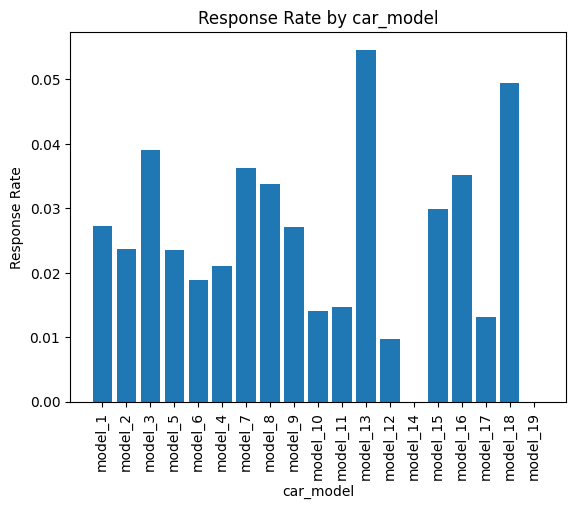

{'model_1': 0.027265018589785403,
 'model_2': 0.023687338726044477,
 'model_3': 0.039065245402366174,
 'model_5': 0.02358758207019535,
 'model_6': 0.018886356235753826,
 'model_4': 0.020983173870009898,
 'model_7': 0.036243418635974044,
 'model_8': 0.03383516995188577,
 'model_9': 0.02716297786720322,
 'model_10': 0.013996889580093312,
 'model_11': 0.014705882352941176,
 'model_13': 0.0546218487394958,
 'model_12': 0.009771986970684038,
 'model_14': 0.0,
 'model_15': 0.029940119760479042,
 'model_16': 0.03508771929824561,
 'model_17': 0.013071895424836602,
 'model_18': 0.04950495049504951,
 'model_19': 0.0}

In [ ]:
respond(df, 'car_model', 'Target')

One-hot encode car_model

car_segment

In [ ]:
#plot(df, 'car_segment')

In [ ]:
df['car_segment'].describe()

count           131337
unique               4
top       Small/Medium
freq             54553
Name: car_segment, dtype: object

In [ ]:
types = df['car_segment'].unique()

In [ ]:
types

array(['LCV', 'Small/Medium', 'Large/SUV', 'Other'], dtype=object)

In [ ]:
# plot correlations between car_segment and target
small_medium = df.loc[df['car_segment'] == "Small/Medium"]
large_SUV = df.loc[df['car_segment'] == "Large/SUV"]
LCV = df.loc[df['car_segment'] == "LCV"]
Other = df.loc[df['car_segment'] == "Other"]

In [ ]:
small_medium_response_rate = small_medium['Target'].mean()
large_SUV_response_rate = large_SUV['Target'].mean()
LCV_response_rate = LCV['Target'].mean()
Other_response_rate = Other['Target'].mean()

response_rates = [LCV_response_rate, small_medium_response_rate, large_SUV_response_rate, Other_response_rate]

car_segment_response_rates = pd.DataFrame({
    'Type': types,
    'Response Rate': response_rates
})

car_segment_response_rates.sort_values('Response Rate', inplace=True, ascending=False)
car_segment_response_rates

,Type,Response Rate
0,LCV,0.030277
2,Large/SUV,0.029758
1,Small/Medium,0.022437
3,Other,0.017241


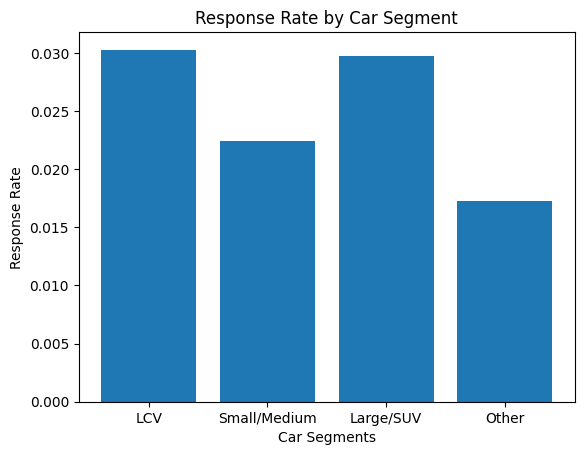

In [ ]:
plt.bar(types, response_rates)
plt.xlabel('Car Segments')
plt.ylabel('Response Rate')
plt.title('Response Rate by Car Segment')

plt.show()

Can't necessarily assume a ranking based on response rate. One hot encode car segment.

age_of_vehicle_years

In [ ]:
df['age_of_vehicle_years'].describe()

count    131337.000000
mean          5.493022
std           2.843299
min           1.000000
25%           3.000000
50%           5.000000
75%           8.000000
max          10.000000
Name: age_of_vehicle_years, dtype: float64


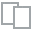
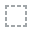
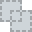
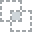
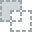
...
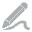
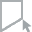
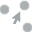
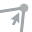
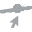

In [ ]:
plot(df, 'age_of_vehicle_years')

In [ ]:
df['age_of_vehicle_years'].value_counts()

3     13825
2     13633
4     13537
5     13438
7     13227
6     13114
10    12996
9     12840
8     12834
1     11893
Name: age_of_vehicle_years, dtype: int64

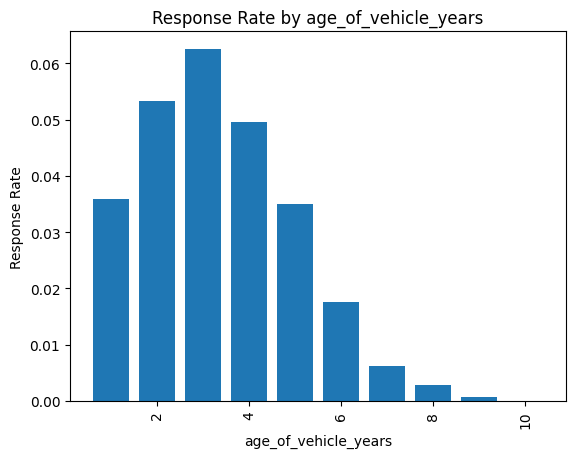

{9: 0.0007009345794392523,
 6: 0.017614762848863808,
 5: 0.035049858609912186,
 8: 0.002805049088359046,
 7: 0.006199440538292886,
 1: 0.03590347263095939,
 3: 0.06256781193490055,
 4: 0.04956785107483194,
 10: 7.694675284702985e-05,
 2: 0.05339983862686129}

In [ ]:
respond(df, 'age_of_vehicle_years', 'Target')

age_of_vehicle_years has an interestingly normal looking distribution for response rate. Interpretation: those who bought a new car recently are less likely to buy a new one for obvious reasons. OTOH those who bought their last car a long time ago likely don't have the income to buy a new car, or are simply the kind of customer who gets attached to their car and prefers repairing to buying a new one.

sched_serv_warr

In [ ]:
df['sched_serv_warr']

0          2
1         10
2         10
3          8
4          9
          ..
131332    10
131333    10
131334     4
131335     1
131336     1
Name: sched_serv_warr, Length: 131337, dtype: int64

In [ ]:
df['sched_serv_warr'].describe()

count    131337.000000
mean          5.452500
std           2.884328
min           1.000000
25%           3.000000
50%           5.000000
75%           8.000000
max          10.000000
Name: sched_serv_warr, dtype: float64


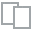
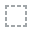
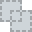
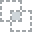
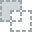
...
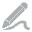
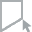
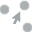
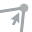
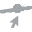

In [ ]:
plot(df, 'sched_serv_warr')

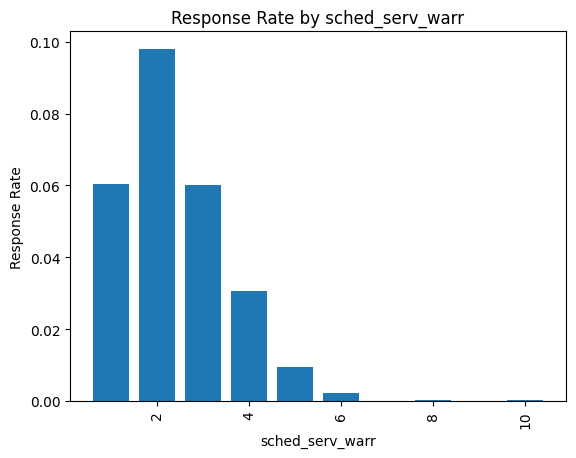

{2: 0.09798375398897592,
 10: 0.000154954675757341,
 8: 0.0001545833977430824,
 9: 0.0,
 4: 0.030543072587401934,
 1: 0.06029368140017799,
 3: 0.06020293122886133,
 7: 7.79058896852602e-05,
 5: 0.009565285014386811,
 6: 0.0020814061054579094}

In [ ]:
respond(df, 'sched_serv_warr', 'Target')

In [ ]:
df['sched_serv_warr'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 131337 entries, 0 to 131336
Series name: sched_serv_warr
Non-Null Count   Dtype
--------------   -----
131337 non-null  int64
dtypes: int64(1)
memory usage: 1.0 MB


rr for sched_serv_warr looks semi-normal.

non_sched_serv_warr


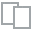
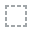
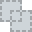
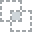
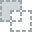
...
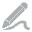
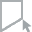
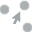
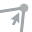
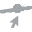

In [ ]:
plot(df, 'non_sched_serv_warr')

In [ ]:
df['non_sched_serv_warr'].describe()

count    131337.000000
mean          5.472517
std           2.870665
min           1.000000
25%           3.000000
50%           5.000000
75%           8.000000
max          10.000000
Name: non_sched_serv_warr, dtype: float64

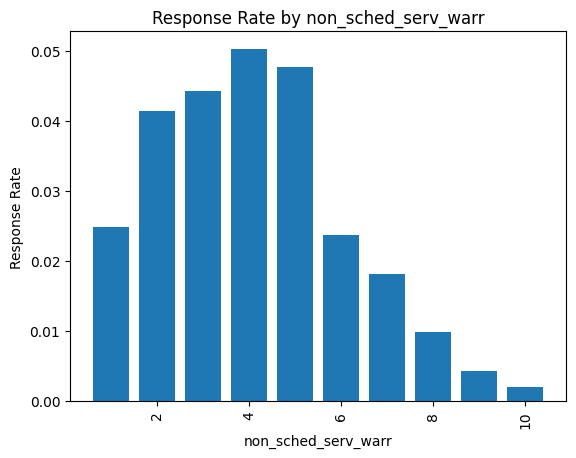

{10: 0.0019934064249022463,
 3: 0.044208932626797884,
 9: 0.004272508350811777,
 5: 0.04762977988130118,
 4: 0.0502738800930442,
 8: 0.009859046445351613,
 1: 0.024837686848860032,
 6: 0.023634694814134924,
 2: 0.04136582430806258,
 7: 0.018190226607060274}

In [ ]:
respond(df, 'non_sched_serv_warr', 'Target')

again, the rr has a semi-normal distro. Customers in and around 4 nssw are more likely to buy more than one car: 4 is the number where most customers will cut their losses and buy a new car; those at the higher end of nssw are either attached to their cars or don't have the means to purchase a new one.

sched_serv_paid

In [ ]:
df['sched_serv_paid']

0          3
1         10
2         10
3          8
4         10
          ..
131332     9
131333    10
131334     5
131335     1
131336     1
Name: sched_serv_paid, Length: 131337, dtype: int64


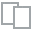
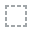
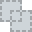
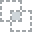
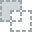
...
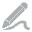
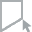
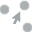
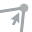
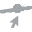

In [ ]:
plot(df, 'sched_serv_paid')

In [ ]:
df['sched_serv_paid'].describe()

count    131337.000000
mean          5.452287
std           2.886528
min           1.000000
25%           3.000000
50%           5.000000
75%           8.000000
max          10.000000
Name: sched_serv_paid, dtype: float64

In [ ]:
df['sched_serv_paid'].value_counts()

2     13718
1     13587
3     13273
4     13122
9     13088
10    12957
7     12934
5     12911
8     12910
6     12837
Name: sched_serv_paid, dtype: int64

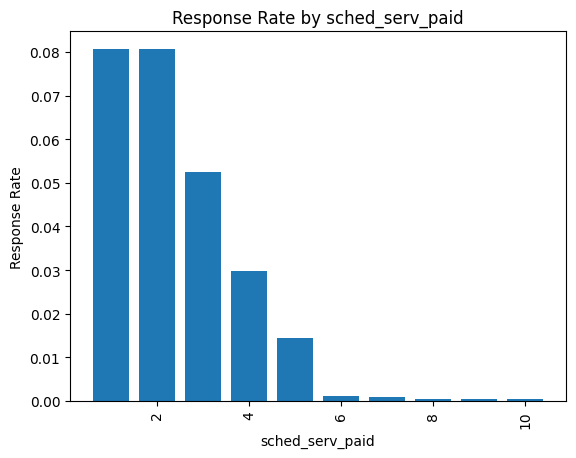

{3: 0.0524372786860544,
 10: 0.00046307015512850195,
 8: 0.0005422153369481022,
 5: 0.014483773526450314,
 2: 0.08069689459104826,
 6: 0.0010905974916257692,
 1: 0.08059174210642527,
 4: 0.029797286998933088,
 9: 0.0004584352078239609,
 7: 0.000927787227462502}

In [ ]:
respond(df, 'sched_serv_paid', 'Target')

non_sched_serv_paid

In [ ]:
df['non_sched_serv_paid']

0          7
1          4
2          9
3          4
4          7
          ..
131332    10
131333    10
131334     4
131335    10
131336    10
Name: non_sched_serv_paid, Length: 131337, dtype: int64

In [ ]:
df['non_sched_serv_paid'].describe()

count    131337.000000
mean          5.497050
std           2.878699
min           1.000000
25%           3.000000
50%           5.000000
75%           8.000000
max          10.000000
Name: non_sched_serv_paid, dtype: float64

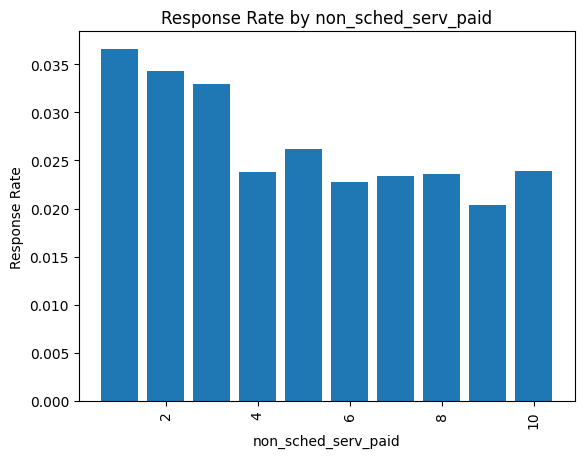

{7: 0.0233728039625416,
 4: 0.02382764920828258,
 9: 0.02041896695152386,
 3: 0.03296703296703297,
 1: 0.036591860022822366,
 2: 0.03432442604441099,
 6: 0.02273073989321129,
 5: 0.02619047619047619,
 10: 0.02393175298203231,
 8: 0.023590686274509803}

In [ ]:
respond(df, 'non_sched_serv_paid', 'Target')

total_paid_services

In [ ]:
df['total_paid_services'].describe()

count    131337.000000
mean          5.481692
std           2.880408
min           1.000000
25%           3.000000
50%           5.000000
75%           8.000000
max          10.000000
Name: total_paid_services, dtype: float64

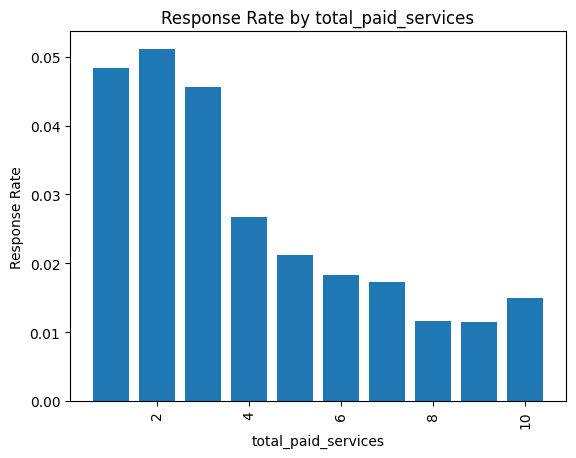

{5: 0.0212798766383963,
 9: 0.011436413540713633,
 10: 0.015021622031712313,
 6: 0.01827077440562648,
 8: 0.011570502931194077,
 1: 0.048445517657712045,
 2: 0.05114861348598617,
 7: 0.017297297297297298,
 3: 0.045602114005285015,
 4: 0.026662603793707624}

In [ ]:
respond(df, 'total_paid_services', 'Target')

total_services

In [ ]:
df['total_services'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 131337 entries, 0 to 131336
Series name: total_services
Non-Null Count   Dtype
--------------   -----
131337 non-null  int64
dtypes: int64(1)
memory usage: 1.0 MB


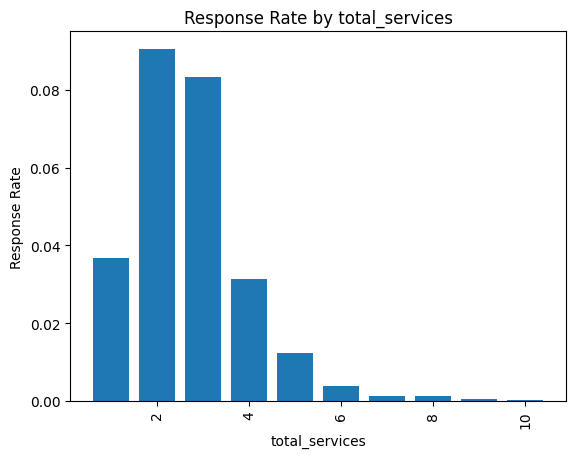

{6: 0.003820001528000611,
 10: 0.00023082249749942294,
 8: 0.0011695906432748538,
 4: 0.03142748958727755,
 2: 0.0904887714663144,
 1: 0.03673964093629271,
 3: 0.08319296960820212,
 5: 0.012322858903265557,
 9: 0.0005407075544569751,
 7: 0.001327191818252791}

In [ ]:
respond(df, 'total_services', 'Target')

mth_since_last_serv

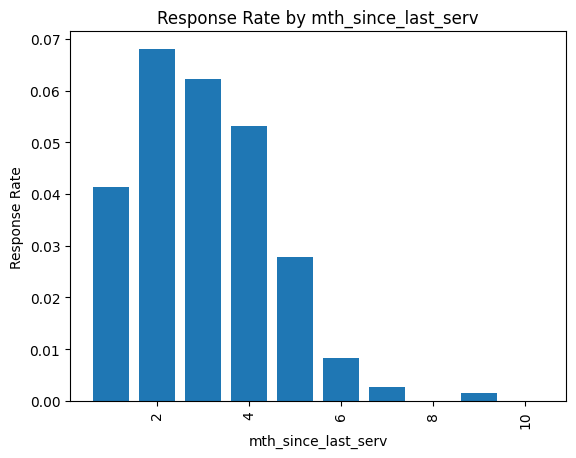

{9: 0.001549666821633349,
 6: 0.008211678832116789,
 7: 0.002635658914728682,
 4: 0.05307056392087393,
 5: 0.027806925498426022,
 8: 7.74233508826262e-05,
 1: 0.041412544236126794,
 3: 0.06232578085912372,
 10: 0.0,
 2: 0.06803924722534985}

In [ ]:
respond(df, 'mth_since_last_serv', 'Target')

annualised_mileage

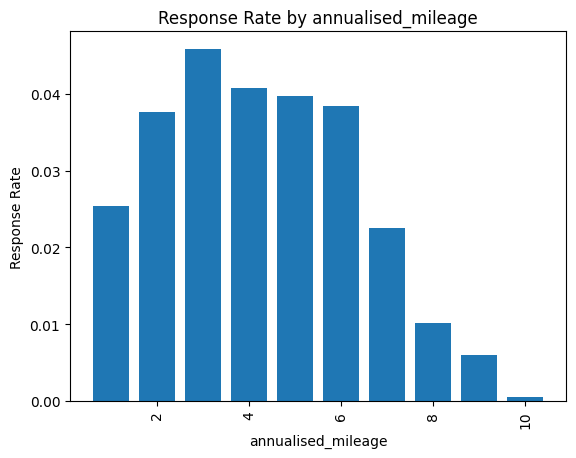

{8: 0.010200168724595445,
 10: 0.0005377170072207712,
 4: 0.04071624934987741,
 5: 0.03970610063826629,
 6: 0.03836374513909662,
 1: 0.02541589648798521,
 7: 0.02248038624019312,
 3: 0.045848540145985404,
 9: 0.00596252129471891,
 2: 0.03765095903386218}

In [ ]:
respond(df, 'annualised_mileage', 'Target')

num_dealers_visited

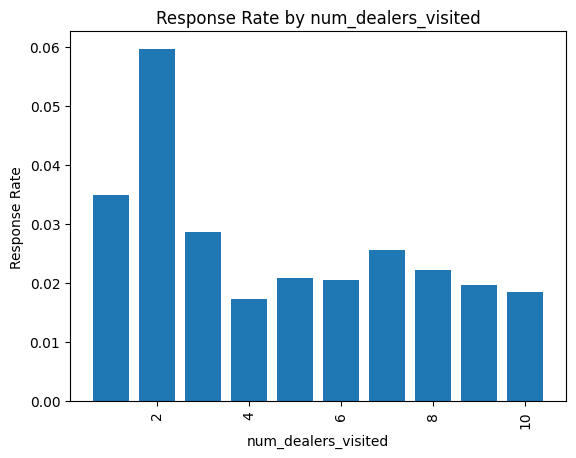

{10: 0.01849445930454719,
 7: 0.025607404550713458,
 6: 0.020425208807896736,
 9: 0.019558214450069028,
 4: 0.017177630565398245,
 5: 0.02089712186160441,
 2: 0.05958975894594999,
 1: 0.034828496042216356,
 3: 0.02854546831225865,
 8: 0.02211618571536772}

In [ ]:
respond(df, 'num_dealers_visited', 'Target')

num_serv_dealer_purchased

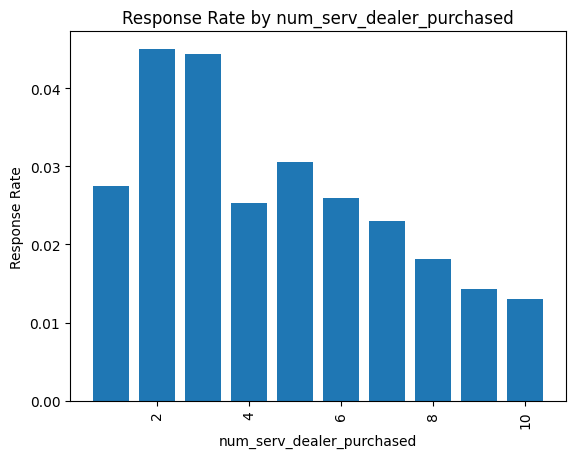

{4: 0.025281754492841913,
 10: 0.01307290064595509,
 7: 0.02297794117647059,
 9: 0.014264671679975192,
 8: 0.018206854345165238,
 3: 0.04433199909372404,
 1: 0.027535566773749427,
 6: 0.025968143730655997,
 2: 0.04499588907990134,
 5: 0.030529736265397112}

In [ ]:
respond(df, 'num_serv_dealer_purchased', 'Target')

### 5. Prepare Data

In [ ]:
df_cleaned = df.drop(['age_band', 'gender', 'ID'], axis=1)

One-hot encoding

In [ ]:
cat_cols = ['car_model', 'car_segment']
df_cleaned[cat_cols]

,car_model,car_segment
0,model_1,LCV
1,model_2,Small/Medium
2,model_3,Large/SUV
3,model_3,Large/SUV
4,model_2,Small/Medium
...,...,...
131332,model_3,Large/SUV
131333,model_3,Large/SUV
131334,model_5,Large/SUV
131335,model_5,Large/SUV


In [ ]:
one_hots = pd.get_dummies(df_cleaned[cat_cols])

In [ ]:
df_cleaned = pd.concat([df_cleaned, one_hots], axis=1)

In [ ]:
df_cleaned = df_cleaned.drop(['car_model', 'car_segment'], axis=1)

saving preprocessed dataset for future experiments

In [ ]:
df_cleaned.to_csv("df_1")

### 6. Split Dataset

In [ ]:
y = df_cleaned.pop('Target')

In [ ]:
X = df_cleaned

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_data, X_test, y_data, y_test = train_test_split(X, y, test_size=0.2, random_state=1917, stratify=y)

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_data, y_data, test_size=0.2, random_state=1917, stratify=y_data)

In [ ]:
# assessing integrity of splits for target
y_train.value_counts(normalize=True)

0    0.973184
1    0.026816
Name: Target, dtype: float64

In [ ]:
y_val.value_counts(normalize=True)

0    0.973208
1    0.026792
Name: Target, dtype: float64

In [ ]:
y_test.value_counts(normalize=True)

0    0.973199
1    0.026801
Name: Target, dtype: float64

Save splits for future experiments

In [ ]:
X_train.to_csv("X_train_1")
X_val.to_csv("X_val_1")
X_test.to_csv("X_test_1")

y_train.to_csv("y_train_1")
y_val.to_csv("y_val_1")
y_test.to_csv("y_test_1")

### 7. Baseline Model

In [ ]:
y_central = 0

In [ ]:
train_perf = y_train
valid_perf = y_val
test_perf = y_test

In [ ]:
base_train = np.full(y_train.shape, 0)
base_val = np.full(y_val.shape, 0)

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay

Accuracy of Baseline Model:  0.9731842246148356
Preicison of Baseline Model:  0.0
Recall of Baseline Model:  0.0


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


F1 Score of Baseline Model:  0.0
[[    0  2254]
 [    0 81801]]

Accuracy of Baseline Model:  0.9732083372989435
Precision of Baseline Model:  0.0
Recall of Baseline Model:  0.0


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


F1 Score of Baseline Model:  0.0
[[    0   563]
 [    0 20451]]


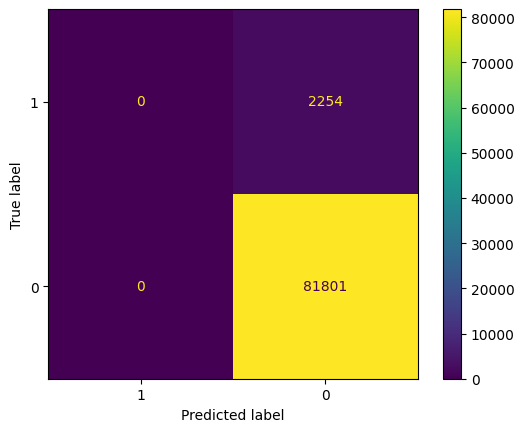

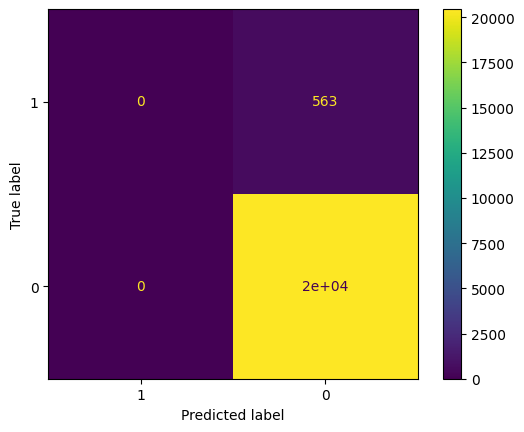

In [ ]:
accuracy_base_train = accuracy_score(y_train, base_train)
print("Accuracy of Baseline Model: ", accuracy_base_train)

precision_base_train = precision_score(y_train, base_train, labels=[1, 0])
print("Preicison of Baseline Model: ", precision_base_train)

recall_base_train = recall_score(y_train, base_train, labels=[1, 0])
print("Recall of Baseline Model: ", recall_base_train)

f1_base_train = f1_score(y_train, base_train, labels=[1, 0])
print("F1 Score of Baseline Model: ", f1_base_train)

cm_base_train = confusion_matrix(y_train, base_train, labels=[1, 0])
print(cm_base_train)

print("")

accuracy_base_val = accuracy_score(y_val, base_val)
print("Accuracy of Baseline Model: ", accuracy_base_val)

precision_base_val = precision_score(y_val, base_val, labels=[1, 0])
print("Precision of Baseline Model: ", precision_base_val)

recall_base_val = recall_score(y_val, base_val, labels=[1, 0])
print("Recall of Baseline Model: ", recall_base_val)

f1_base_val = f1_score(y_val, base_val, labels=[1, 0])
print("F1 Score of Baseline Model: ", f1_base_val)

cm_base_val = confusion_matrix(y_val, base_val, labels=[1, 0])
print(cm_base_val)

accuracy_base_loss = accuracy_base_train - accuracy_base_val
precision_base_loss = precision_base_train - precision_base_val
recall_base_loss = recall_base_train - recall_base_val
f1_base_loss = f1_base_train - f1_base_val

model_names_list.append("Baseline")
number_of_estimators_list.append(None)
max_depth_list.append(None)
avg_depth_list.append(None)
min_samples_leaf_list.append(None)
max_features_list.append(None)
training_accuracy_list.append(accuracy_base_train)
training_precision_list.append(precision_base_train)
training_recall_list.append(recall_base_train)
training_f1_list.append(f1_base_train)
validation_accuracy_list.append(accuracy_base_val)
validation_precision_list.append(precision_base_val)
validation_recall_list.append(recall_base_val)
validation_f1_list.append(f1_base_val)
accuracy_losses_list.append(accuracy_base_loss)
precision_losses_list.append(precision_base_loss)
recall_losses_list.append(recall_base_loss)
f1_losses_list.append(f1_base_loss)

ConfusionMatrixDisplay.from_predictions(y_train, base_train, labels=[1, 0])
ConfusionMatrixDisplay.from_predictions(y_val, base_val, labels=[1, 0])

These 2254 False Negatives represent the range for improving performance of models.

Recall and F1 scores will be more reliable measures for this problem

In [ ]:
y_train.value_counts()

0    81801
1     2254
Name: Target, dtype: int64

### 8. Train Machine Learning Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier

Training Accuracy for rf:  0.9999762060555588
Training Precision for rf:  1.0
Training Recall for rf:  0.9991126885536823
Training F1 Score for rf:  0.9995561473590767
Training F2 Score for rf:  0.9992900248491302
Training F3 Score for rf:  0.9992013488330819

Validation Accuracy for rf:  0.991243932616351
Validation Precision for rf:  0.9633251833740831
Validation Recall for rf:  0.6998223801065719
Validation F1 Score for rf:  0.8106995884773662
Validation F2 Score for rf:  0.7403231867718902
Validation F3 Score for rf:  0.7403231867718902

Accuracy Generalization Loss for rf:  0.008732273439207794
Precision Generalization Loss for rf:  0.03667481662591687
Recall Generalization Loss for rf:  0.29929030844711035
F1 Generalization Loss for rf:  0.1888565588817105
F2 Generalization Loss for rf:  0.25896683807723997
F3 Generalization Loss for rf:  0.25887816206119163



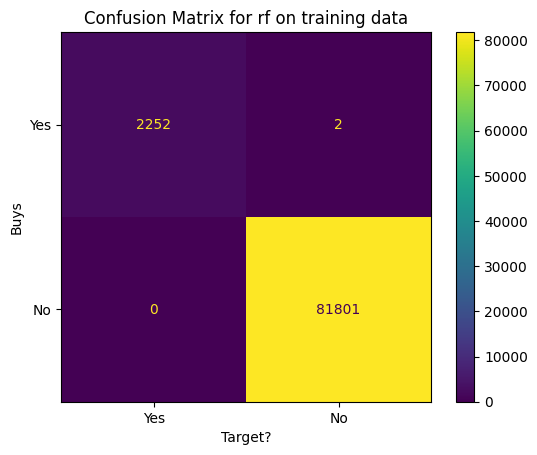

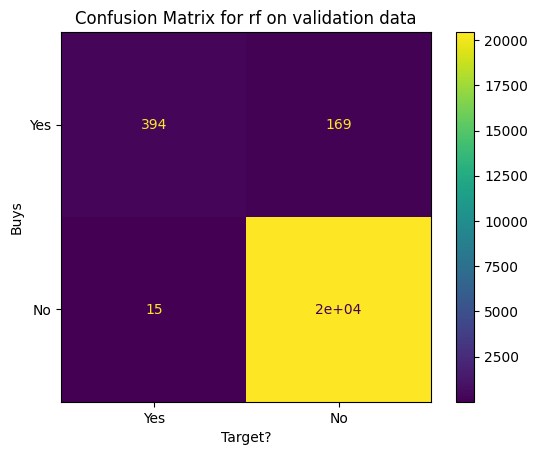

In [ ]:
rf = plant_forest("rf")

- 176 1s predicted as 0s
- 22 0s predicted as 1s

rf1: n_estimators=50

Training Accuracy for rf1:  0.9999762060555588
Training Precision for rf1:  1.0
Training Recall for rf1:  0.9991126885536823
Training F1 Score for rf1:  0.9995561473590767
Training F2 Score for rf1:  0.9992900248491302
Training F3 Score for rf1:  0.9992013488330819

Validation Accuracy for rf1:  0.990815646711716
Validation Precision for rf1:  0.9625
Validation Recall for rf1:  0.6838365896980462
Validation F1 Score for rf1:  0.7995846313603323
Validation F2 Score for rf1:  0.7258672699849171
Validation F3 Score for rf1:  0.7258672699849171

Accuracy Generalization Loss for rf1:  0.009160559343842856
Precision Generalization Loss for rf1:  0.03749999999999998
Recall Generalization Loss for rf1:  0.3152760988556361
F1 Generalization Loss for rf1:  0.1999715159987444
F2 Generalization Loss for rf1:  0.2734227548642131
F3 Generalization Loss for rf1:  0.27333407884816474



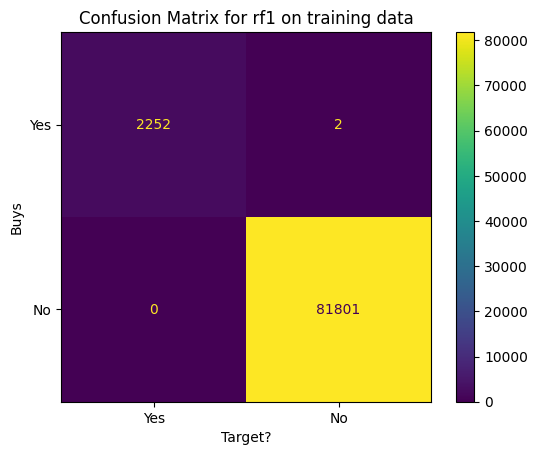

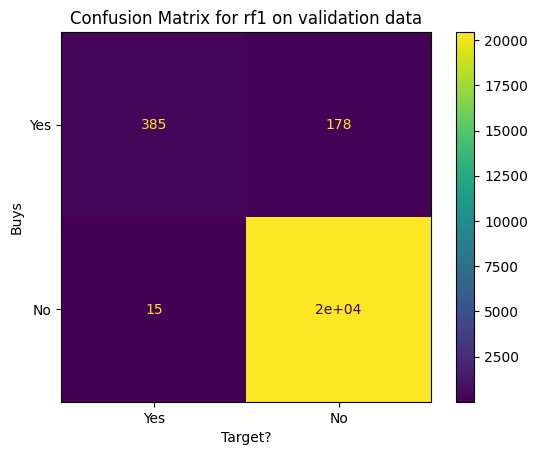

In [ ]:
rf1 = plant_forest("rf1", n_estimators=50)

NB: include a column for total false predictions

rf2 (n_estimators=25)

Training Accuracy for rf2:  0.9998810302777943
Training Precision for rf2:  1.0
Training Recall for rf2:  0.9955634427684117
Training F1 Score for rf2:  0.9977767896843042
Training F2 Score for rf2:  0.9964476021314387
Training F3 Score for rf2:  0.9960053262316911

Validation Accuracy for rf2:  0.9909584086799277
Validation Precision for rf2:  0.9559902200488998
Validation Recall for rf2:  0.69449378330373
Validation F1 Score for rf2:  0.8045267489711934
Validation F2 Score for rf2:  0.7346862081924087
Validation F3 Score for rf2:  0.7346862081924087

Accuracy Generalization Loss for rf2:  0.008922621597866609
Precision Generalization Loss for rf2:  0.044009779951100225
Recall Generalization Loss for rf2:  0.30106965946468167
F1 Generalization Loss for rf2:  0.1932500407131108
F2 Generalization Loss for rf2:  0.26176139393903
F3 Generalization Loss for rf2:  0.2613191180392824



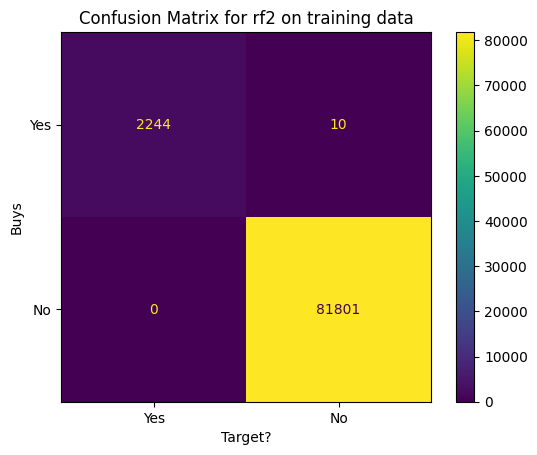

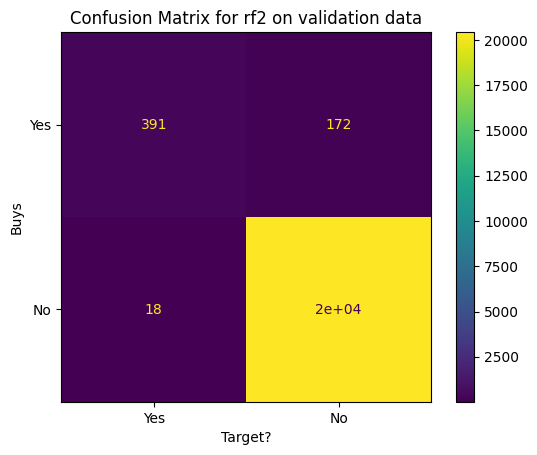

In [ ]:
rf2 = plant_forest("rf2", n_estimators=25)

let's see how high to push up n_estimators to eliminate all errors

RF3 (n_estimators=200)

Training Accuracy for rf3:  0.9999762060555588
Training Precision for rf3:  1.0
Training Recall for rf3:  0.9991126885536823
Training F1 Score for rf3:  0.9995561473590767
Training F2 Score for rf3:  0.9992900248491302
Training F3 Score for rf3:  0.9992013488330819

Validation Accuracy for rf3:  0.9909108213571904
Validation Precision for rf3:  0.9514563106796117
Validation Recall for rf3:  0.6962699822380106
Validation F1 Score for rf3:  0.8041025641025641
Validation F2 Score for rf3:  0.7357357357357357
Validation F3 Score for rf3:  0.7357357357357357

Accuracy Generalization Loss for rf3:  0.009065384698368373
Precision Generalization Loss for rf3:  0.04854368932038833
Recall Generalization Loss for rf3:  0.3028427063156717
F1 Generalization Loss for rf3:  0.19545358325651263
F2 Generalization Loss for rf3:  0.2635542891133945
F3 Generalization Loss for rf3:  0.2634656130973462



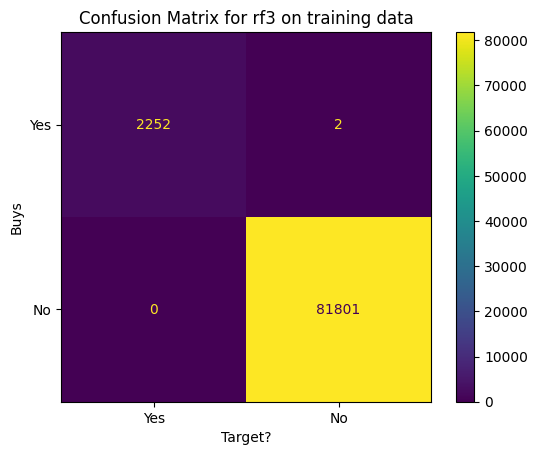

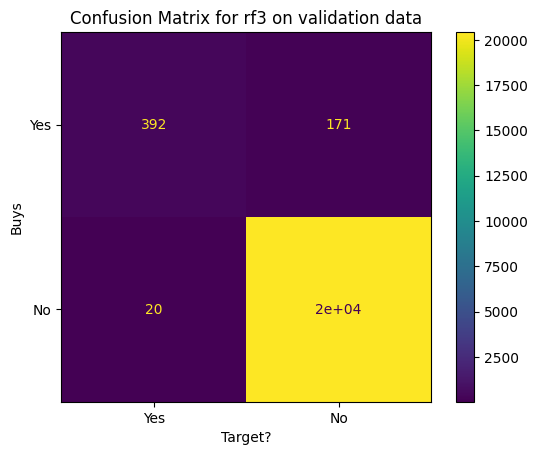

In [ ]:
rf3 = plant_forest("rf3", n_estimators=200)

In [ ]:
import math

n_features = len(X_train.columns)
print("Number of features: ", n_features)
sqrt = math.sqrt(n_features)
print("sqrt: ", sqrt)
log2 = math.log(n_features, 2)
print("Log2 of features", log2)

Number of features:  34
sqrt:  5.830951894845301
Log2 of features 5.08746284125034


RF4 (max_features=None)


Training Accuracy for rf4:  0.9999762060555588
Training Precision for rf4:  1.0
Training Recall for rf4:  0.9991126885536823
Training F1 Score for rf4:  0.9995561473590767
Training F2 Score for rf4:  0.9992900248491302
Training F3 Score for rf4:  0.9992013488330819

Validation Accuracy for rf4:  0.9927667269439421
Validation Precision for rf4:  0.9290187891440501
Validation Recall for rf4:  0.7904085257548845
Validation F1 Score for rf4:  0.8541266794625719
Validation F2 Score for rf4:  0.8147198828268034
Validation F3 Score for rf4:  0.8147198828268034

Accuracy Generalization Loss for rf4:  0.0072094791116167345
Precision Generalization Loss for rf4:  0.07098121085594988
Recall Generalization Loss for rf4:  0.20870416279879778
F1 Generalization Loss for rf4:  0.1454294678965048
F2 Generalization Loss for rf4:  0.1845701420223268
F3 Generalization Loss for rf4:  0.18448146600627846



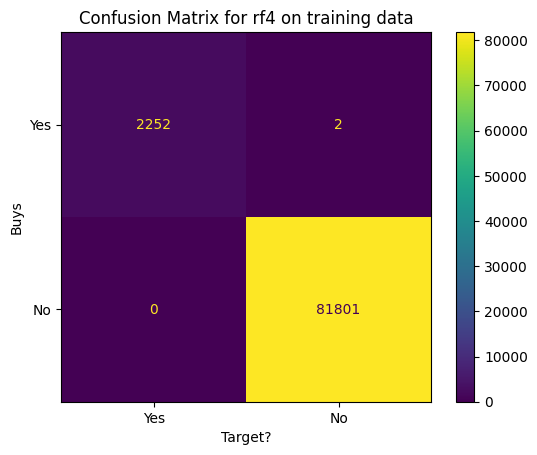

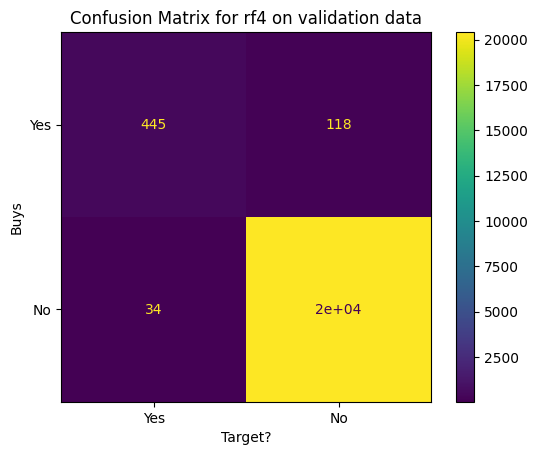

In [ ]:
rf4 = plant_forest("rf4", max_features=None)

rf5 (n_estimators=500)

Training Accuracy for rf5:  0.9999762060555588
Training Precision for rf5:  1.0
Training Recall for rf5:  0.9991126885536823
Training F1 Score for rf5:  0.9995561473590767
Training F2 Score for rf5:  0.9992900248491302
Training F3 Score for rf5:  0.9992013488330819

Validation Accuracy for rf5:  0.9910059960026649
Validation Precision for rf5:  0.9495192307692307
Validation Recall for rf5:  0.7015985790408525
Validation F1 Score for rf5:  0.8069458631256384
Validation F2 Score for rf5:  0.740254872563718
Validation F3 Score for rf5:  0.740254872563718

Accuracy Generalization Loss for rf5:  0.00897021005289389
Precision Generalization Loss for rf5:  0.050480769230769273
Recall Generalization Loss for rf5:  0.29751410951282975
F1 Generalization Loss for rf5:  0.1926102842334383
F2 Generalization Loss for rf5:  0.2590351522854122
F3 Generalization Loss for rf5:  0.25894647626936385



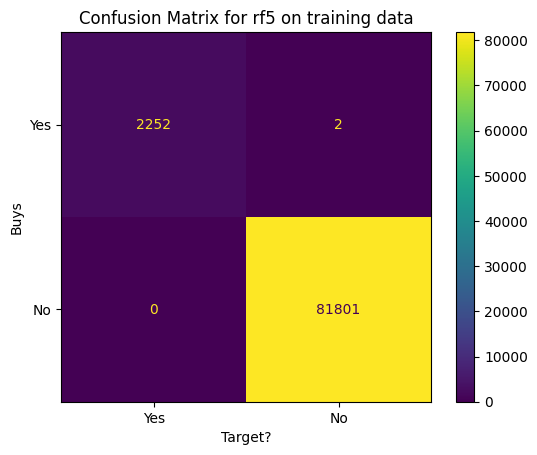

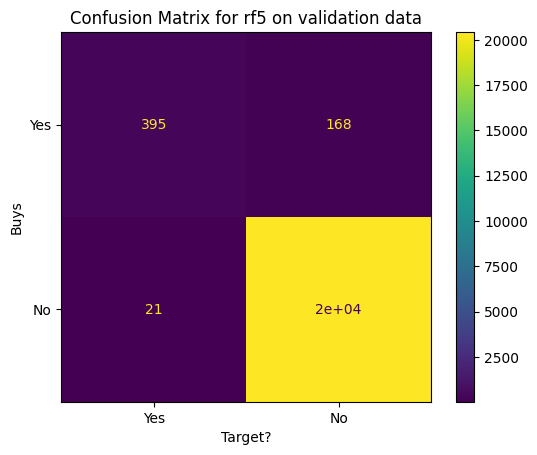

In [ ]:
rf5 = plant_forest("rf5", n_estimators=500)

rf6 (n_estimators=1000)

Training Accuracy for rf6:  0.9999762060555588
Training Precision for rf6:  1.0
Training Recall for rf6:  0.9991126885536823
Training F1 Score for rf6:  0.9995561473590767
Training F2 Score for rf6:  0.9992900248491302
Training F3 Score for rf6:  0.9992013488330819

Validation Accuracy for rf6:  0.9911487579708765
Validation Precision for rf6:  0.9542168674698795
Validation Recall for rf6:  0.7033747779751333
Validation F1 Score for rf6:  0.8098159509202454
Validation F2 Score for rf6:  0.7424071991001125
Validation F3 Score for rf6:  0.7424071991001125

Accuracy Generalization Loss for rf6:  0.008827448084682277
Precision Generalization Loss for rf6:  0.04578313253012045
Recall Generalization Loss for rf6:  0.29573791057854903
F1 Generalization Loss for rf6:  0.18974019643883133
F2 Generalization Loss for rf6:  0.25688282574901766
F3 Generalization Loss for rf6:  0.2567941497329693



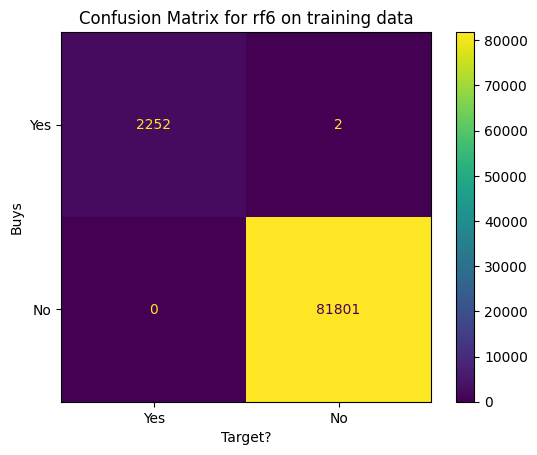

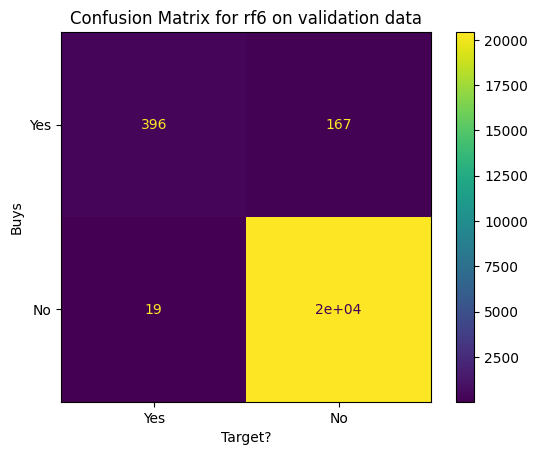

In [ ]:
rf6 = plant_forest("rf6", n_estimators=1000)

rf7 (n_estimators=10)

Training Accuracy for rf7:  0.9990244482779133
Training Precision for rf7:  0.9990808823529411
Training Recall for rf7:  0.9645075421472937
Training F1 Score for rf7:  0.981489841986456
Training F2 Score for rf7:  0.9712294496068621
Training F3 Score for rf7:  0.9678568248597631

Validation Accuracy for rf7:  0.9892928523841249
Validation Precision for rf7:  0.9447368421052632
Validation Recall for rf7:  0.6376554174067496
Validation F1 Score for rf7:  0.7613997879109226
Validation F2 Score for rf7:  0.6819908814589667
Validation F3 Score for rf7:  0.6819908814589667

Accuracy Generalization Loss for rf7:  0.009731595893788358
Precision Generalization Loss for rf7:  0.054344040247677916
Recall Generalization Loss for rf7:  0.32685212474054415
F1 Generalization Loss for rf7:  0.2200900540755334
F2 Generalization Loss for rf7:  0.2892385681478954
F3 Generalization Loss for rf7:  0.2858659434007964



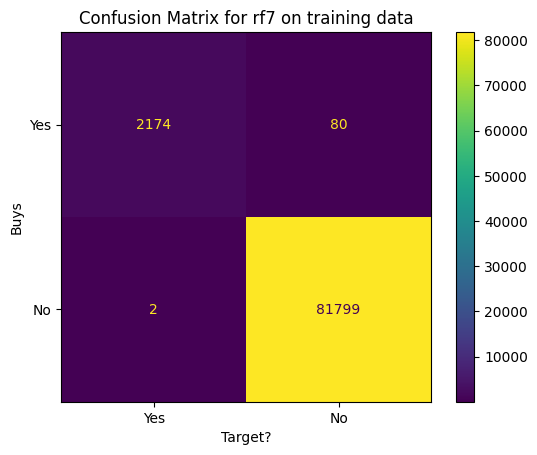

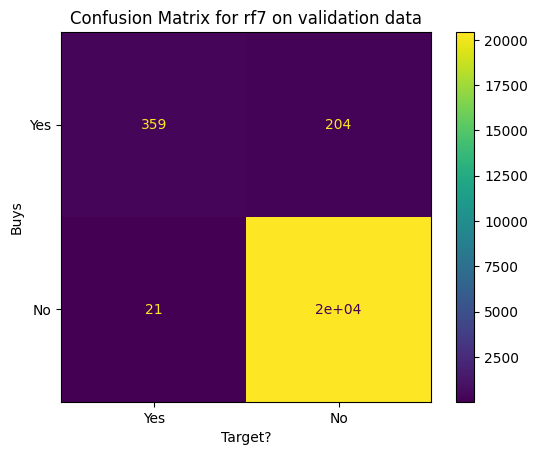

In [ ]:
rf7 = plant_forest("rf7", n_estimators=10)

Tuning max_features

Training Accuracy for rf8:  0.9999762060555588
Training Precision for rf8:  1.0
Training Recall for rf8:  0.9991126885536823
Training F1 Score for rf8:  0.9995561473590767
Training F2 Score for rf8:  0.9992900248491302
Training F3 Score for rf8:  0.9992013488330819

Validation Accuracy for rf8:  0.9869134862472637
Validation Precision for rf8:  0.9528301886792453
Validation Recall for rf8:  0.5381882770870338
Validation F1 Score for rf8:  0.6878547105561862
Validation F2 Score for rf8:  0.5894941634241246
Validation F3 Score for rf8:  0.5894941634241246

Accuracy Generalization Loss for rf8:  0.013062719808295098
Precision Generalization Loss for rf8:  0.047169811320754707
Recall Generalization Loss for rf8:  0.46092441146664853
F1 Generalization Loss for rf8:  0.31170143680289053
F2 Generalization Loss for rf8:  0.40979586142500557
F3 Generalization Loss for rf8:  0.40970718540895723



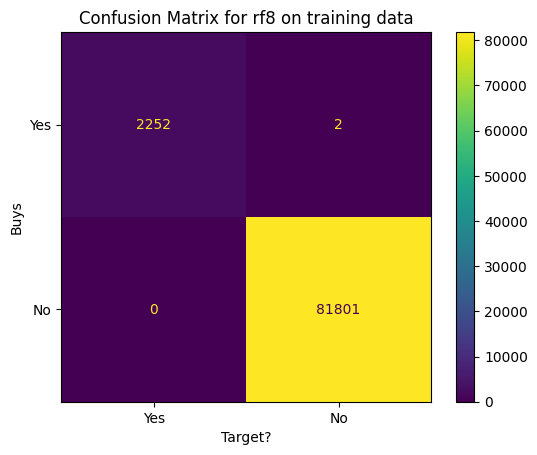

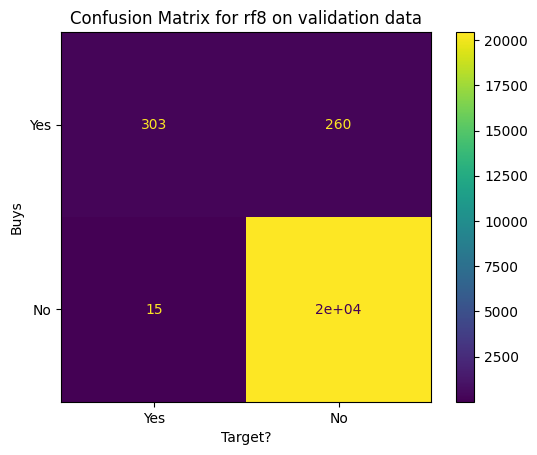

In [ ]:
rf8 = plant_forest("rf8", n_estimators=1000, max_features=2)

Now trying an increase in max_features over default

Training Accuracy for rf9:  0.9999762060555588
Training Precision for rf9:  1.0
Training Recall for rf9:  0.9991126885536823
Training F1 Score for rf9:  0.9995561473590767
Training F2 Score for rf9:  0.9992900248491302
Training F3 Score for rf9:  0.9992013488330819

Validation Accuracy for rf9:  0.9928143142666793
Validation Precision for rf9:  0.9478260869565217
Validation Recall for rf9:  0.7744227353463587
Validation F1 Score for rf9:  0.852394916911046
Validation F2 Score for rf9:  0.803834808259587
Validation F3 Score for rf9:  0.803834808259587

Accuracy Generalization Loss for rf9:  0.007161891788879493
Precision Generalization Loss for rf9:  0.05217391304347829
Recall Generalization Loss for rf9:  0.22468995320732355
F1 Generalization Loss for rf9:  0.14716123044803076
F2 Generalization Loss for rf9:  0.19545521658954323
F3 Generalization Loss for rf9:  0.1953665405734949



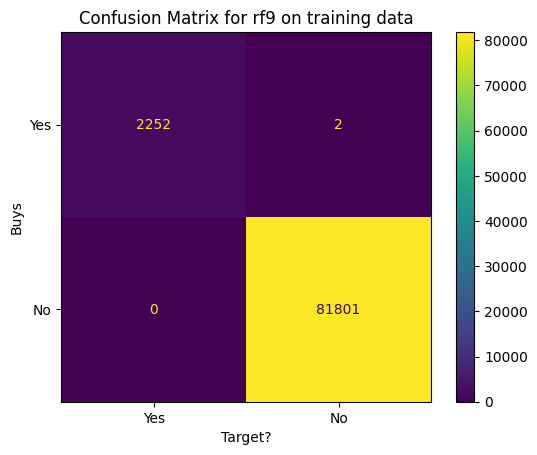

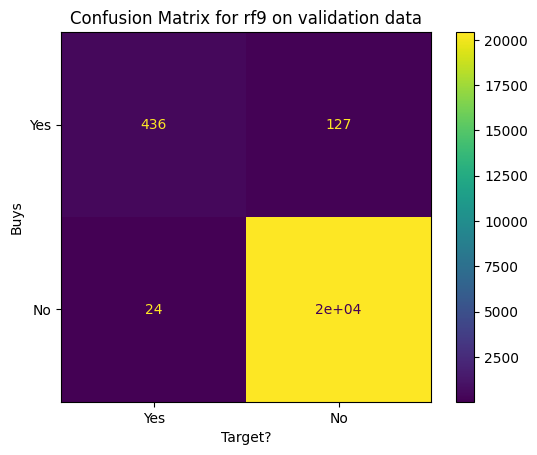

In [ ]:
rf9 = plant_forest("rf9", n_estimators=500, max_features=10)

Tuning max_depth

Training Accuracy for rf10:  0.9884718339182678
Training Precision for rf10:  0.9938508839354343
Training Recall for rf10:  0.5736468500443656
Training F1 Score for rf10:  0.7274261603375526
Training F2 Score for rf10:  0.6266356498982262
Training F3 Score for rf10:  0.5989716032797517

Validation Accuracy for rf10:  0.9857713905015704
Validation Precision for rf10:  0.9680851063829787
Validation Recall for rf10:  0.4849023090586146
Validation F1 Score for rf10:  0.6461538461538461
Validation F2 Score for rf10:  0.5386740331491714
Validation F3 Score for rf10:  0.5386740331491714

Accuracy Generalization Loss for rf10:  0.0027004434166973956
Precision Generalization Loss for rf10:  0.02576577755245557
Recall Generalization Loss for rf10:  0.08874454098575096
F1 Generalization Loss for rf10:  0.0812723141837065
F2 Generalization Loss for rf10:  0.08796161674905478
F3 Generalization Loss for rf10:  0.06029757013058035



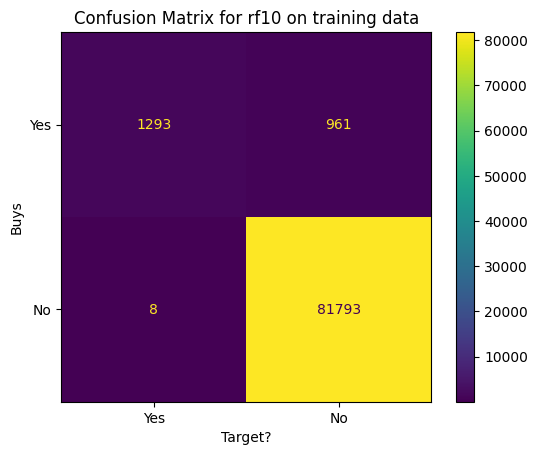

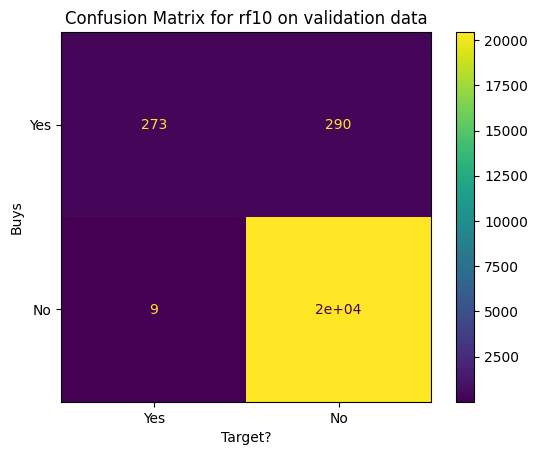

In [ ]:
rf10 = plant_forest("rf10", n_estimators=500, max_depth=10)

tuning min_samples_leaf

Training Accuracy for rf11:  0.9964784962227113
Training Precision for rf11:  0.9979654120040692
Training Recall for rf11:  0.870452528837622
Training F1 Score for rf11:  0.9298578199052132
Training F2 Score for rf11:  0.8932799125842287
Training F3 Score for rf11:  0.8817184972137334

Validation Accuracy for rf11:  0.9900542495479204
Validation Precision for rf11:  0.946969696969697
Validation Recall for rf11:  0.6660746003552398
Validation F1 Score for rf11:  0.7820646506777894
Validation F2 Score for rf11:  0.7080815709969788
Validation F3 Score for rf11:  0.7080815709969788

Accuracy Generalization Loss for rf11:  0.006424246674790912
Precision Generalization Loss for rf11:  0.05099571503437217
Recall Generalization Loss for rf11:  0.20437792848238223
F1 Generalization Loss for rf11:  0.1477931692274238
F2 Generalization Loss for rf11:  0.1851983415872499
F3 Generalization Loss for rf11:  0.17363692621675464



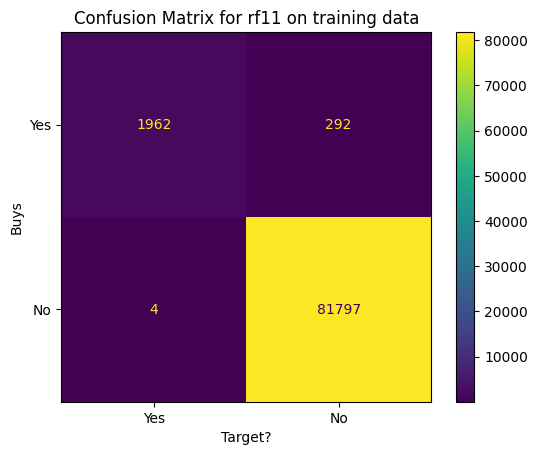

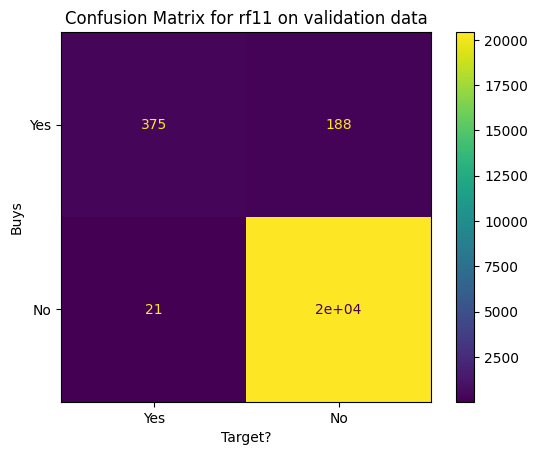

In [ ]:
rf11 = plant_forest("rf11", n_estimators=250, min_samples_leaf=2)

RF12: trying n_estimators=2500

Training Accuracy for rf12:  0.9999762060555588
Training Precision for rf12:  1.0
Training Recall for rf12:  0.9991126885536823
Training F1 Score for rf12:  0.9995561473590767
Training F2 Score for rf12:  0.9992900248491302
Training F3 Score for rf12:  0.9992013488330819

Validation Accuracy for rf12:  0.9910535833254022
Validation Precision for rf12:  0.9539951573849879
Validation Recall for rf12:  0.6998223801065719
Validation F1 Score for rf12:  0.8073770491803278
Validation F2 Score for rf12:  0.7392120075046903
Validation F3 Score for rf12:  0.7392120075046903

Accuracy Generalization Loss for rf12:  0.008922622730156649
Precision Generalization Loss for rf12:  0.04600484261501214
Recall Generalization Loss for rf12:  0.29929030844711035
F1 Generalization Loss for rf12:  0.1921790981787489
F2 Generalization Loss for rf12:  0.2600780173444399
F3 Generalization Loss for rf12:  0.2599893413283916



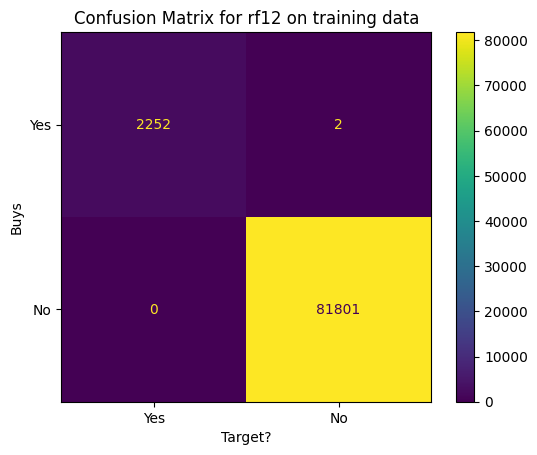

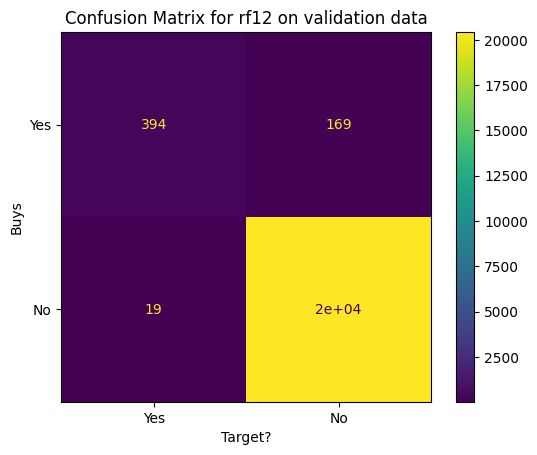

In [ ]:
rf12 = plant_forest("rf12", n_estimators=2500)

RF13: n_estimators=50, no max depth, no max features, mss=1

Training Accuracy for rf13:  0.9999524121111177
Training Precision for rf13:  1.0
Training Recall for rf13:  0.9982253771073647
Training F1 Score for rf13:  0.9991119005328597
Training F2 Score for rf13:  0.9985797976211611
Training F3 Score for rf13:  0.9984025559105432

Validation Accuracy for rf13:  0.9926715522984677
Validation Precision for rf13:  0.9251559251559252
Validation Recall for rf13:  0.7904085257548845
Validation F1 Score for rf13:  0.8524904214559387
Validation F2 Score for rf13:  0.8141236736187341
Validation F3 Score for rf13:  0.8141236736187341

Accuracy Generalization Loss for rf13:  0.007280859812650031
Precision Generalization Loss for rf13:  0.07484407484407485
Recall Generalization Loss for rf13:  0.20781685135248018
F1 Generalization Loss for rf13:  0.14662147907692102
F2 Generalization Loss for rf13:  0.18445612400242706
F3 Generalization Loss for rf13:  0.1842788822918091



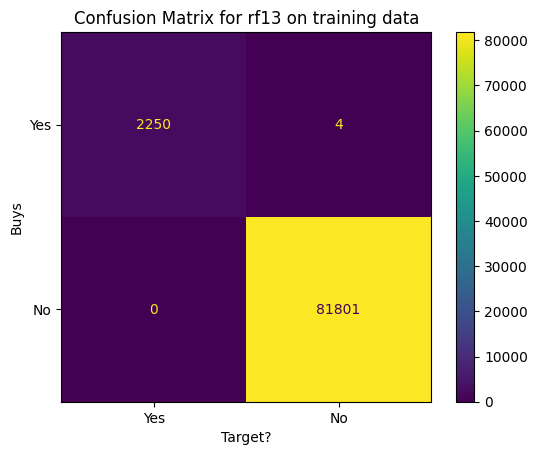

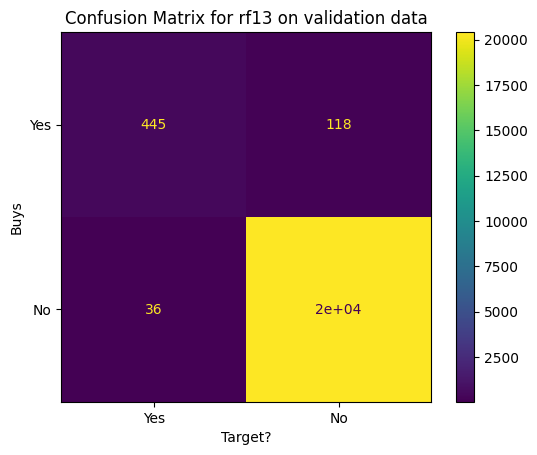

In [ ]:
rf13 = plant_forest("rf13", n_estimators=50, max_depth=None, min_samples_leaf=1, max_features=None)

RF14 takes n_estimators=250, max_depth=None, mss=1, mf=None

Training Accuracy for rf14:  0.9999762060555588
Training Precision for rf14:  1.0
Training Recall for rf14:  0.9991126885536823
Training F1 Score for rf14:  0.9995561473590767
Training F2 Score for rf14:  0.9992900248491302
Training F3 Score for rf14:  0.9992013488330819

Validation Accuracy for rf14:  0.9927667269439421
Validation Precision for rf14:  0.9272349272349273
Validation Recall for rf14:  0.7921847246891652
Validation F1 Score for rf14:  0.8544061302681993
Validation F2 Score for rf14:  0.8159531650201244
Validation F3 Score for rf14:  0.8159531650201244

Accuracy Generalization Loss for rf14:  0.0072094791116167345
Precision Generalization Loss for rf14:  0.07276507276507271
Recall Generalization Loss for rf14:  0.20692796386451706
F1 Generalization Loss for rf14:  0.14515001709087738
F2 Generalization Loss for rf14:  0.18333685982900583
F3 Generalization Loss for rf14:  0.1832481838129575



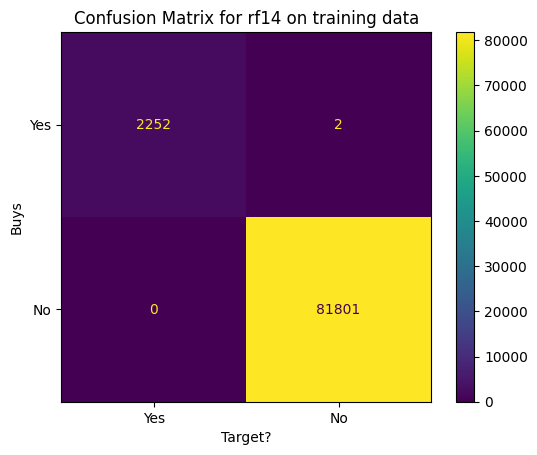

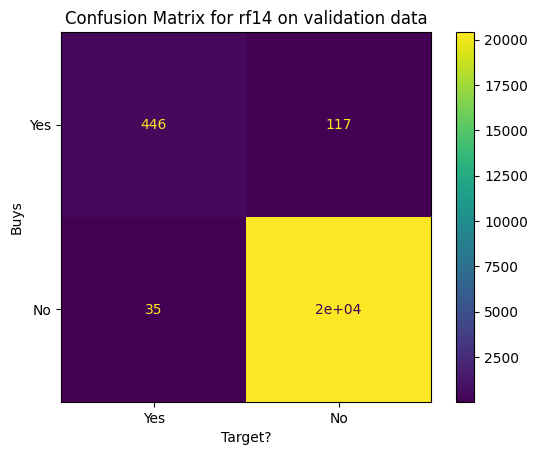

In [ ]:
rf14 = plant_forest("rf14", n_estimators=250, max_depth=None, min_samples_leaf=1, max_features=None)

Note: we get 1 fewer FN when tuning estimators from 100 to 250.

Training Accuracy for rf15:  0.9999762060555588
Training Precision for rf15:  1.0
Training Recall for rf15:  0.9991126885536823
Training F1 Score for rf15:  0.9995561473590767
Training F2 Score for rf15:  0.9992900248491302
Training F3 Score for rf15:  0.9992013488330819

Validation Accuracy for rf15:  0.9929094889121538
Validation Precision for rf15:  0.93125
Validation Recall for rf15:  0.7939609236234458
Validation F1 Score for rf15:  0.8571428571428571
Validation F2 Score for rf15:  0.818081991215227
Validation F3 Score for rf15:  0.818081991215227

Accuracy Generalization Loss for rf15:  0.00706671714340501
Precision Generalization Loss for rf15:  0.06874999999999998
Recall Generalization Loss for rf15:  0.20515176493023646
F1 Generalization Loss for rf15:  0.14241329021621962
F2 Generalization Loss for rf15:  0.18120803363390325
F3 Generalization Loss for rf15:  0.18111935761785491



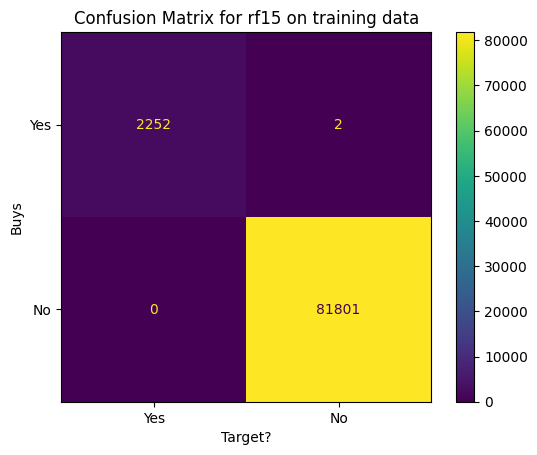

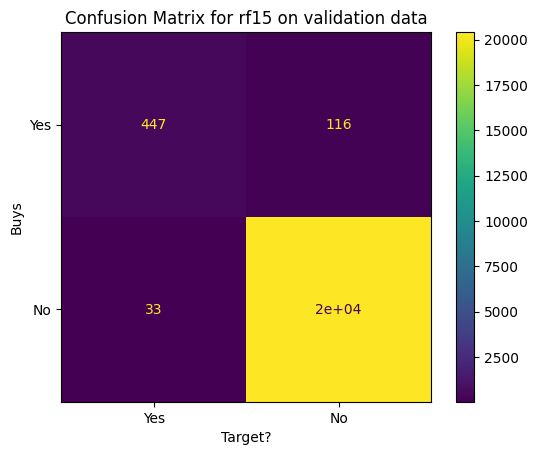

In [ ]:
rf15 = plant_forest("rf15", n_estimators=500, max_features=None)

Note: by doubling n_estimators, we get one fewer FN. Perhaps we should see how high we can tune this HP until we stop shedding FNs.

Training Accuracy for rf16:  0.9999762060555588
Training Precision for rf16:  1.0
Training Recall for rf16:  0.9991126885536823
Training F1 Score for rf16:  0.9995561473590767
Training F2 Score for rf16:  0.9992900248491302
Training F3 Score for rf16:  0.9992013488330819

Validation Accuracy for rf16:  0.9928619015894166
Validation Precision for rf16:  0.927536231884058
Validation Recall for rf16:  0.7957371225577264
Validation F1 Score for rf16:  0.8565965583173996
Validation F2 Score for rf16:  0.8190127970749543
Validation F3 Score for rf16:  0.8190127970749543

Accuracy Generalization Loss for rf16:  0.007114304466142252
Precision Generalization Loss for rf16:  0.07246376811594202
Recall Generalization Loss for rf16:  0.20337556599595585
F1 Generalization Loss for rf16:  0.14295958904167716
F2 Generalization Loss for rf16:  0.18027722777417587
F3 Generalization Loss for rf16:  0.18018855175812754



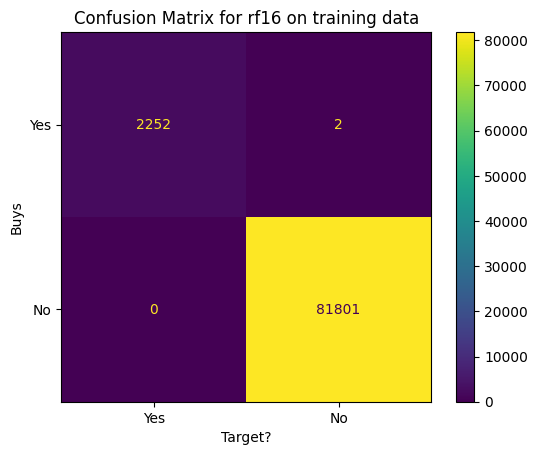

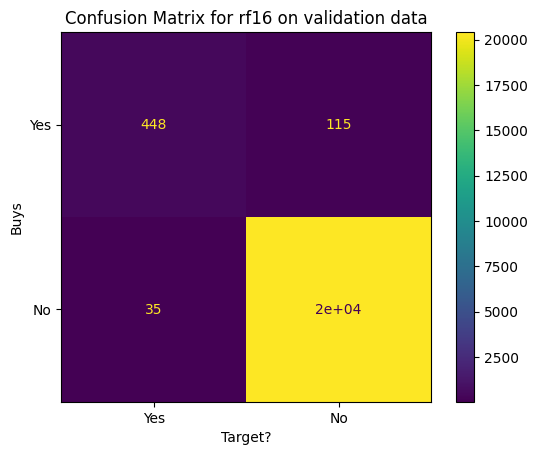

In [ ]:
rf16 = plant_forest("rf16", n_estimators=1000, max_features=None)

again, by doubling n_estimators we can remove one FN

RF16A: assessing n_estimators between 1000 and 500

Training Accuracy for rf16a:  0.9999762060555588
Training Precision for rf16a:  1.0
Training Recall for rf16a:  0.9991126885536823
Training F1 Score for rf16a:  0.9995561473590767
Training F2 Score for rf16a:  0.9992900248491302
Training F3 Score for rf16a:  0.9992013488330819

Validation Accuracy for rf16a:  0.9928619015894166
Validation Precision for rf16a:  0.9293139293139293
Validation Recall for rf16a:  0.7939609236234458
Validation F1 Score for rf16a:  0.8563218390804597
Validation F2 Score for rf16a:  0.8177826564215147
Validation F3 Score for rf16a:  0.8177826564215147

Accuracy Generalization Loss for rf16a:  0.007114304466142252
Precision Generalization Loss for rf16a:  0.07068607068607069
Recall Generalization Loss for rf16a:  0.20515176493023646
F1 Generalization Loss for rf16a:  0.14323430827861705
F2 Generalization Loss for rf16a:  0.1815073684276155
F3 Generalization Loss for rf16a:  0.18141869241156716



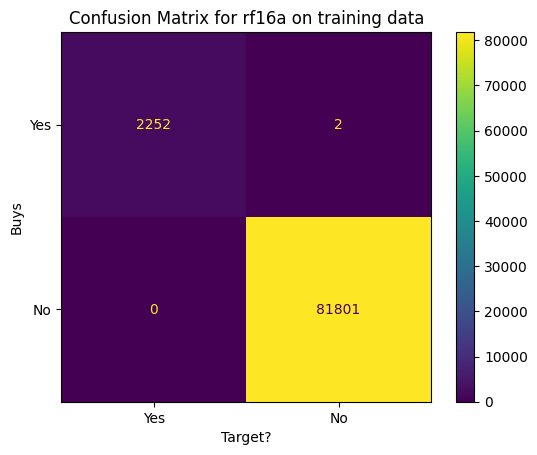

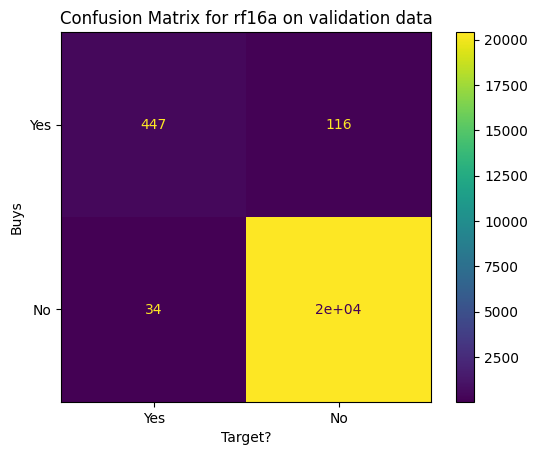

In [ ]:
rf16a = plant_forest("rf16a", n_estimators=750, max_features=None)

no difference in FNs between 1000 estimators and 2500 estimators.

now looking to see if doubling min_samples_leaf will improve performance

Training Accuracy for rf18:  0.9980964844447088
Training Precision for rf18:  0.9976235741444867
Training Recall for rf18:  0.9312333629103815
Training F1 Score for rf18:  0.963285910968334
Training F2 Score for rf18:  0.943794964028777
Training F3 Score for rf18:  0.9374720857525681

Validation Accuracy for rf18:  0.9925763776529932
Validation Precision for rf18:  0.9302325581395349
Validation Recall for rf18:  0.7815275310834814
Validation F1 Score for rf18:  0.8494208494208494
Validation F2 Score for rf18:  0.8073394495412846
Validation F3 Score for rf18:  0.8073394495412846

Accuracy Generalization Loss for rf18:  0.005520106791715551
Precision Generalization Loss for rf18:  0.06739101600495179
Recall Generalization Loss for rf18:  0.14970583182690012
F1 Generalization Loss for rf18:  0.11386506154748466
F2 Generalization Loss for rf18:  0.1364555144874925
F3 Generalization Loss for rf18:  0.13013263621128357



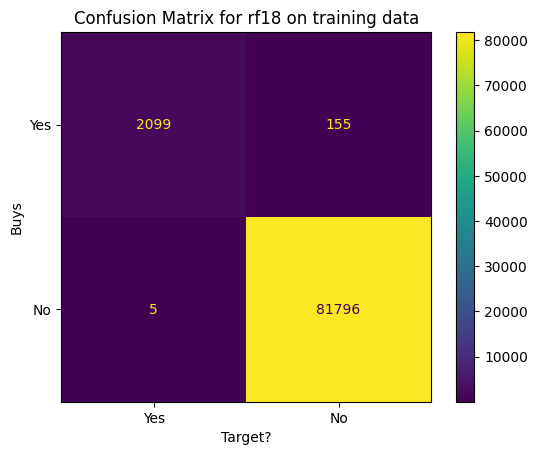

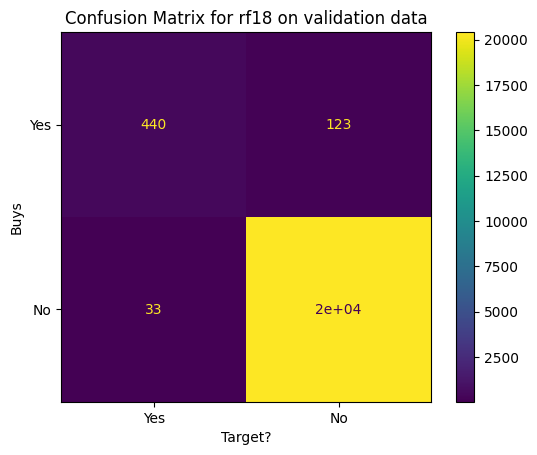

In [ ]:
rf18 = plant_forest("rf18", n_estimators=1000, max_depth=None, min_samples_leaf=2, max_features=None)

seeing if it makes sense to limit max_depth to 15

Training Accuracy for rf19:  0.9986913330557373
Training Precision for rf19:  1.0
Training Recall for rf19:  0.9511978704525288
Training F1 Score for rf19:  0.9749886311959982
Training F2 Score for rf19:  0.9605734767025089
Training F3 Score for rf19:  0.9558626839054837

Validation Accuracy for rf19:  0.9929094889121538
Validation Precision for rf19:  0.9348739495798319
Validation Recall for rf19:  0.7904085257548845
Validation F1 Score for rf19:  0.8565928777670837
Validation F2 Score for rf19:  0.8156158357771262
Validation F3 Score for rf19:  0.8156158357771262

Accuracy Generalization Loss for rf19:  0.005781844143583514
Precision Generalization Loss for rf19:  0.06512605042016806
Recall Generalization Loss for rf19:  0.16078934469764428
F1 Generalization Loss for rf19:  0.11839575342891451
F2 Generalization Loss for rf19:  0.14495764092538277
F3 Generalization Loss for rf19:  0.14024684812835753



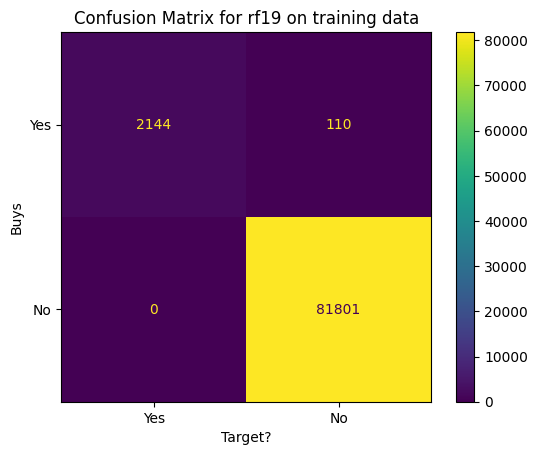

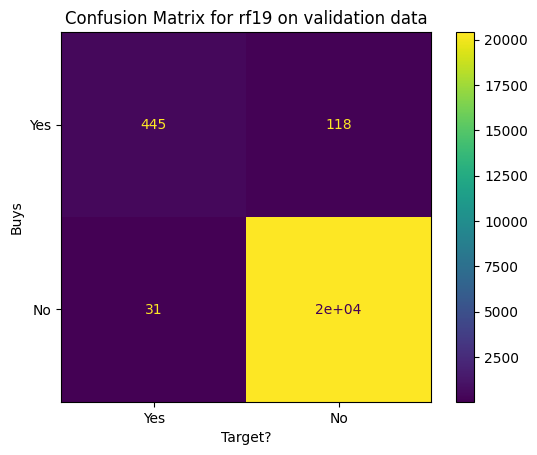

In [ ]:
rf19 = plant_forest("rf19", n_estimators=1000, max_depth=15, max_features=None)

RF20: Experimenting with balanced class_weight

Training Accuracy for rf20:  0.9999762060555588
Training Precision for rf20:  0.999113475177305
Training Recall for rf20:  1.0
Training F1 Score for rf20:  0.9995565410199556
Training F2 Score for rf20:  0.9998225691980128
Training F3 Score for rf20:  0.9999112767278857

Validation Accuracy for rf20:  0.9893404397068621
Validation Precision for rf20:  0.9544235924932976
Validation Recall for rf20:  0.6323268206039077
Validation F1 Score for rf20:  0.7606837606837608
Validation F2 Score for rf20:  0.6780952380952381
Validation F3 Score for rf20:  0.6780952380952381

Accuracy Generalization Loss for rf20:  0.010635766348696674
Precision Generalization Loss for rf20:  0.04468988268400742
Recall Generalization Loss for rf20:  0.36767317939609234
F1 Generalization Loss for rf20:  0.23887278033619486
F2 Generalization Loss for rf20:  0.32172733110277474
F3 Generalization Loss for rf20:  0.3218160386326476



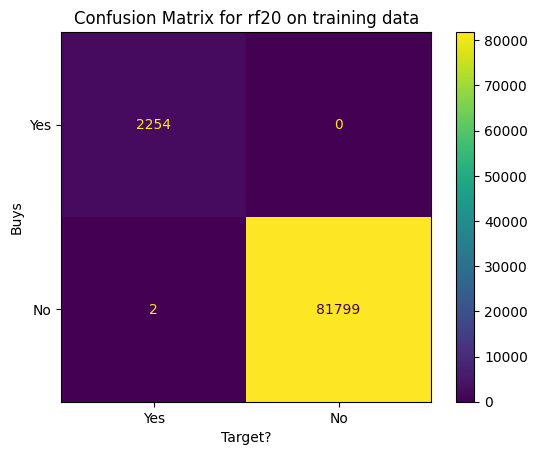

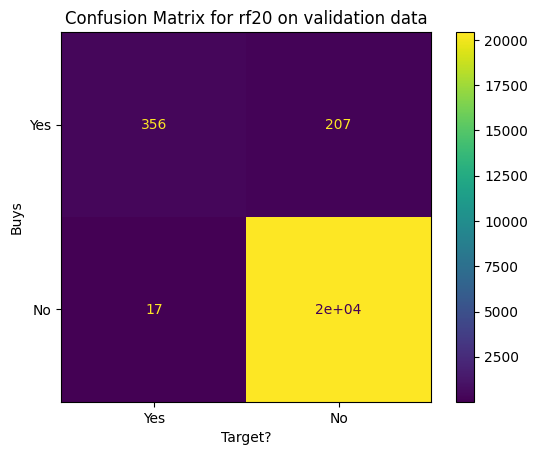

In [ ]:
rf20 = plant_forest("rf20", class_weight="balanced")

rf20, with balanced class weight, actually has more FNs at 207 than RF (default) and two more FPs at 17. Not sure what this parameter actually does. Noteworthy though (surely very noteworthy actually) that it makes 0 FNs on training, and 2 FPs. So maybe it is doing what we want, and other params need to be tuned.

RF20A: balanced class weight with more estimators and default max_features

Training Accuracy for rf20a:  0.9999762060555588
Training Precision for rf20a:  0.999113475177305
Training Recall for rf20a:  1.0
Training F1 Score for rf20a:  0.9995565410199556
Training F2 Score for rf20a:  0.9998225691980128
Training F3 Score for rf20a:  0.9999112767278857

Validation Accuracy for rf20a:  0.9897211382887598
Validation Precision for rf20a:  0.9577836411609498
Validation Recall for rf20a:  0.6447602131438721
Validation F1 Score for rf20a:  0.7707006369426751
Validation F2 Score for rf20a:  0.6898517673888256
Validation F3 Score for rf20a:  0.6898517673888256

Accuracy Generalization Loss for rf20a:  0.010255067766798964
Precision Generalization Loss for rf20a:  0.04132983401635515
Recall Generalization Loss for rf20a:  0.3552397868561279
F1 Generalization Loss for rf20a:  0.22885590407728051
F2 Generalization Loss for rf20a:  0.30997080180918724
F3 Generalization Loss for rf20a:  0.3100595093390601



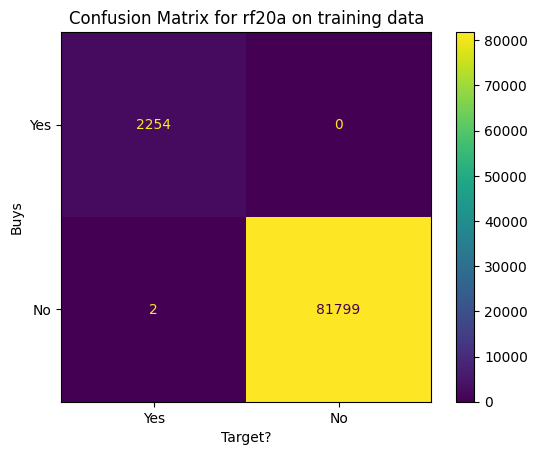

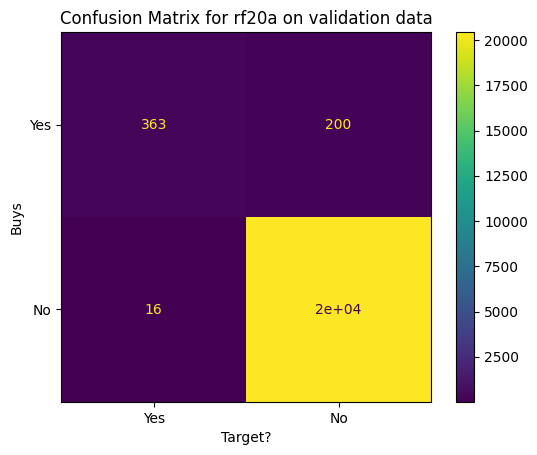

In [ ]:
rf20a = plant_forest("rf20a", n_estimators=250, class_weight="balanced")

Training Accuracy for rf20b:  0.9999762060555588
Training Precision for rf20b:  0.999113475177305
Training Recall for rf20b:  1.0
Training F1 Score for rf20b:  0.9995565410199556
Training F2 Score for rf20b:  0.9998225691980128
Training F3 Score for rf20b:  0.9999112767278857

Validation Accuracy for rf20b:  0.9899114875797088
Validation Precision for rf20b:  0.9534883720930233
Validation Recall for rf20b:  0.655417406749556
Validation F1 Score for rf20b:  0.7768421052631579
Validation F2 Score for rf20b:  0.6991284577491474
Validation F3 Score for rf20b:  0.6991284577491474

Accuracy Generalization Loss for rf20b:  0.010064718475849999
Precision Generalization Loss for rf20b:  0.04562510308428169
Recall Generalization Loss for rf20b:  0.34458259325044405
F1 Generalization Loss for rf20b:  0.22271443575679772
F2 Generalization Loss for rf20b:  0.3006941114488654
F3 Generalization Loss for rf20b:  0.30078281897873826



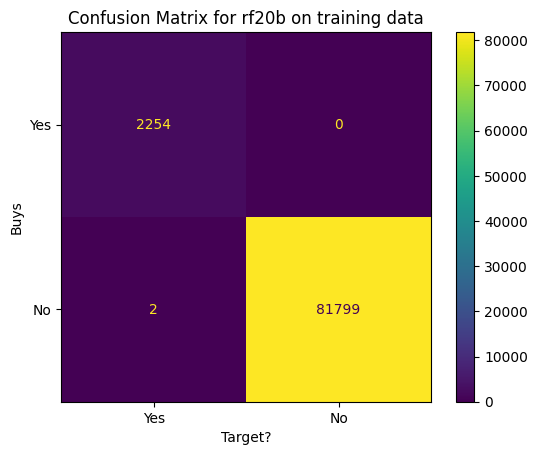

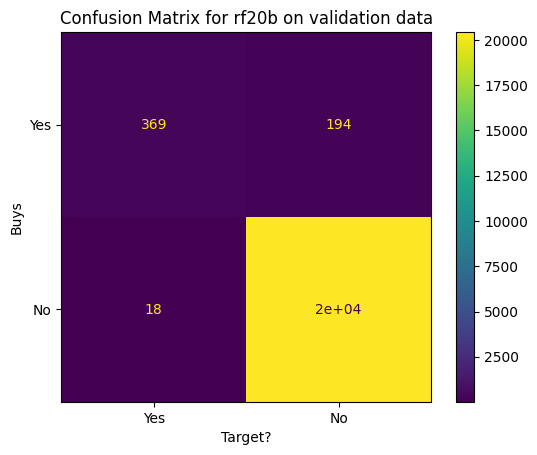

In [ ]:
rf20b = plant_forest("rf20b", n_estimators=500, class_weight='balanced')

Training Accuracy for rf20c:  0.9999762060555588
Training Precision for rf20c:  0.999113475177305
Training Recall for rf20c:  1.0
Training F1 Score for rf20c:  0.9995565410199556
Training F2 Score for rf20c:  0.9998225691980128
Training F3 Score for rf20c:  0.9999112767278857

Validation Accuracy for rf20c:  0.9899114875797088
Validation Precision for rf20c:  0.9558441558441558
Validation Recall for rf20c:  0.6536412078152753
Validation F1 Score for rf20c:  0.7763713080168776
Validation F2 Score for rf20c:  0.6977626090254077
Validation F3 Score for rf20c:  0.6977626090254077

Accuracy Generalization Loss for rf20c:  0.010064718475849999
Precision Generalization Loss for rf20c:  0.04326931933314915
Recall Generalization Loss for rf20c:  0.34635879218472465
F1 Generalization Loss for rf20c:  0.22318523300307802
F2 Generalization Loss for rf20c:  0.30205996017260517
F3 Generalization Loss for rf20c:  0.30214866770247806



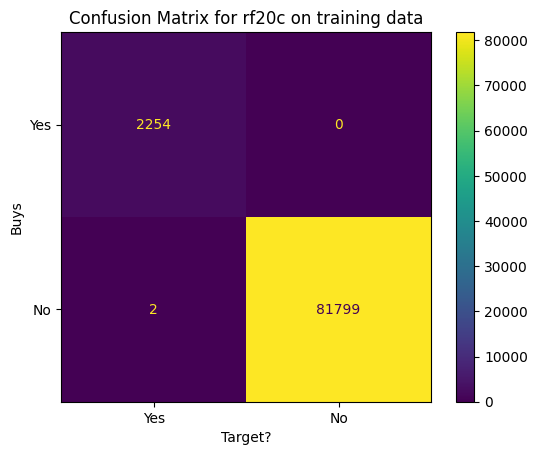

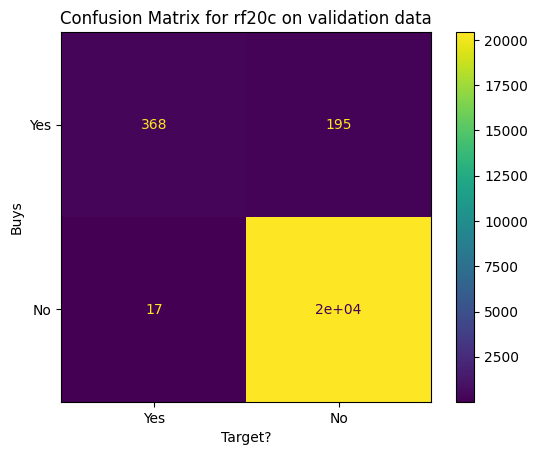

In [ ]:
rf20c = plant_forest("rf20c", n_estimators=750, class_weight='balanced')

RF21 takes parameters for stronger models but with balanced class weight

Training Accuracy for rf21:  0.9999762060555588
Training Precision for rf21:  0.999113475177305
Training Recall for rf21:  1.0
Training F1 Score for rf21:  0.9995565410199556
Training F2 Score for rf21:  0.9998225691980128
Training F3 Score for rf21:  0.9999112767278857

Validation Accuracy for rf21:  0.9906252974207671
Validation Precision for rf21:  0.9159090909090909
Validation Recall for rf21:  0.7158081705150977
Validation F1 Score for rf21:  0.8035892323030907
Validation F2 Score for rf21:  0.7485141158989599
Validation F3 Score for rf21:  0.7485141158989599

Accuracy Generalization Loss for rf21:  0.00935090863479171
Precision Generalization Loss for rf21:  0.08320438426821408
Recall Generalization Loss for rf21:  0.2841918294849023
F1 Generalization Loss for rf21:  0.19596730871686496
F2 Generalization Loss for rf21:  0.25130845329905294
F3 Generalization Loss for rf21:  0.2513971608289258



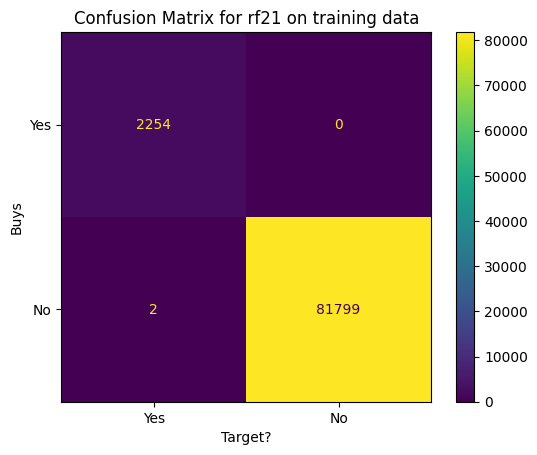

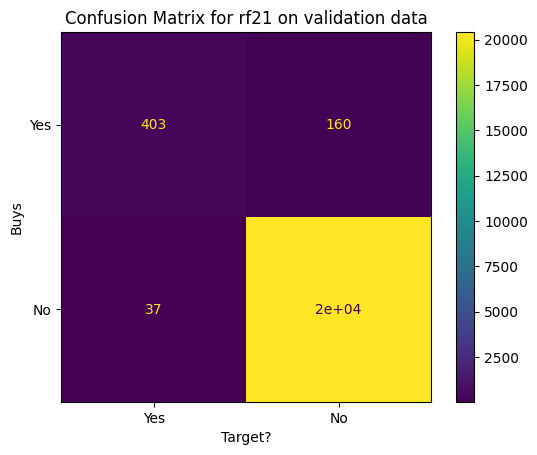

In [ ]:
rf21 = plant_forest("rf21", n_estimators=750, max_features=None, class_weight="balanced")

Training Accuracy for rf21a:  0.9999762060555588
Training Precision for rf21a:  0.999113475177305
Training Recall for rf21a:  1.0
Training F1 Score for rf21a:  0.9995565410199556
Training F2 Score for rf21a:  0.9998225691980128
Training F3 Score for rf21a:  0.9999112767278857

Validation Accuracy for rf21a:  0.9907204720662416
Validation Precision for rf21a:  0.9200913242009132
Validation Recall for rf21a:  0.7158081705150977
Validation F1 Score for rf21a:  0.8051948051948051
Validation F2 Score for rf21a:  0.7490706319702601
Validation F3 Score for rf21a:  0.7490706319702601

Accuracy Generalization Loss for rf21a:  0.009255733989317227
Precision Generalization Loss for rf21a:  0.07902215097639176
Recall Generalization Loss for rf21a:  0.2841918294849023
F1 Generalization Loss for rf21a:  0.19436173582515048
F2 Generalization Loss for rf21a:  0.2507519372277527
F3 Generalization Loss for rf21a:  0.2508406447576256



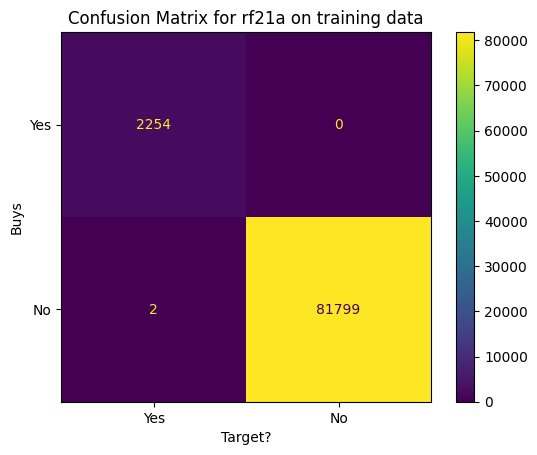

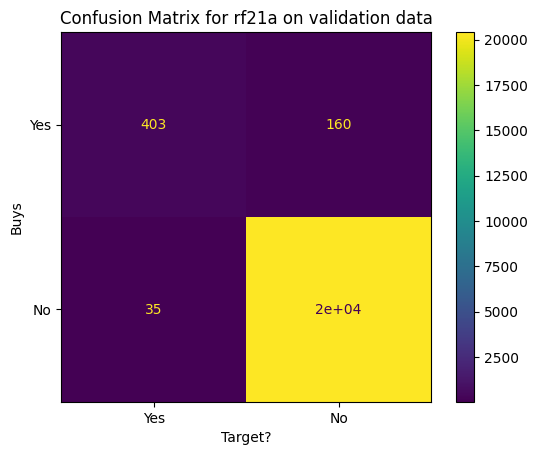

In [ ]:
rf21a = plant_forest("rf21a", n_estimators=500, max_features=None, class_weight='balanced')

Training Accuracy for rf21b:  0.9999762060555588
Training Precision for rf21b:  0.999113475177305
Training Recall for rf21b:  1.0
Training F1 Score for rf21b:  0.9995565410199556
Training F2 Score for rf21b:  0.9998225691980128
Training F3 Score for rf21b:  0.9999112767278857

Validation Accuracy for rf21b:  0.9907680593889788
Validation Precision for rf21b:  0.9221967963386728
Validation Recall for rf21b:  0.7158081705150977
Validation F1 Score for rf21b:  0.806
Validation F2 Score for rf21b:  0.7493492004462625
Validation F3 Score for rf21b:  0.7493492004462625

Accuracy Generalization Loss for rf21b:  0.009208146666579986
Precision Generalization Loss for rf21b:  0.07691667883863218
Recall Generalization Loss for rf21b:  0.2841918294849023
F1 Generalization Loss for rf21b:  0.19355654101995556
F2 Generalization Loss for rf21b:  0.2504733687517503
F3 Generalization Loss for rf21b:  0.2505620762816232



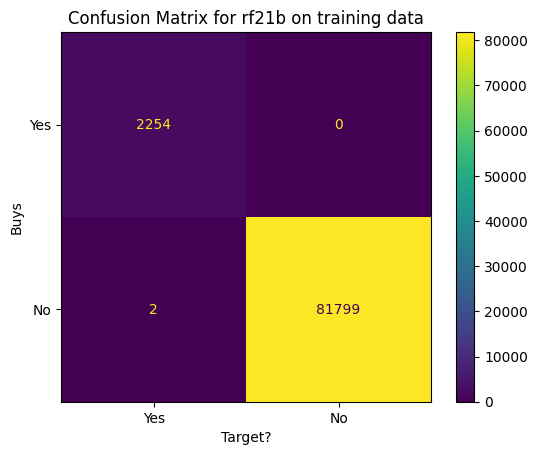

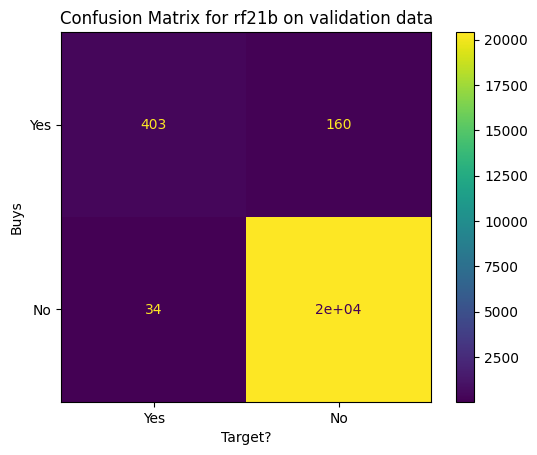

In [ ]:
rf21b = plant_forest("rf21b", n_estimators=1000, max_features=None, class_weight='balanced')

In [ ]:
rf21c = plant_forest("rf21c", n_estimators=250, max_features=None, class_weight='balanced')

RF22: trying 'balanced_subsample' for class_weight

In [ ]:
rf22 = plant_forest("rf22", class_weight="balanced_subsample")

RF23: trying balanced class_weight with 500 estimators, reducing max_depth to 25, no max features

In [ ]:
rf23 = plant_forest("rf23", n_estimators=500, max_depth=25, max_features=None, class_weight='balanced')

Training Accuracy for rf23a:  0.9975016358336803
Training Precision for rf23a:  0.9147727272727273
Training Recall for rf23a:  1.0
Training F1 Score for rf23a:  0.9554896142433235
Training F2 Score for rf23a:  0.9817073170731708
Training F3 Score for rf23a:  0.9907692307692308

Validation Accuracy for rf23a:  0.9895783763205482
Validation Precision for rf23a:  0.8208955223880597
Validation Recall for rf23a:  0.7815275310834814
Validation F1 Score for rf23a:  0.8007279344858963
Validation F2 Score for rf23a:  0.7890961262553803
Validation F3 Score for rf23a:  0.7890961262553803

Accuracy Generalization Loss for rf23a:  0.007923259513132108
Precision Generalization Loss for rf23a:  0.09387720488466755
Recall Generalization Loss for rf23a:  0.21847246891651861
F1 Generalization Loss for rf23a:  0.15476167975742716
F2 Generalization Loss for rf23a:  0.19261119081779055
F3 Generalization Loss for rf23a:  0.20167310451385057



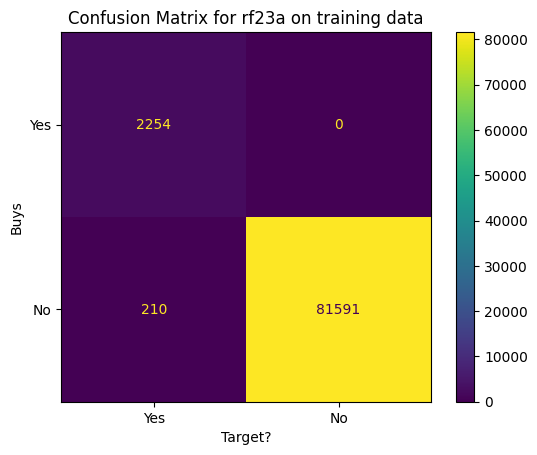

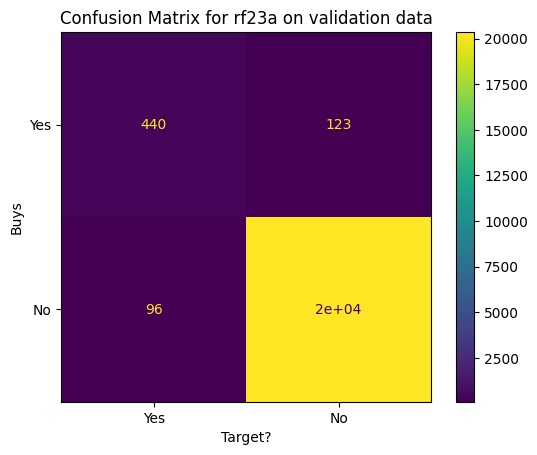

In [ ]:
rf23a = plant_forest("rf23a", n_estimators=500, max_depth=20, max_features=None, class_weight='balanced')

Training Accuracy for rf23:  0.9896972220569865
Training Precision for rf23:  0.7235824742268041
Training Recall for rf23:  0.9964507542147294
Training F1 Score for rf23:  0.8383725270623367
Training F2 Score for rf23:  0.9265676567656764
Training F3 Score for rf23:  0.960239418554938

Validation Accuracy for rf23:  0.9837251356238698
Validation Precision for rf23:  0.6515775034293553
Validation Recall for rf23:  0.8436944937833037
Validation F1 Score for rf23:  0.7352941176470589
Validation F2 Score for rf23:  0.7967125125796712
Validation F3 Score for rf23:  0.7967125125796712

Accuracy Generalization Loss for rf23:  0.005972086433116752
Precision Generalization Loss for rf23:  0.07200497079744883
Recall Generalization Loss for rf23:  0.15275626043142565
F1 Generalization Loss for rf23:  0.1030784094152778
F2 Generalization Loss for rf23:  0.1298551441860052
F3 Generalization Loss for rf23:  0.16352690597526676



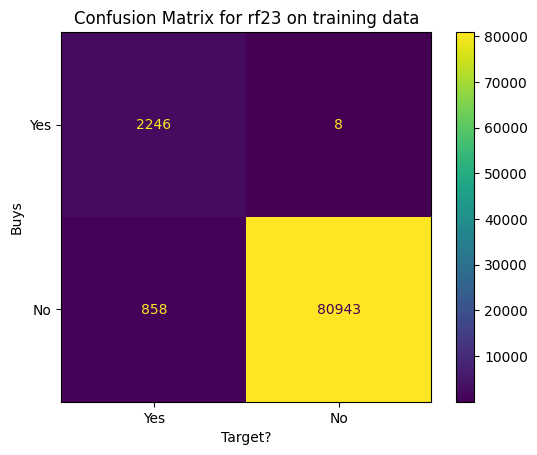

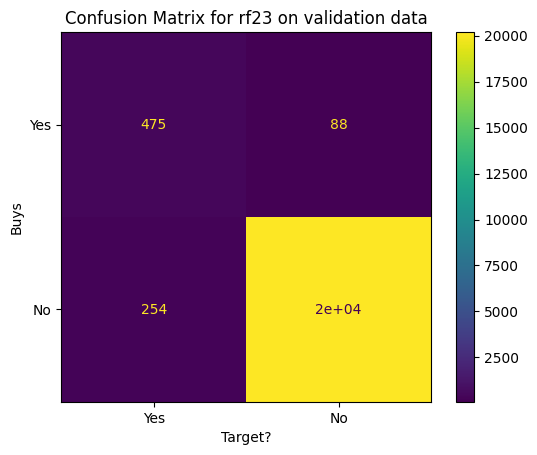

In [ ]:
rf23b = plant_forest("rf23", n_estimators=500, max_depth=15, max_features=None, class_weight='balanced')

experimenting with msl for balanced class_weight models with None max_features

Training Accuracy for rf24:  0.9898280887514128
Training Precision for rf24:  0.7258637391023571
Training Recall for rf24:  0.997338065661047
Training F1 Score for rf24:  0.8402167819099233
Training F2 Score for rf24:  0.9279286716750599
Training F3 Score for rf24:  0.9613822007441302

Validation Accuracy for rf24:  0.9844389454649282
Validation Precision for rf24:  0.6616438356164384
Validation Recall for rf24:  0.8579040852575488
Validation F1 Score for rf24:  0.7470997679814385
Validation F2 Score for rf24:  0.8098591549295775
Validation F3 Score for rf24:  0.8098591549295775

Accuracy Generalization Loss for rf24:  0.0053891432864846545
Precision Generalization Loss for rf24:  0.06421990348591877
Recall Generalization Loss for rf24:  0.1394339804034982
F1 Generalization Loss for rf24:  0.09311701392848482
F2 Generalization Loss for rf24:  0.11806951674548238
F3 Generalization Loss for rf24:  0.15152304581455267



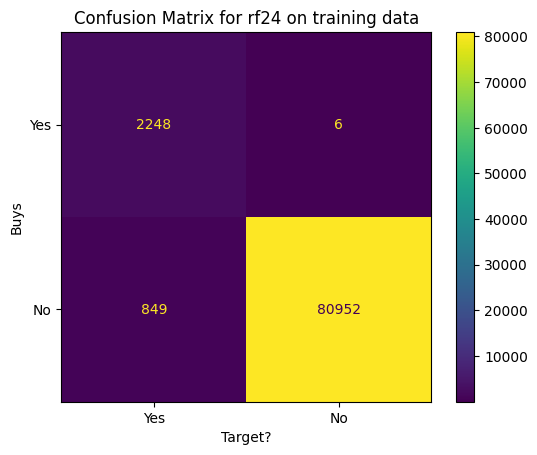

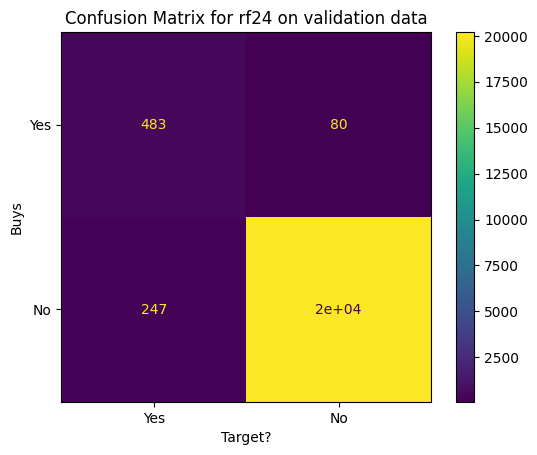

In [ ]:
rf24 = plant_forest("rf24", n_estimators=500, max_depth=15, min_samples_leaf=2, max_features=None, class_weight='balanced')

Training Accuracy for rf24a:  0.9892094461959431
Training Precision for rf24a:  0.7137416693113298
Training Recall for rf24a:  0.9977817213842058
Training F1 Score for rf24a:  0.8321924144310824
Training F2 Score for rf24a:  0.9242212542122132
Training F3 Score for rf24a:  0.9595938046678328

Validation Accuracy for rf24a:  0.9841534215285048
Validation Precision for rf24a:  0.6545698924731183
Validation Recall for rf24a:  0.8650088809946714
Validation F1 Score for rf24a:  0.7452180566182096
Validation F2 Score for rf24a:  0.8127503337783711
Validation F3 Score for rf24a:  0.8127503337783711

Accuracy Generalization Loss for rf24a:  0.005056024667438264
Precision Generalization Loss for rf24a:  0.05917177683821151
Recall Generalization Loss for rf24a:  0.1327728403895344
F1 Generalization Loss for rf24a:  0.08697435781287277
F2 Generalization Loss for rf24a:  0.1114709204338421
F3 Generalization Loss for rf24a:  0.1468434708894617



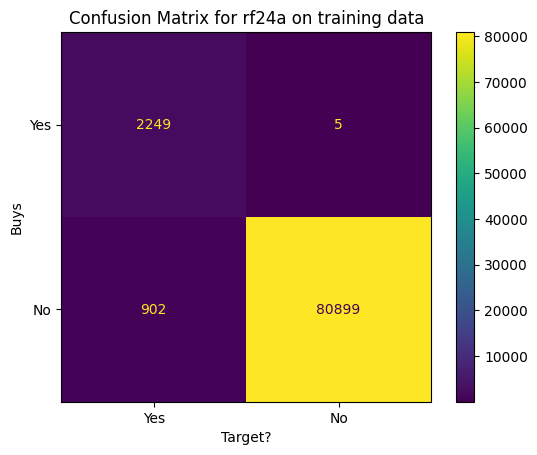

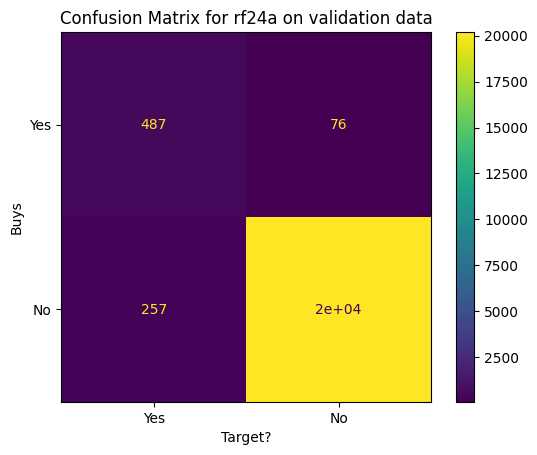

In [ ]:
rf24a = plant_forest("rf24a", n_estimators=500, max_depth=15, min_samples_leaf=3, max_features=None, class_weight='balanced')

Training Accuracy for rf24b:  0.988329070251621
Training Precision for rf24b:  0.6972420204524326
Training Recall for rf24b:  0.9982253771073647
Training F1 Score for rf24b:  0.8210180623973727
Training F2 Score for rf24b:  0.9188924283263907
Training F3 Score for rf24b:  0.9569174499213202

Validation Accuracy for rf24b:  0.9835347863329209
Validation Precision for rf24b:  0.6410923276983095
Validation Recall for rf24b:  0.8756660746003553
Validation F1 Score for rf24b:  0.7402402402402403
Validation F2 Score for rf24b:  0.8159549817941079
Validation F3 Score for rf24b:  0.8159549817941079

Accuracy Generalization Loss for rf24b:  0.004794283918700071
Precision Generalization Loss for rf24b:  0.05614969275412307
Recall Generalization Loss for rf24b:  0.12255930250700942
F1 Generalization Loss for rf24b:  0.08077782215713247
F2 Generalization Loss for rf24b:  0.10293744653228287
F3 Generalization Loss for rf24b:  0.14096246812721236



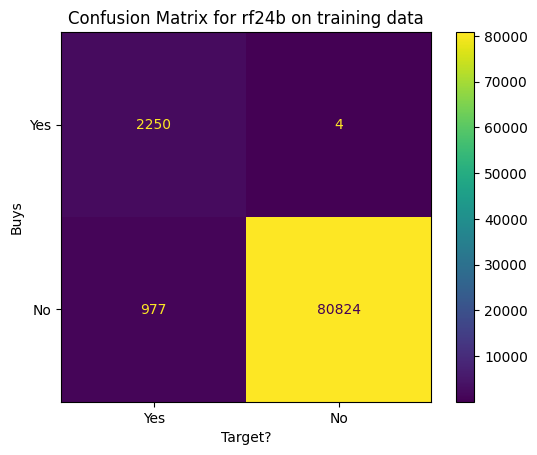

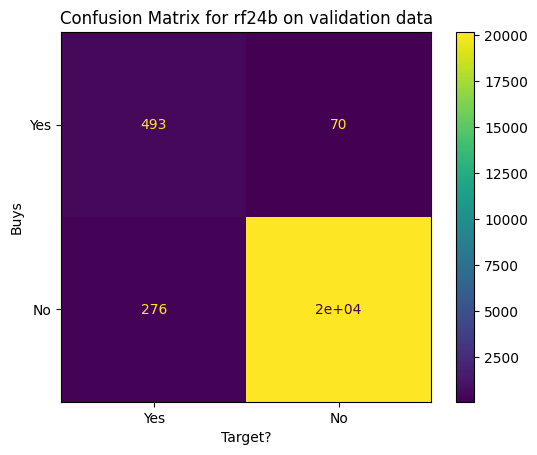

In [ ]:
rf24b = plant_forest("rf24b", n_estimators=500, max_depth=15, min_samples_leaf=4, max_features=None, class_weight='balanced')

Training Accuracy for rf24c:  0.987305930640652
Training Precision for rf24c:  0.6791427709025053
Training Recall for rf24c:  0.9982253771073647
Training F1 Score for rf24c:  0.8083348302496857
Training F2 Score for rf24c:  0.9124827642144537
Training F3 Score for rf24c:  0.9534302300944955

Validation Accuracy for rf24c:  0.9828209764918626
Validation Precision for rf24c:  0.6268844221105527
Validation Recall for rf24c:  0.8863232682060391
Validation F1 Score for rf24c:  0.7343635025754232
Validation F2 Score for rf24c:  0.8185695538057743
Validation F3 Score for rf24c:  0.8185695538057743

Accuracy Generalization Loss for rf24c:  0.004484954148789355
Precision Generalization Loss for rf24c:  0.05225834879195257
Recall Generalization Loss for rf24c:  0.11190210890132557
F1 Generalization Loss for rf24c:  0.07397132767426251
F2 Generalization Loss for rf24c:  0.09391321040867939
F3 Generalization Loss for rf24c:  0.13486067628872112



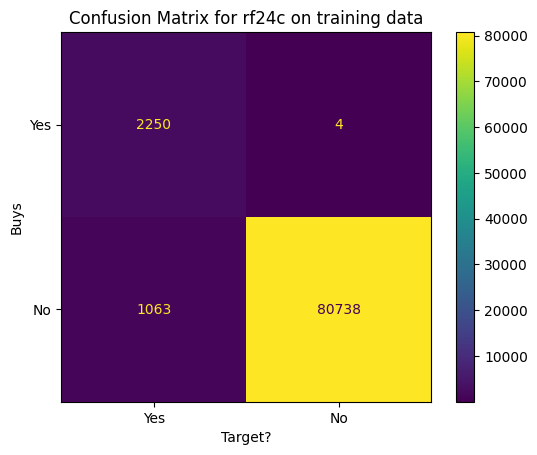

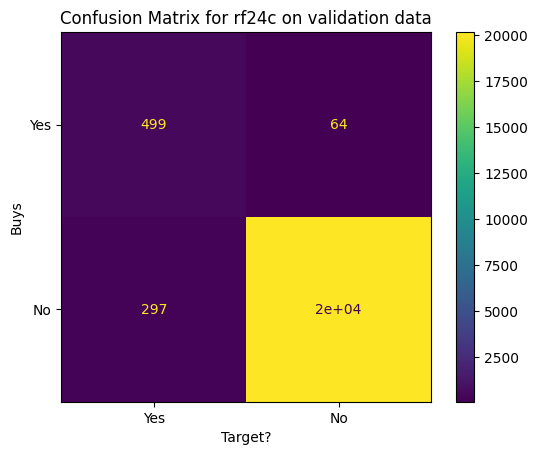

In [ ]:
rf24c = plant_forest("rf24c", n_estimators=500, max_depth=15, min_samples_leaf=5, max_features=None, class_weight='balanced')

Training Accuracy for rf24d:  0.9827612872523943
Training Precision for rf24d:  0.6095834467737544
Training Recall for rf24d:  0.9933451641526175
Training F1 Score for rf24d:  0.7555255609920702
Training F2 Score for rf24d:  0.8822602253920719
Training F3 Score for rf24d:  0.9345131265912601

Validation Accuracy for rf24d:  0.9793471019320453
Validation Precision for rf24d:  0.5711135611907387
Validation Recall for rf24d:  0.9200710479573713
Validation F1 Score for rf24d:  0.7047619047619048
Validation F2 Score for rf24d:  0.8198797087685976
Validation F3 Score for rf24d:  0.8198797087685976

Accuracy Generalization Loss for rf24d:  0.0034141853203489836
Precision Generalization Loss for rf24d:  0.03846988558301567
Recall Generalization Loss for rf24d:  0.07327411619524626
F1 Generalization Loss for rf24d:  0.05076365623016543
F2 Generalization Loss for rf24d:  0.062380516623474325
F3 Generalization Loss for rf24d:  0.11463341782266245



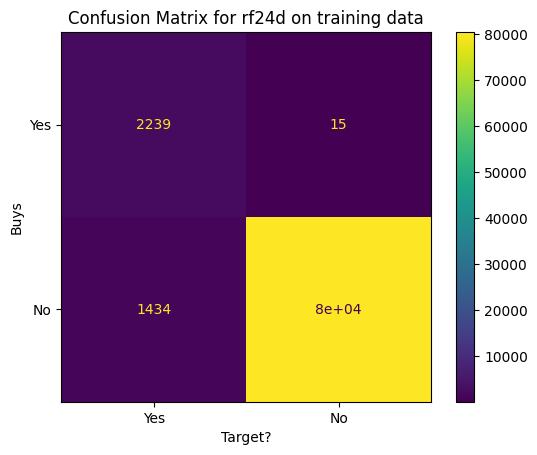

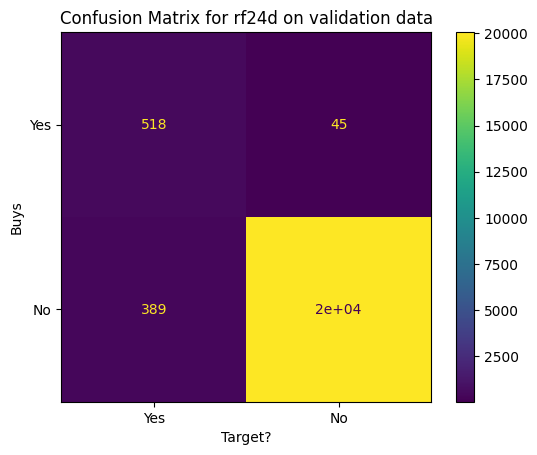

In [ ]:
rf24d = plant_forest("rf24d", n_estimators=500, max_depth=15, min_samples_leaf=10, max_features=None, class_weight='balanced')

Training Accuracy for rf24e:  0.9784664802807685
Training Precision for rf24e:  0.5555
Training Recall for rf24e:  0.9858030168589175
Training F1 Score for rf24e:  0.7105852254557082
Training F2 Score for rf24e:  0.8535648432698216
Training F3 Score for rf24e:  0.9149304125833813

Validation Accuracy for rf24e:  0.9753973541448558
Validation Precision for rf24e:  0.5234215885947047
Validation Recall for rf24e:  0.9129662522202486
Validation F1 Score for rf24e:  0.6653721682847896
Validation F2 Score for rf24e:  0.7946815089672231
Validation F3 Score for rf24e:  0.7946815089672231

Accuracy Generalization Loss for rf24e:  0.003069126135912703
Precision Generalization Loss for rf24e:  0.032078411405295326
Recall Generalization Loss for rf24e:  0.07283676463866884
F1 Generalization Loss for rf24e:  0.045213057170918614
F2 Generalization Loss for rf24e:  0.05888333430259851
F3 Generalization Loss for rf24e:  0.12024890361615814



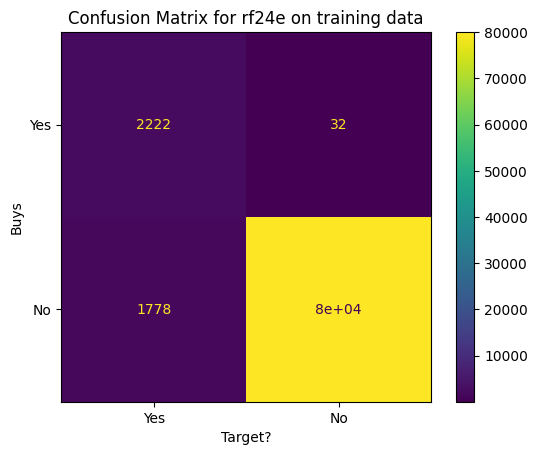

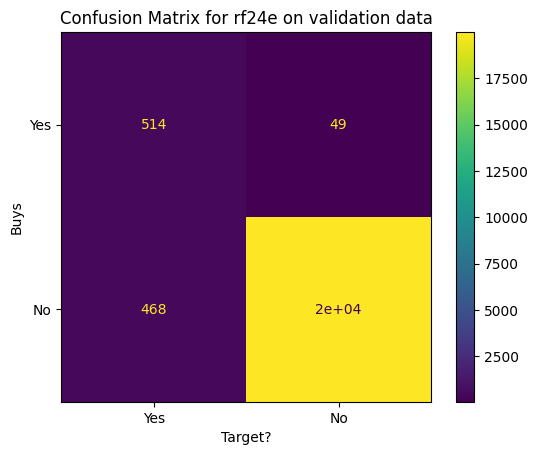

In [ ]:
rf24e = plant_forest("rf24e", n_estimators=500, max_depth=15, min_samples_leaf=15, max_features=None, class_weight='balanced')

RF25: restoring max_depth to 20 to eliminate trainin FNs, tuning min_samples_leaf up to 3 to reduce variance

Training Accuracy for rf25:  0.9967521265837844
Training Precision for rf25:  0.8919667590027701
Training Recall for rf25:  1.0
Training F1 Score for rf25:  0.9428989751098097
Training F2 Score for rf25:  0.9763493026076412
Training F3 Score for rf25:  0.9880331389996931

Validation Accuracy for rf25:  0.9901018368706577
Validation Precision for rf25:  0.81195079086116
Validation Recall for rf25:  0.8206039076376554
Validation F1 Score for rf25:  0.8162544169611307
Validation F2 Score for rf25:  0.8188585607940446
Validation F3 Score for rf25:  0.8188585607940446

Accuracy Generalization Loss for rf25:  0.006650289713126756
Precision Generalization Loss for rf25:  0.08001596814161016
Recall Generalization Loss for rf25:  0.17939609236234455
F1 Generalization Loss for rf25:  0.12664455814867903
F2 Generalization Loss for rf25:  0.15749074181359657
F3 Generalization Loss for rf25:  0.16917457820564852



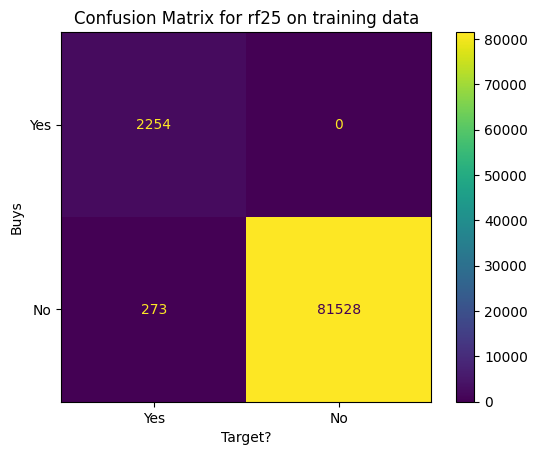

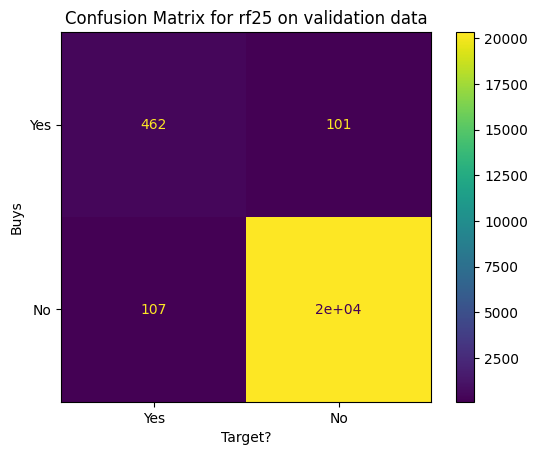

In [ ]:
rf25 = plant_forest("rf25", n_estimators=500, max_depth=20, min_samples_leaf=3, max_features=None, class_weight='balanced')

Result: variance not reduced enough, quite balanced between FNs and FPs

experimenting again with max_features for these balanced class weight models

In [ ]:
len(X.columns)

34

RF26: restoring max_features to default, keeping n_estimators at 50, min_samples_leaf=10, max_depth=15 to reduce FNs.

Training Accuracy for rf26:  0.9675331628100649
Training Precision for rf26:  0.4520105071731663
Training Recall for rf26:  0.9924578527062999
Training F1 Score for rf26:  0.621130084686936
Training F2 Score for rf26:  0.8009308986752596
Training F3 Score for rf26:  0.8864672082425202

Validation Accuracy for rf26:  0.9644046825925573
Validation Precision for rf26:  0.42594075260208164
Validation Recall for rf26:  0.9449378330373002
Validation F1 Score for rf26:  0.58719646799117
Validation F2 Score for rf26:  0.7597829191659524
Validation F3 Score for rf26:  0.7597829191659524

Accuracy Generalization Loss for rf26:  0.0031284802175075566
Precision Generalization Loss for rf26:  0.02606975457108468
Recall Generalization Loss for rf26:  0.04752001966899977
F1 Generalization Loss for rf26:  0.033933616695766
F2 Generalization Loss for rf26:  0.04114797950930715
F3 Generalization Loss for rf26:  0.1266842890765678



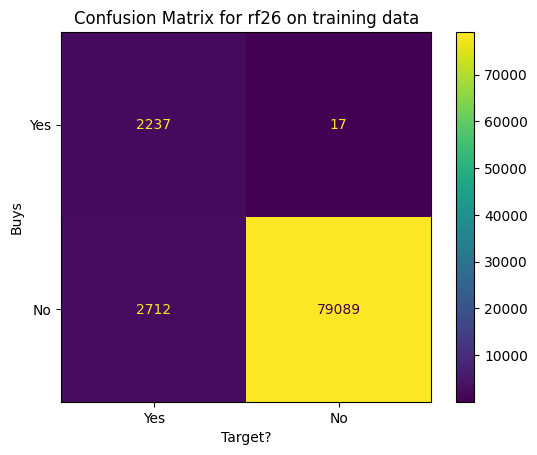

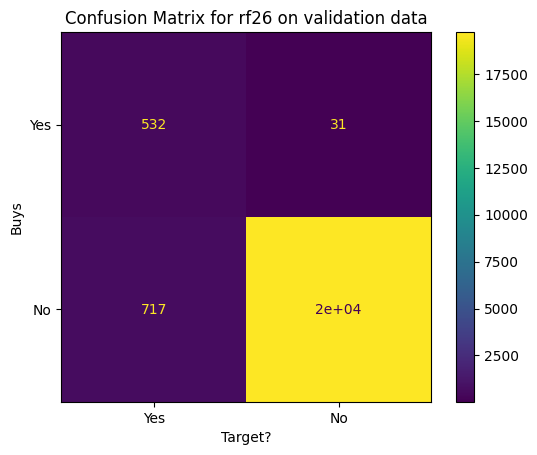

In [ ]:
rf26 = plant_forest("rf26", n_estimators=500, min_samples_leaf=10, max_depth=15, class_weight='balanced')

Result: very strong model.

pushing max_features up to 15

Training Accuracy for rf26a:  0.9824281720302183
Training Precision for rf26a:  0.6051420838971583
Training Recall for rf26a:  0.9920141969831411
Training F1 Score for rf26a:  0.7517229786518742
Training F2 Score for rf26a:  0.8795531429470538
Training F3 Score for rf26a:  0.9324048204828823

Validation Accuracy for rf26a:  0.9795374512229942
Validation Precision for rf26a:  0.5726775956284152
Validation Recall for rf26a:  0.9307282415630551
Validation F1 Score for rf26a:  0.709066305818674
Validation F2 Score for rf26a:  0.8272813388064414
Validation F3 Score for rf26a:  0.8272813388064414

Accuracy Generalization Loss for rf26a:  0.0028907208072240786
Precision Generalization Loss for rf26a:  0.03246448826874304
Recall Generalization Loss for rf26a:  0.06128595542008597
F1 Generalization Loss for rf26a:  0.04265667283320018
F2 Generalization Loss for rf26a:  0.05227180414061239
F3 Generalization Loss for rf26a:  0.10512348167644092



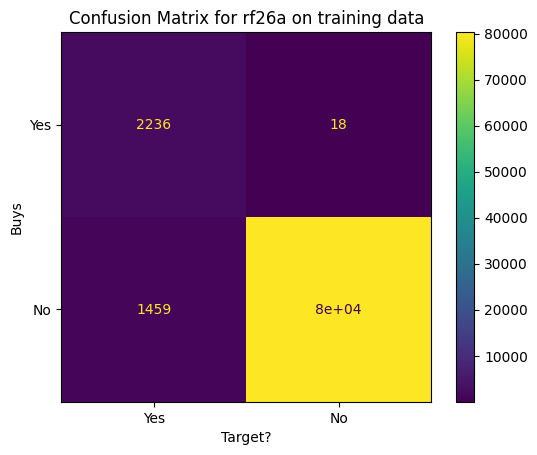

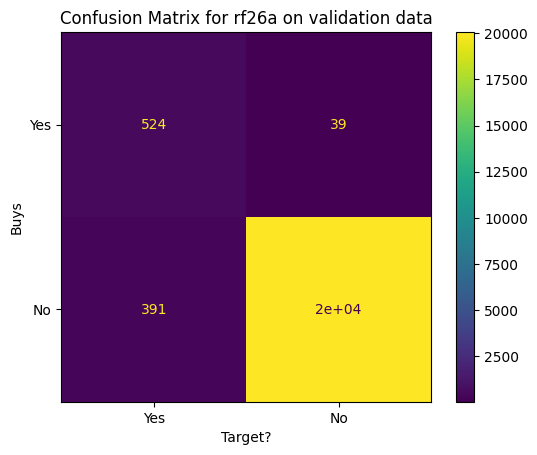

In [ ]:
rf26a = plant_forest("rf26a", n_estimators=500, max_depth=15, min_samples_leaf=10, max_features=15, class_weight='balanced')

Result: trade-off between FPs and FNs when bumping max_features. Each additional FN reduces FPs by nearly 100. Max_features will be quite powerful at improving Precision and F1 Score.

RF26B:

Training Accuracy for rf26b:  0.927618821010053
Training Precision for rf26b:  0.26815980629539954
Training Recall for rf26b:  0.9826974267968057
Training F1 Score for rf26b:  0.4213429712763935
Training F2 Score for rf26b:  0.64106274600602
Training F3 Score for rf26b:  0.7759405871225391

Validation Accuracy for rf26b:  0.9200532978014657
Validation Precision for rf26b:  0.2425080682342093
Validation Recall for rf26b:  0.9342806394316163
Validation F1 Score for rf26b:  0.3850658857979502
Validation F2 Score for rf26b:  0.5948880343813616
Validation F3 Score for rf26b:  0.5948880343813616

Accuracy Generalization Loss for rf26b:  0.007565523208587277
Precision Generalization Loss for rf26b:  0.025651738061190227
Recall Generalization Loss for rf26b:  0.048416787365189395
F1 Generalization Loss for rf26b:  0.03627708547844327
F2 Generalization Loss for rf26b:  0.04617471162465836
F3 Generalization Loss for rf26b:  0.18105255274117749



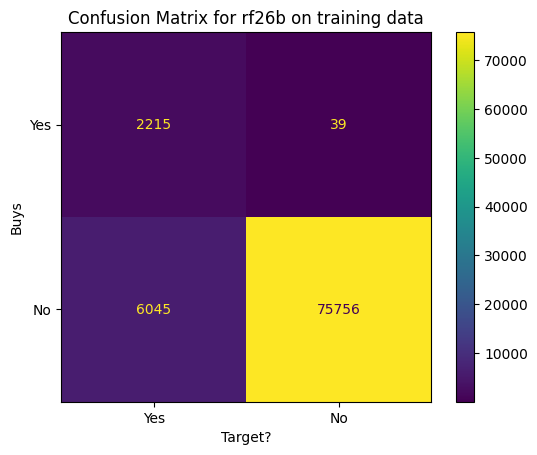

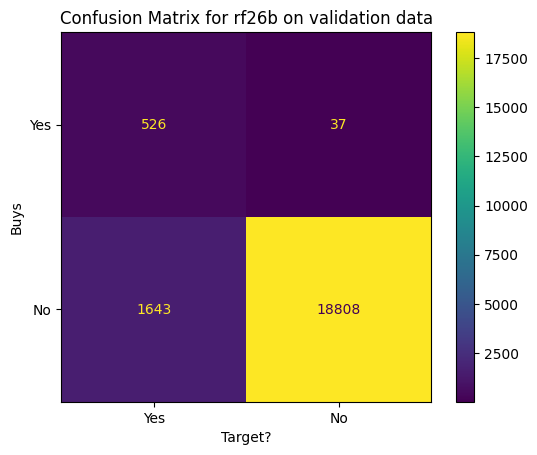

In [ ]:
rf26b = plant_forest("rf26b", n_estimators=500, max_depth=15, min_samples_leaf=10, max_features=1, class_weight='balanced')

Training Accuracy for rf26c:  0.980417583724942
Training Precision for rf26c:  0.5786749482401656
Training Recall for rf26c:  0.9920141969831411
Training F1 Score for rf26c:  0.7309578293559987
Training F2 Score for rf26c:  0.8680124223602486
Training F3 Score for rf26c:  0.9258799171842651

Validation Accuracy for rf26c:  0.9778243076044542
Validation Precision for rf26c:  0.5506792058516197
Validation Recall for rf26c:  0.9360568383658969
Validation F1 Score for rf26c:  0.6934210526315789
Validation F2 Score for rf26c:  0.8211280772826426
Validation F3 Score for rf26c:  0.8211280772826426

Accuracy Generalization Loss for rf26c:  0.002593276120487875
Precision Generalization Loss for rf26c:  0.027995742388545963
Recall Generalization Loss for rf26c:  0.05595735861724416
F1 Generalization Loss for rf26c:  0.037536776724419796
F2 Generalization Loss for rf26c:  0.04688434507760597
F3 Generalization Loss for rf26c:  0.10475183990162251



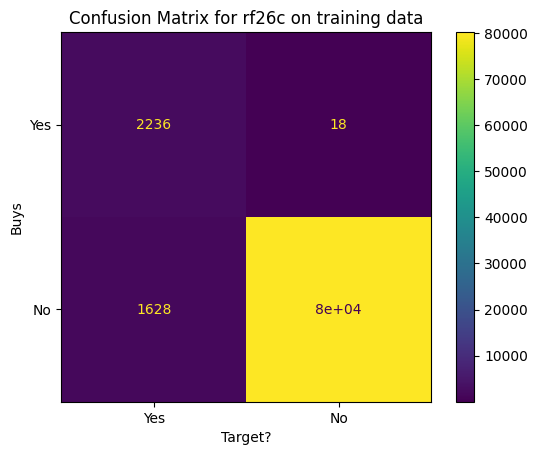

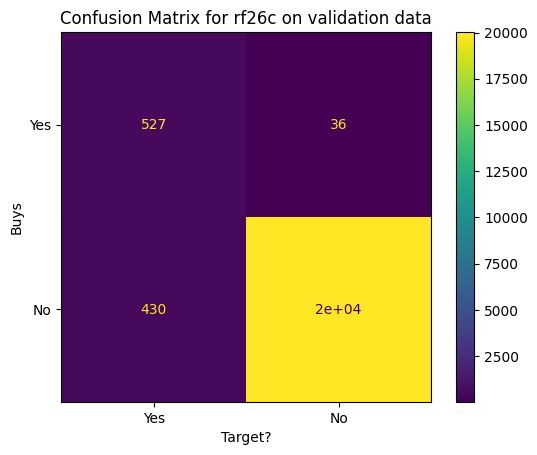

In [ ]:
rf26c = plant_forest("rf26c", n_estimators=500, max_depth=15, min_samples_leaf=10, max_features=10, class_weight='balanced')

Training Accuracy for rf26d:  0.9675331628100649
Training Precision for rf26d:  0.4520105071731663
Training Recall for rf26d:  0.9924578527062999
Training F1 Score for rf26d:  0.621130084686936
Training F2 Score for rf26d:  0.8009308986752596
Training F3 Score for rf26d:  0.8864672082425202

Validation Accuracy for rf26d:  0.9644046825925573
Validation Precision for rf26d:  0.42594075260208164
Validation Recall for rf26d:  0.9449378330373002
Validation F1 Score for rf26d:  0.58719646799117
Validation F2 Score for rf26d:  0.7597829191659524
Validation F3 Score for rf26d:  0.7597829191659524

Accuracy Generalization Loss for rf26d:  0.0031284802175075566
Precision Generalization Loss for rf26d:  0.02606975457108468
Recall Generalization Loss for rf26d:  0.04752001966899977
F1 Generalization Loss for rf26d:  0.033933616695766
F2 Generalization Loss for rf26d:  0.04114797950930715
F3 Generalization Loss for rf26d:  0.1266842890765678



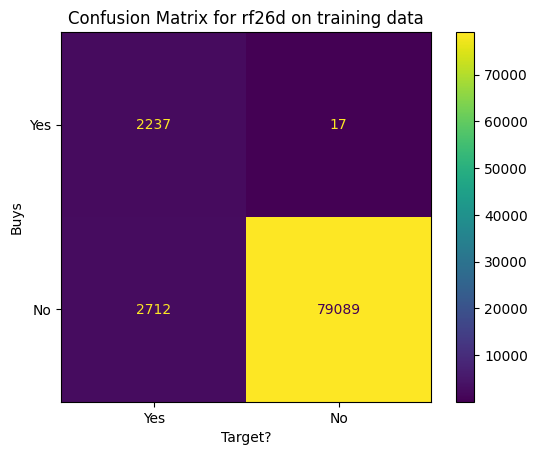

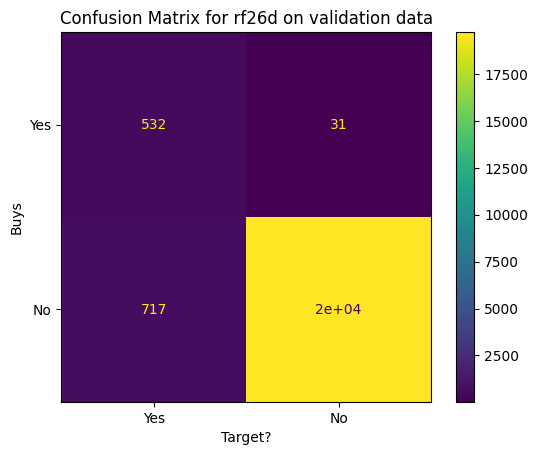

In [ ]:
rf26d = plant_forest("rf26d", n_estimators=500, max_depth=15, min_samples_leaf=10, max_features='log2', class_weight='balanced')

Seeing how performance is affected if we keep same hyperparams but drop n_estimators back down to default

Training Accuracy for rf27:  0.9674974718934032
Training Precision for rf27:  0.45167812373635263
Training Recall for rf27:  0.9911268855368234
Training F1 Score for rf27:  0.6205555555555556
Training F2 Score for rf27:  0.8000286491906603
Training F3 Score for rf27:  0.8853836398224475

Validation Accuracy for rf27:  0.9641667459788712
Validation Precision for rf27:  0.42326332794830374
Validation Recall for rf27:  0.9307282415630551
Validation F1 Score for rf27:  0.5818989450305385
Validation F2 Score for rf27:  0.7507163323782234
Validation F3 Score for rf27:  0.7507163323782234

Accuracy Generalization Loss for rf27:  0.0033307259145319845
Precision Generalization Loss for rf27:  0.028414795788048897
Recall Generalization Loss for rf27:  0.06039864397376826
F1 Generalization Loss for rf27:  0.03865661052501712
F2 Generalization Loss for rf27:  0.04931231681243686
F3 Generalization Loss for rf27:  0.13466730744422406



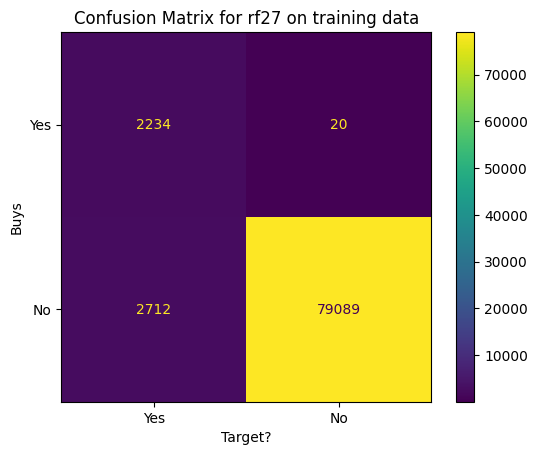

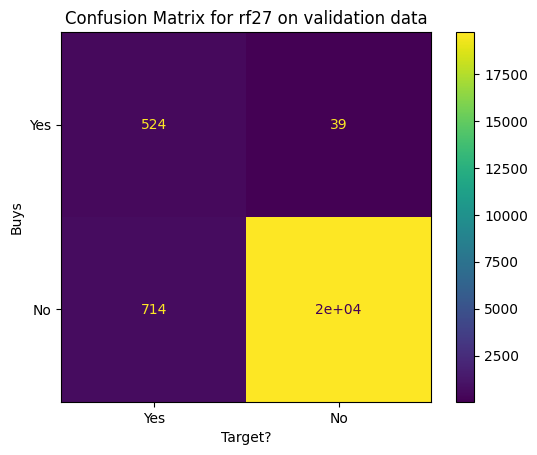

In [ ]:
rf27 = plant_forest("rf27", max_depth=15, min_samples_leaf=10, class_weight='balanced')

Training Accuracy for rf27a:  0.9672952233656534
Training Precision for rf27a:  0.4501510574018127
Training Recall for rf27a:  0.9915705412599822
Training F1 Score for rf27a:  0.6191993350879623
Training F2 Score for rf27a:  0.7992990487089622
Training F3 Score for rf27a:  0.8851134608530355

Validation Accuracy for rf27a:  0.9641667459788712
Validation Precision for rf27a:  0.4241214057507987
Validation Recall for rf27a:  0.9431616341030196
Validation F1 Score for rf27a:  0.5851239669421487
Validation F2 Score for rf27a:  0.7577054794520547
Validation F3 Score for rf27a:  0.7577054794520547

Accuracy Generalization Loss for rf27a:  0.0031284773867822357
Precision Generalization Loss for rf27a:  0.026029651651014007
Recall Generalization Loss for rf27a:  0.048408907156962666
F1 Generalization Loss for rf27a:  0.03407536814581358
F2 Generalization Loss for rf27a:  0.04159356925690749
F3 Generalization Loss for rf27a:  0.12740798140098086



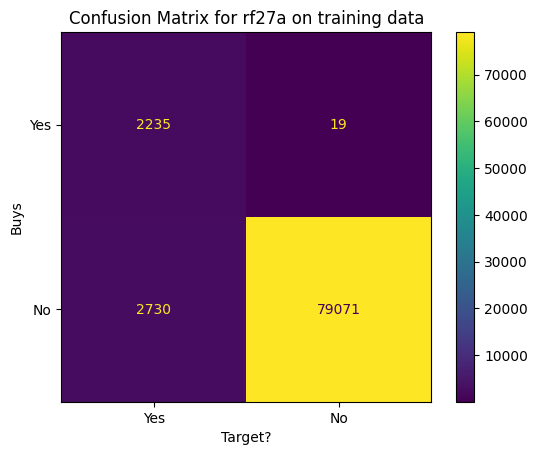

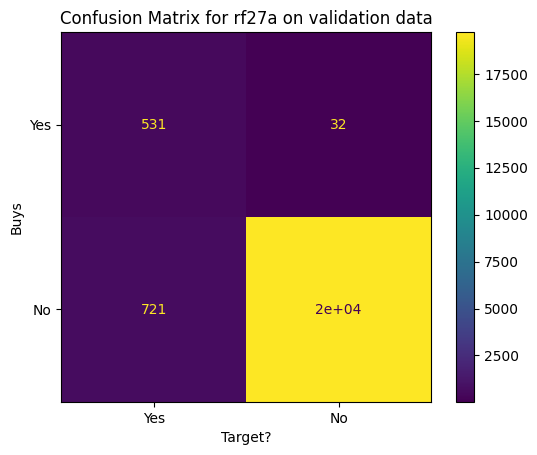

In [ ]:
rf27a = plant_forest("rf27a", n_estimators=250, max_depth=15, min_samples_leaf=10, class_weight='balanced')

Training Accuracy for rf27b:  0.9681280114210933
Training Precision for rf27b:  0.4566060853583827
Training Recall for rf27b:  0.9920141969831411
Training F1 Score for rf27b:  0.6253670815270592
Training F2 Score for rf27b:  0.8035650111406598
Training F3 Score for rf27b:  0.8879005678433863

Validation Accuracy for rf27b:  0.9649281431426668
Validation Precision for rf27b:  0.42961165048543687
Validation Recall for rf27b:  0.9431616341030196
Validation F1 Score for rf27b:  0.5903279599777654
Validation F2 Score for rf27b:  0.7611811926605505
Validation F3 Score for rf27b:  0.7611811926605505

Accuracy Generalization Loss for rf27b:  0.003199868278426443
Precision Generalization Loss for rf27b:  0.02699443487294584
Recall Generalization Loss for rf27b:  0.04885256288012152
F1 Generalization Loss for rf27b:  0.035039121549293784
F2 Generalization Loss for rf27b:  0.0423838184801093
F3 Generalization Loss for rf27b:  0.12671937518283583



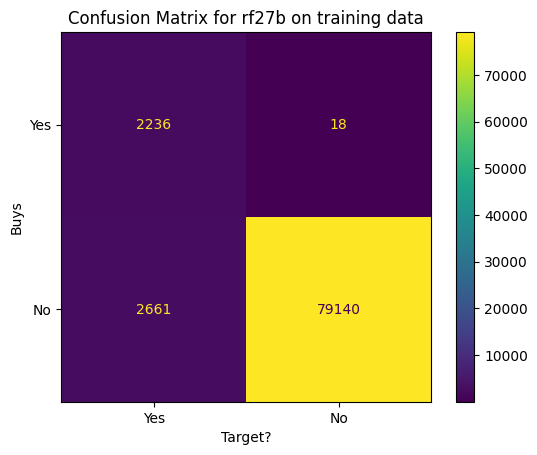

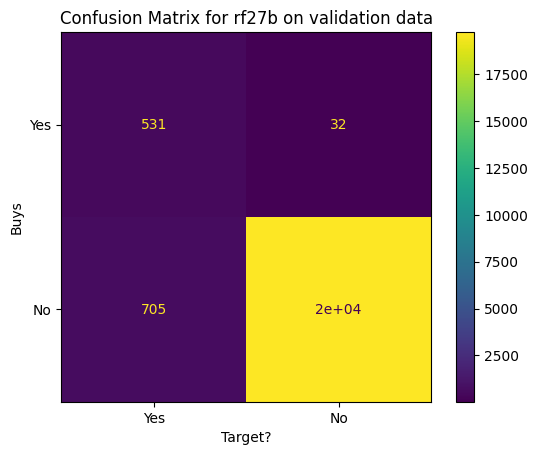

In [ ]:
rf27b = plant_forest("rf27b", n_estimators=1000, max_depth=15, min_samples_leaf=10, class_weight='balanced')

RF27C: trying 300 estimators

Training Accuracy for rf27c:  0.9675450597822854
Training Precision for rf27c:  0.4520631067961165
Training Recall for rf27c:  0.9915705412599822
Training F1 Score for rf27c:  0.621005834954154
Training F2 Score for rf27c:  0.8005014326647566
Training F3 Score for rf27c:  0.8858501783590964

Validation Accuracy for rf27c:  0.9645950318835063
Validation Precision for rf27c:  0.42742582197273454
Validation Recall for rf27c:  0.9467140319715808
Validation F1 Score for rf27c:  0.5889502762430939
Validation F2 Score for rf27c:  0.7616461846241783
Validation F3 Score for rf27c:  0.7616461846241783

Accuracy Generalization Loss for rf27c:  0.002950027898779184
Precision Generalization Loss for rf27c:  0.024637284823381955
Recall Generalization Loss for rf27c:  0.04485650928840146
F1 Generalization Loss for rf27c:  0.03205555871106003
F2 Generalization Loss for rf27c:  0.03885524804057827
F3 Generalization Loss for rf27c:  0.12420399373491808



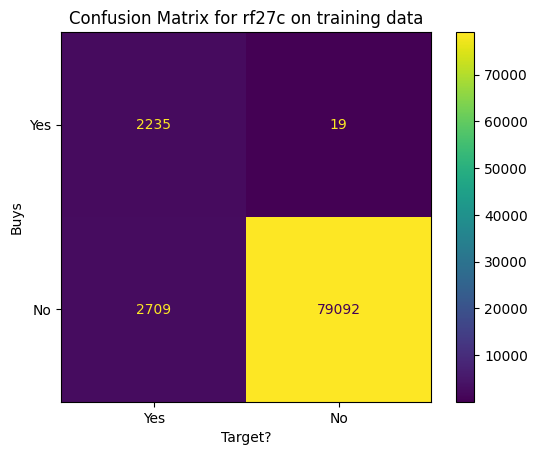

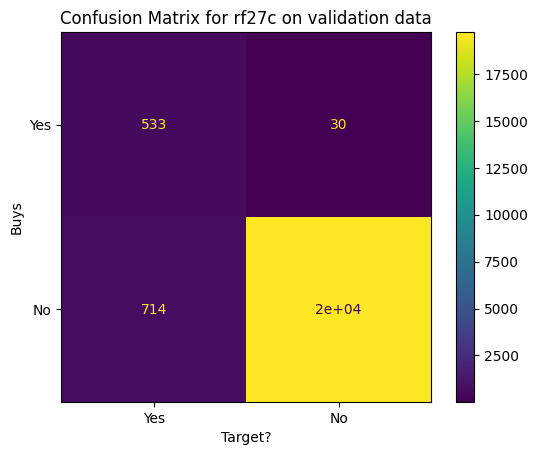

In [ ]:
rf27c = plant_forest("rf27c", n_estimators=300, max_depth=15, min_samples_leaf=10, class_weight='balanced')

Training Accuracy for rf27d:  0.9676521325322706
Training Precision for rf27d:  0.4529256934602146
Training Recall for rf27d:  0.9924578527062999
Training F1 Score for rf27d:  0.6219936048936466
Training F2 Score for rf27d:  0.8015048369759942
Training F3 Score for rf27d:  0.8868186323092171

Validation Accuracy for rf27d:  0.964547444560769
Validation Precision for rf27d:  0.42696629213483145
Validation Recall for rf27d:  0.9449378330373002
Validation F1 Score for rf27d:  0.5881702598120508
Validation F2 Score for rf27d:  0.7604345340194396
Validation F3 Score for rf27d:  0.7604345340194396

Accuracy Generalization Loss for rf27d:  0.0031046879715015407
Precision Generalization Loss for rf27d:  0.025959401325383158
Recall Generalization Loss for rf27d:  0.04752001966899977
F1 Generalization Loss for rf27d:  0.03382334508159579
F2 Generalization Loss for rf27d:  0.04107030295655456
F3 Generalization Loss for rf27d:  0.12638409828977748



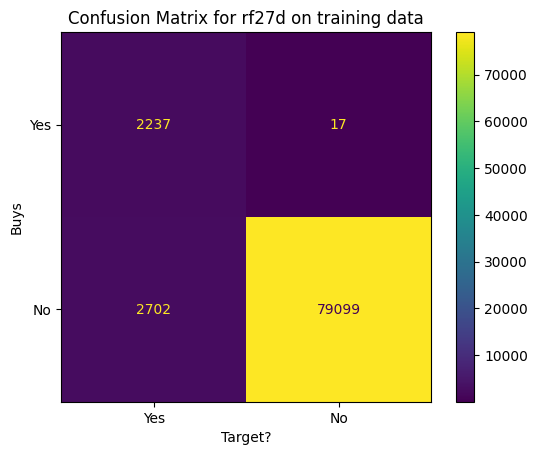

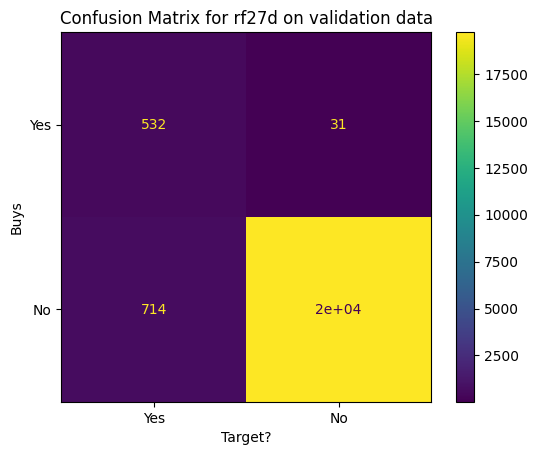

In [ ]:
rf27d = plant_forest("rf27d", n_estimators=400, max_depth=15, min_samples_leaf=10, class_weight='balanced')

Training Accuracy for rf27e:  0.9676878234489322
Training Precision for rf27e:  0.45320097244732577
Training Recall for rf27e:  0.9924578527062999
Training F1 Score for rf27e:  0.6222531293463143
Training F2 Score for rf27e:  0.8016771788990826
Training F3 Score for rf27e:  0.8869241138688447

Validation Accuracy for rf27e:  0.9645950318835063
Validation Precision for rf27e:  0.4275420336269015
Validation Recall for rf27e:  0.9484902309058615
Validation F1 Score for rf27e:  0.5894039735099338
Validation F2 Score for rf27e:  0.7626392459297344
Validation F3 Score for rf27e:  0.7626392459297344

Accuracy Generalization Loss for rf27e:  0.0030927915654259674
Precision Generalization Loss for rf27e:  0.02565893882042425
Recall Generalization Loss for rf27e:  0.04396762180043845
F1 Generalization Loss for rf27e:  0.032849155836380484
F2 Generalization Loss for rf27e:  0.03903793296934821
F3 Generalization Loss for rf27e:  0.12428486793911031



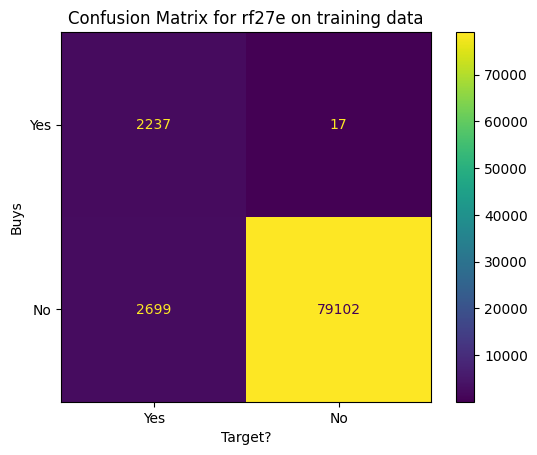

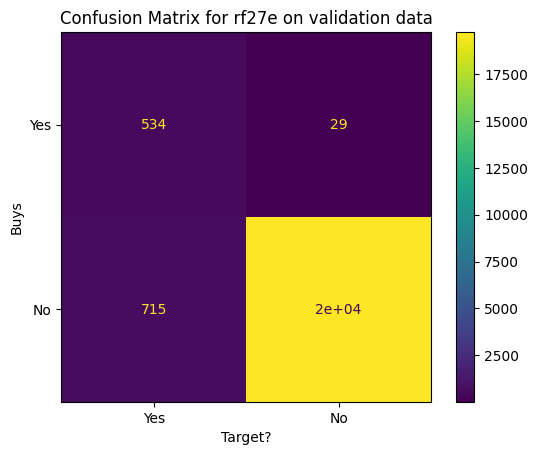

In [ ]:
rf27e = plant_forest("rf27e", n_estimators=350, max_depth=15, min_samples_leaf=10, class_weight='balanced')

Trying a lower max_depth

Training Accuracy for rf28:  0.937410029147582
Training Precision for rf28:  0.2979981190380223
Training Recall for rf28:  0.9840283939662822
Training F1 Score for rf28:  0.45746107043415496
Training F2 Score for rf28:  0.6737954918281791
Training F3 Score for rf28:  0.7998845973529518

Validation Accuracy for rf28:  0.9328067002950414
Validation Precision for rf28:  0.27970939283860924
Validation Recall for rf28:  0.9573712255772646
Validation F1 Score for rf28:  0.43293172690763054
Validation F2 Score for rf28:  0.644891122278057
Validation F3 Score for rf28:  0.644891122278057

Accuracy Generalization Loss for rf28:  0.004603328852540556
Precision Generalization Loss for rf28:  0.018288726199413075
Recall Generalization Loss for rf28:  0.02665716838901755
F1 Generalization Loss for rf28:  0.024529343526524416
F2 Generalization Loss for rf28:  0.0289043695501221
F3 Generalization Loss for rf28:  0.1549934750748948



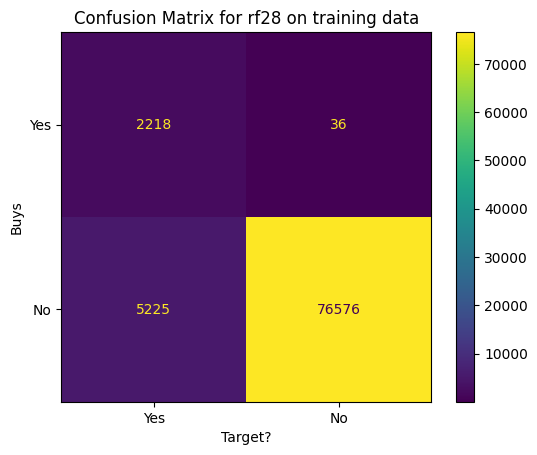

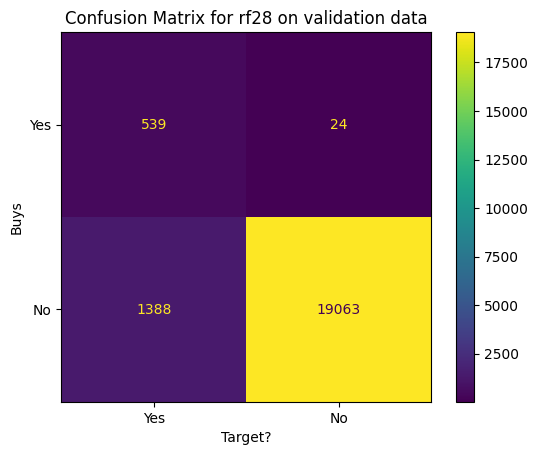

In [ ]:
rf28 = plant_forest("rf28", n_estimators=350, max_depth=10, min_samples_leaf=10, class_weight='balanced')

Training Accuracy for rf28a:  0.8463506037713402
Training Precision for rf28a:  0.14616661135081313
Training Recall for rf28a:  0.976929902395741
Training F1 Score for rf28a:  0.2542871990299671
Training F2 Score for rf28a:  0.4572069266226485
Training F3 Score for rf28a:  0.6228960991202512

Validation Accuracy for rf28a:  0.8435328828400114
Validation Precision for rf28a:  0.1437908496732026
Validation Recall for rf28a:  0.9769094138543517
Validation F1 Score for rf28a:  0.2506836827711941
Validation F2 Score for rf28a:  0.4525259173934506
Validation F3 Score for rf28a:  0.4525259173934506

Accuracy Generalization Loss for rf28a:  0.0028177209313288154
Precision Generalization Loss for rf28a:  0.0023757616776105273
Recall Generalization Loss for rf28a:  2.0488541389251935e-05
F1 Generalization Loss for rf28a:  0.0036035162587729763
F2 Generalization Loss for rf28a:  0.004681009229197897
F3 Generalization Loss for rf28a:  0.17037018172680063



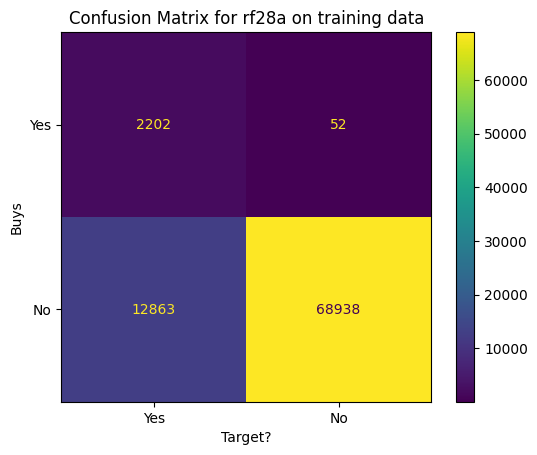

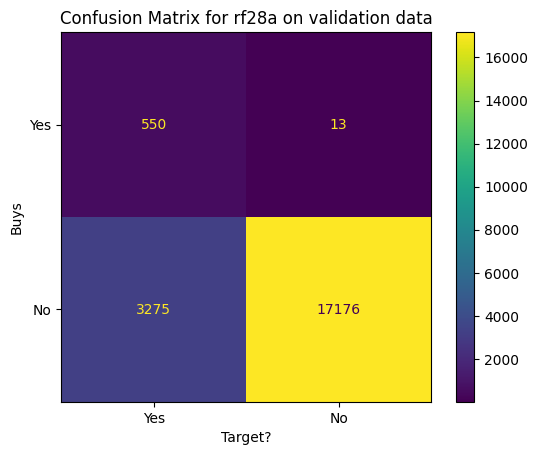

In [ ]:
rf28a = plant_forest("rf28a", n_estimators=350, max_depth=5, min_samples_leaf=10, class_weight='balanced')

Training Accuracy for rf28b:  0.7538397477841889
Training Precision for rf28b:  0.09629954017954893
Training Recall for rf28b:  0.9755989352262644
Training F1 Score for rf28b:  0.17529594643070665
Training F2 Score for rf28b:  0.34520109258735987
Training F3 Score for rf28b:  0.5099603441478631

Validation Accuracy for rf28b:  0.7506900161796898
Validation Precision for rf28b:  0.09508139937651541
Validation Recall for rf28b:  0.9751332149200711
Validation F1 Score for rf28b:  0.17326810793750985
Validation F2 Score for rf28b:  0.3420134562671318
Validation F3 Score for rf28b:  0.3420134562671318

Accuracy Generalization Loss for rf28b:  0.003149731604499162
Precision Generalization Loss for rf28b:  0.0012181408030335211
Recall Generalization Loss for rf28b:  0.00046572030619329574
F1 Generalization Loss for rf28b:  0.002027838493196793
F2 Generalization Loss for rf28b:  0.00318763632022806
F3 Generalization Loss for rf28b:  0.16794688788073125



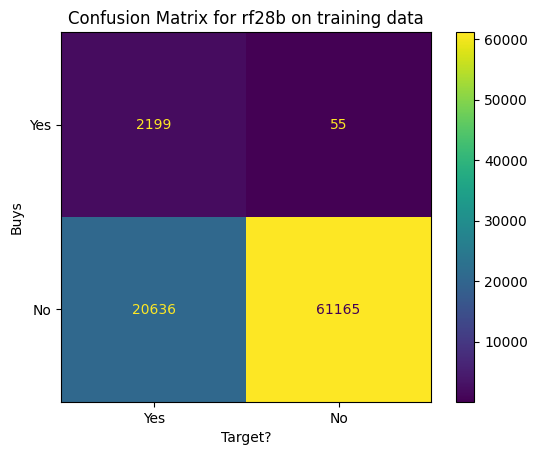

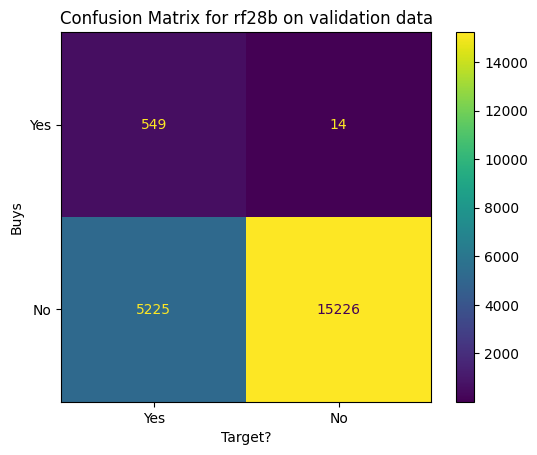

In [ ]:
rf28b = plant_forest("rf28b", n_estimators=350, max_depth=4, min_samples_leaf=10, class_weight='balanced')

Boosting max_features to see if we can buy some precision and keep recall strong

Training Accuracy for rf29:  0.9038367735411338
Training Precision for rf29:  0.2144047035766781
Training Recall for rf29:  0.9707187222715173
Training F1 Score for rf29:  0.3512320410947909
Training F2 Score for rf29:  0.5691691379220645
Training F3 Score for rf29:  0.7175887966941065

Validation Accuracy for rf29:  0.8994479870562482
Validation Precision for rf29:  0.20554711246200608
Validation Recall for rf29:  0.9609236234458259
Validation F1 Score for rf29:  0.33865414710485137
Validation F2 Score for rf29:  0.5538493038493039
Validation F3 Score for rf29:  0.5538493038493039

Accuracy Generalization Loss for rf29:  0.0043887864848856095
Precision Generalization Loss for rf29:  0.00885759111467202
Recall Generalization Loss for rf29:  0.009795098825691406
F1 Generalization Loss for rf29:  0.012577893989939526
F2 Generalization Loss for rf29:  0.015319834072760607
F3 Generalization Loss for rf29:  0.1637394928448026



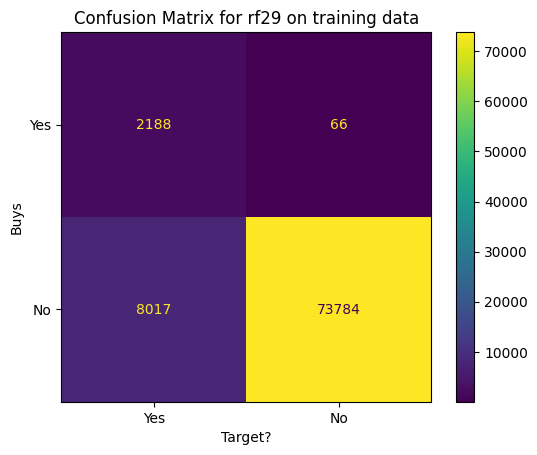

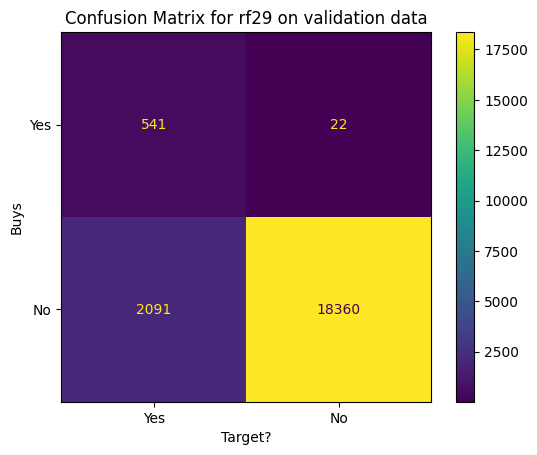

In [ ]:
rf29 = plant_forest("rf29", n_estimators=350, max_depth=5, max_features=10, min_samples_leaf=10, class_weight='balanced')

experiment a little with min_samples_leaf now

ranges:
- max_depth around 5
- n_estimators between 350 and 300
- msl

GridSearch for max_depth to optimize Recall Score

In [ ]:
# from sklearn.model_selection import GridSearchCV

# depth_grid = {
#     'max_depth': np.arange(5, 10, 1)
# }

# rf28_def = RandomForestClassifier(n_estimators=350, min_samples_leaf=10, class_weight='balanced', random_state=1917)
# rf_gs = GridSearchCV(rf28_def, depth_grid, scoring='recall', verbose=1)
# rf_gs.fit(X_train, y_train)
# rf_gs.best_params_

In [ ]:
# params_grid = {
#     'n_estimators': np.arange(300, 350, 25),
#     'min_samples_leaf': (5, 15, 2),
#     'max_features': ['sqrt', 7, 8, 9],
#     'criterion': ['gini', 'entropy']
# }
# from sklearn.ensemble import RandomForestClassifier
# from sklearn.model_selection import GridSearchCV
# rf_opt = RandomForestClassifier(max_depth=5, class_weight='balanced', random_state=1917)
# rf_gs2 = GridSearchCV(rf_opt, params_grid, scoring='recall', verbose=1)
# rf_gs2.fit(X_train, y_train)

consider testing rf_gs2

In [ ]:
rf_gs.best_params_

NameError: name 'rf_gs' is not defined

GS optimized params given class_weight-'balanced' and max_depth=5:

{'criterion': 'entropy',
 'max_features': 'sqrt',
 'min_samples_leaf': 5,
 'n_estimators': 300}

Training Accuracy for rf_gs:  0.8309916126345845
Training Precision for rf_gs:  0.13494196701282835
Training Recall for rf_gs:  0.9800354924578527
Training F1 Score for rf_gs:  0.23722079037800683
Training F2 Score for rf_gs:  0.4350823288426692
Training F3 Score for rf_gs:  0.6026298559580968

Validation Accuracy for rf_gs:  0.827638717045779
Validation Precision for rf_gs:  0.1318892900120337
Validation Recall for rf_gs:  0.9733570159857904
Validation F1 Score for rf_gs:  0.23230182280627384
Validation F2 Score for rf_gs:  0.42765724988294057
Validation F3 Score for rf_gs:  0.42765724988294057

Accuracy Generalization Loss for rf_gs:  0.0033528955888055822
Precision Generalization Loss for rf_gs:  0.0030526770007946458
Recall Generalization Loss for rf_gs:  0.006678476472062322
F1 Generalization Loss for rf_gs:  0.004918967571732991
F2 Generalization Loss for rf_gs:  0.007425078959728604
F3 Generalization Loss for rf_gs:  0.17497260607515625



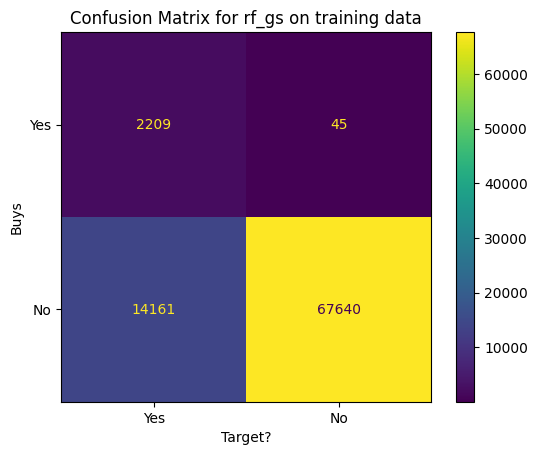

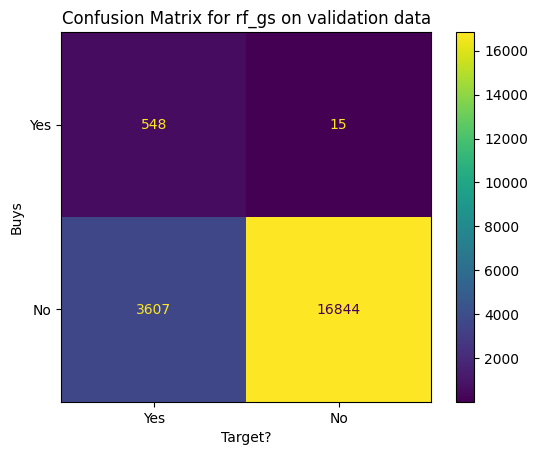

In [ ]:
rf_gs = plant_forest("rf_gs", n_estimators=300, min_samples_leaf=5, criterion='entropy', max_depth=5, class_weight='balanced')

Normalized Confusion Matrix for RFGS

In [ ]:
import matplotlib.pyplot as plt

rfgs_CM = ConfusionMatrixDisplay.from_estimator(rf_gs, X_val, y_val, labels=[1, 0], display_labels=['Yes', 'No'], normalize='true')

plt.xlabel('Target')
plt.ylabel('Buyer')
# plt.xticks(ticks=[1, 0], labels=['Yes', 'No'])
# plt.yticks(ticks=[0, 1], labels=['No', 'Yes'])
plt.show()

GSCV finds max_depth=5 is optimal for boosting Recall if other params held constant

Analyzing RF_GS

In [ ]:
rf_gs_FIs = rf_gs.feature_importances_
rf_gs_fi_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': rf_gs_FIs
})
rf_gs_fi_df['Importance'] = (rf_gs_fi_df['Importance'] * 100).round(2)
rf_gs_fi_df.sort_values('Importance', ascending=False, inplace=True)

rf_gs_fi_df

,Feature,Importance
1,sched_serv_warr,19.52
6,total_services,16.93
3,sched_serv_paid,16.61
7,mth_since_last_serv,16.13
0,age_of_vehicle_years,8.93
8,annualised_mileage,7.58
2,non_sched_serv_warr,3.67
5,total_paid_services,2.79
9,num_dealers_visited,2.75
10,num_serv_dealer_purchased,2.72


In [ ]:
#rf_gs.best_score_

In [ ]:
gs_train_score = rf_gs.score(X_train, y_train)
gs_val_score = rf_gs.score(X_val, y_val)
print("GridSearch Training Score: ", gs_train_score)
print("GridSearch Validation Score: ", gs_val_score)

assessing results if we bump up min_samples_split

In [ ]:
rf_gs1 = plant_forest("rf_gs1", n_estimators=300, min_samples_leaf=5, criterion='entropy', max_depth=5, min_samples_split=20, class_weight='balanced')

boosting MSS appears to have no effect

rf_gs2: assessing impact of min_weight_fraction_leaf parameter

In [ ]:
rf_gs2 = plant_forest("rf_gs2", n_estimators=300, min_samples_leaf=10, min_weight_fraction_leaf=0.1, criterion='entropy', max_depth=5, class_weight='balanced')

result is to increase FNs

trying out max_leaf_nodes

In [ ]:
rf_gs_estimators = rf_gs.estimators_
rf_gs_avg_leaves = np.mean([estimator.get_n_leaves() for estimator in rf_gs_estimators])
print("Average Number of Leaves in rf_gs: ", rf_gs_avg_leaves)

RF_GS has an average of 28.2 leaves per tree.

In [ ]:
rf_gs3 = plant_forest("rf_gs3", n_estimators=300, min_samples_leaf=5, criterion='entropy', max_depth=5, max_leaf_nodes=15, class_weight='balanced')

note that RF28A actually had fewer val FNs than RF_GS: 13 vs. 15.

trying out min_impurity_decrease

In [ ]:
rf_gs4 = plant_forest("rf_gs4", n_estimators=300, min_samples_leaf=5, criterion='entropy', max_depth=5, min_impurity_decrease=0.2, class_weight='balanced')

tuning up min_impurity_decrease to 0.2 restores the FN count of RF28A, but at a huge Precision cost: we now have 7150 FPs against 550 TPs and 13301 TNs. Meaning nearly 8000 targettings for 550 hits, and less then half the customer base is now discriminated out from the targetting.

RF28A is still the best Recall model on the validation data. Note however that RF_GS uses a five-fold cross validation split. We could test both.

In [ ]:
# balanced = n_samples / (n_classes * np.bincount(y))
training_bins = np.bincount(y_train)
n_samples = len(y_train)
neg_weight = n_samples / (2 * training_bins[0])
pos_weight = n_samples / (2 * training_bins[1])
print("Weight assigned to 0s in 'balanced' mode: ", neg_weight)
print("Weight assigned to 1s in 'balanced' mode: ", pos_weight)
print(training_bins)
print(n_samples)

Weight assigned to 0s in 'balanced' mode:  0.5137773376853584
Weight assigned to 1s in 'balanced' mode:  18.645740905057675
[81801  2254]
84055


Balanced mode assigns weight of ~ 0.5 to 0s and ~ 18.7 to 1s.

Manually weighting Positive cases: 0:0.5, 1:20

Training Accuracy for rf30:  0.8166676580810184
Training Precision for rf30:  0.12556921675774135
Training Recall for rf30:  0.9787045252883763
Training F1 Score for rf30:  0.22258097063868432
Training F2 Score for rf30:  0.41491122479687026
Training F3 Score for rf30:  0.5827653616526655

Validation Accuracy for rf30:  0.8133625202246122
Validation Precision for rf30:  0.12368362088281425
Validation Recall for rf30:  0.9804618117229129
Validation F1 Score for rf30:  0.21965777954635893
Validation F2 Score for rf30:  0.41102010424422925
Validation F3 Score for rf30:  0.41102010424422925

Accuracy Generalization Loss for rf30:  0.0033051378564061817
Precision Generalization Loss for rf30:  0.0018855958749271068
Recall Generalization Loss for rf30:  -0.0017572864345366535
F1 Generalization Loss for rf30:  0.002923191092325389
F2 Generalization Loss for rf30:  0.003891120552641014
F3 Generalization Loss for rf30:  0.1717452574084362



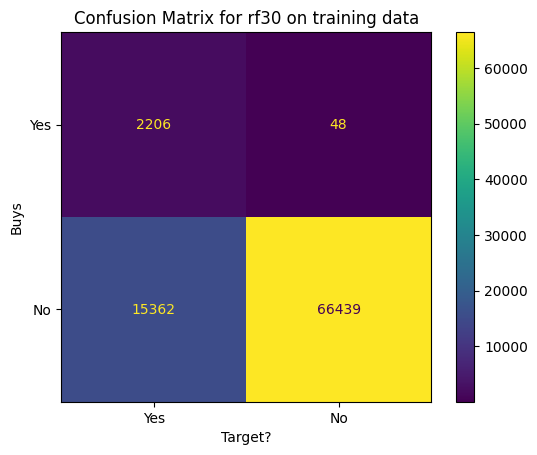

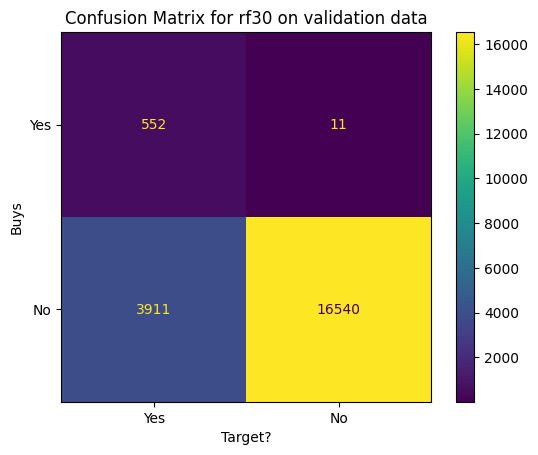

In [ ]:
manual_cw = {0: 0.5, 1: 20}
rf30 = plant_forest("rf30", n_estimators=350, max_depth=5, min_samples_leaf=10, class_weight=manual_cw)

Training Accuracy for rf30a:  0.7649515198382012
Training Precision for rf30a:  0.101171216333227
Training Recall for rf30a:  0.9849157054125999
Training F1 Score for rf30a:  0.1834938215481258
Training F2 Score for rf30a:  0.35853871249071345
Training F3 Score for rf30a:  0.5257050841838546

Validation Accuracy for rf30a:  0.760350242695346
Validation Precision for rf30a:  0.09912170639899624
Validation Recall for rf30a:  0.9822380106571936
Validation F1 Score for rf30a:  0.1800716379029632
Validation F2 Score for rf30a:  0.35308389733111994
Validation F3 Score for rf30a:  0.35308389733111994

Accuracy Generalization Loss for rf30a:  0.004601277142855187
Precision Generalization Loss for rf30a:  0.0020495099342307532
Recall Generalization Loss for rf30a:  0.002677694755406246
F1 Generalization Loss for rf30a:  0.0034221836451625853
F2 Generalization Loss for rf30a:  0.005454815159593507
F3 Generalization Loss for rf30a:  0.1726211868527347



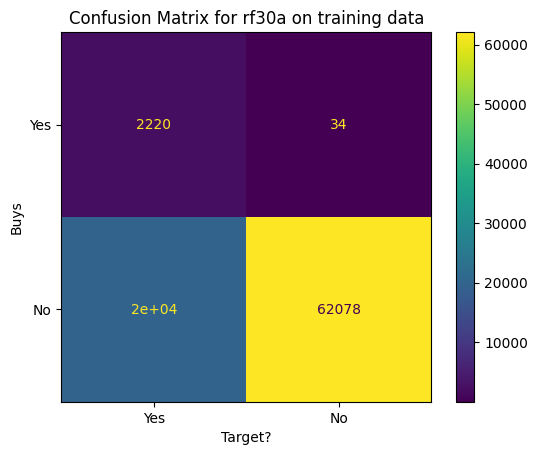

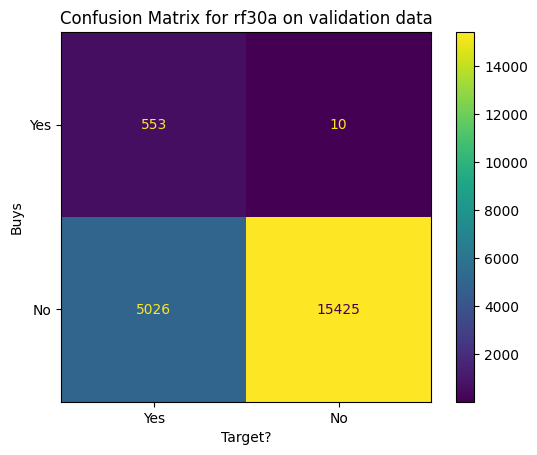

In [ ]:
manual_cw_a = {0: 0.5, 1: 25}
rf30a = plant_forest("rf30a", n_estimators=350, max_depth=5, min_samples_leaf=10, class_weight=manual_cw_a)

Trying randomsearch

In [ ]:
from scipy.stats import randint
from sklearn.model_selection import RandomizedSearchCV, KFold

# params_dist = {
#     'n_estimators': randint(300, 400),
#     'max_depth': randint(4, 15),
#     'max_features': randint(5, 10),
#     'min_samples_leaf': randint(5, 15)
# }


# rfc = RandomForestClassifier(class_weight='balanced', criterion='entropy', random_state=1917)
# rf_rand = RandomizedSearchCV(rfc, params_dist, scoring='recall', random_state=1917, verbose=1)
# rf_rand.fit(X_train, y_train)
# rs_params = rf_rand.best_params_
# print("RS best hyperparameter results: ", rs_params)
# train_score = rf_rand.score(X_train, y_train)
# val_score = rf_rand.score(X_val, y_val)
# print("RS training score: ", train_score)
# print("RS validation score: ", val_score)


RS best hyperparameter results: {'max_depth': 4, 'max_features': 7, 'min_samples_leaf': 13, 'n_estimators': 309}

In [ ]:
rf_rand = plant_forest("rf_rand", n_estimators=309, max_depth=4, max_features=7, min_samples_leaf=13, criterion='entropy', class_weight='balanced')

### 9. Assess Model Performance

In [ ]:
val_FNs = []
val_FPs = []

# base_FNs = cm_base_val[0][1]
# base_FPs = cm_base_val[1][0]

# val_FNs.append(base_FNs)
# val_FPs.append(base_FPs)

# for cm in cm_val_list:
#   val_FNs.append(cm[0][1])
#   val_FPs.append(cm[1][0])

# [0][1] represents FNs
# [1][0] represents FPs

In [ ]:
for val in max_features_list:
  if val == 'sqrt':
    val = 6

In [ ]:
len(model_names_list)
len(number_of_estimators_list)
len(max_depth_list)
len(avg_depth_list)
len(min_samples_leaf_list)
len(max_features_list)
len(training_accuracy_list)
len(training_recall_list)
len(training_f1_list)
len(val_FNs)

In [ ]:
rf_eval = pd.DataFrame({
    'Model': model_names_list,
    'No. Estimators': number_of_estimators_list,
    'Max Depth': max_depth_list,
    'Avg Depth': avg_depth_list,
    'Min Samples Leaf': min_samples_leaf_list,
    'Max Features': max_features_list,
    'Class Weight': class_weights,
    'Train Accuracy': training_accuracy_list,
    'Train Precision': training_precision_list,
    'Train Recall': training_recall_list,
    'Train F1': training_f1_list,
    'Train F2': training_f2_list,
    #'Validation FNs': val_FNs,
    #'Validation FPs': val_FPs,
    'Validation Accuracy': validation_accuracy_list,
    'Validation Precision': validation_precision_list,
    'Validation Recall': validation_recall_list,
    'Validation F1': validation_f1_list,
    'Validation F2': validation_f2_list,
    'Accuracy Generalization Loss': accuracy_losses_list,
    'Precision Generalization Loss': precision_losses_list,
    'Recall Generalization Loss': recall_losses_list,
    'F1 Generalization Loss': f1_losses_list
})

rf_eval.fillna("None", inplace=True)

In [ ]:
by_precision = rf_eval.sort_values('Validation Precision', ascending=False)
by_recall = rf_eval.sort_values('Validation Recall', ascending=False)
by_f1 = rf_eval.sort_values('Validation F1', ascending=False)
by_f2 = rf_eval.sort_values('Validation F2', ascending=False)

In [ ]:
by_precision.to_csv("exp-1-models-by-precision")
by_recall.to_csv("exp-1-models-by-recall")
by_f1.to_csv("exp-1-models-by-f1")
by_f2.to_csv("exp-1-models-by-f2")

In [ ]:
by_recall

In [ ]:
by_precision

In [ ]:
by_f1

- rf1 beats rf on validation recall and f1

In [ ]:
by_f2

Recall winners:

- RF28A (excluding low Precision models)
- RF_GS (auto-tuned and 5-fold cross-validated)
- RF_Rand (random-tuned and 5-fold cross-validated)

F1 winner:

- RF15

Testing Phase

In [ ]:
# test metrics
tested_models = []
test_preds = []
recall_tests = []
precision_tests = []
f1_tests = []
f4_tests = []
f10_tests = []
accuracy_tests = []
test_FNs = []
test_FPs = []

Testing RF26A (highest F2 Score)

In [ ]:
preds_rf26a_test = rf26a.predict(X_test)
recall_rf26a_test = recall_score(y_test, preds_rf26a_test)
precision_rf26a_test = precision_score(y_test, preds_rf26a_test)
f1_rf26a_test = f1_score(y_test, preds_rf26a_test)
f2_rf26a_test = fbeta_score(y_test, preds_rf26a_test, beta=2)
accuracy_rf26a_test = accuracy_score(y_test, preds_rf26a_test)
cm_rf26a_test = confusion_matrix(y_test, preds_rf26a_test)
FNs_rf26a_test = cm_rf26a_test[0, 1]
FPs_rf26a_test = cm_rf26a_test[1, 0]

# appending to lists
tested_models.append("RF26A")
test_preds.append(preds_rf26a_test)
recall_tests.append(recall_rf26a_test)
precision_tests.append(precision_rf26a_test)
f1_tests.append(f1_rf26a_test)
f2_tests.append(f2_rf26a_test)
accuracy_tests.append(accuracy_rf26a_test)
test_FNs.append(FNs_rf26a_test)
test_FPs.append(FNs_rf26a_test)

print("rf26a's Scores on Test Data: ")
print("   Recall: ", recall_rf26a_test)
print("   Precision: ", precision_rf26a_test)
print("   F1: ", f1_rf26a_test)
print("   F2: ", f2_rf26a_test)
print("   Accuracy: ", accuracy_rf26a_test)

# rf26a_test_CM =
ConfusionMatrixDisplay.from_estimator(rf26a, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'])

Testing RF28A

In [ ]:
preds_rf28a_test = rf28a.predict(X_test)
recall_rf28a_test = recall_score(y_test, preds_rf28a_test)
precision_rf28a_test = precision_score(y_test, preds_rf28a_test)
f1_rf28a_test = f1_score(y_test, preds_rf28a_test)
f2_rf28a_test = fbeta_score(y_test, preds_rf28a_test, beta=2)
accuracy_rf28a_test = accuracy_score(y_test, preds_rf28a_test)
cm_rf28a_test = confusion_matrix(y_test, preds_rf28a_test)
FNs_rf28a_test = cm_rf28a_test[0, 1]
FPs_rf28a_test = cm_rf28a_test[1, 0]

# appending to lists
test_preds.append(preds_rf28a_test)
recall_tests.append(recall_rf28a_test)
precision_tests.append(precision_rf28a_test)
f1_tests.append(f1_rf28a_test)
f2_tests.append(f2_rf28a_test)
accuracy_tests.append(accuracy_rf28a_test)
test_FNs.append(FNs_rf28a_test)
test_FPs.append(FNs_rf28a_test)

print("RF28A's Scores on Test Data: ")
print("   Recall: ", recall_rf28a_test)
print("   Precision: ", precision_rf28a_test)
print("   F1: ", f1_rf28a_test)
print("   F2: ", f2_rf28a_test)
print("   Accuracy: ", accuracy_rf28a_test)

# rf28A_test_CM =
ConfusionMatrixDisplay.from_estimator(rf28a, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'])

# plt.xlabel('Target')
# plt.ylabel('Buyer')
# plt.xticks(ticks=[1, 0], labels=['Yes', 'No'])
# plt.yticks(ticks=[0, 1], labels=['No', 'Yes'])
# plt.show()

In [ ]:
from matplotlib import pyplot as plt

Testing RF_GS

In [ ]:
cm_rf_gs_test

array([[21265,  4299],
       [   14,   690]])

In [ ]:
FPs_rf_gs_test

4299

rf_gs's Scores on Test Data: 
   Recall:  0.9801136363636364
   Precision:  0.13830426939266385
   F1:  0.24240295099244685
   F2:  0.44202434336963486
   F3:  0.609271523178808
   F4:  0.7217129145388544
   F10:  0.9244054172359363
   Accuracy:  0.8358078270138571


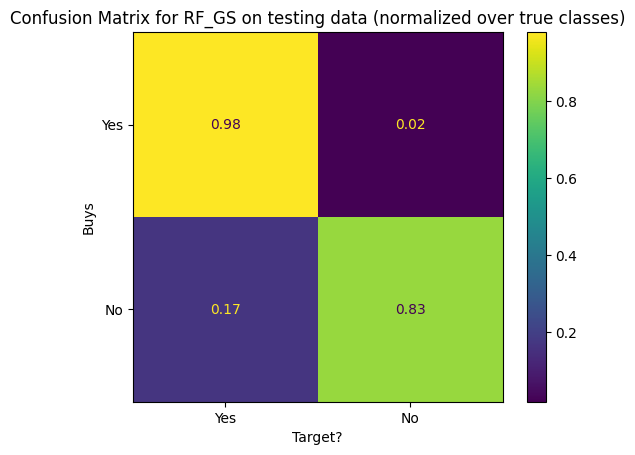

In [ ]:
# computing metrics
preds_rf_gs_test = rf_gs.predict(X_test)
recall_rf_gs_test = recall_score(y_test, preds_rf_gs_test)
precision_rf_gs_test = precision_score(y_test, preds_rf_gs_test)
f1_rf_gs_test = f1_score(y_test, preds_rf_gs_test)
f2_rf_gs_test = fbeta_score(y_test, preds_rf_gs_test, beta=2)
f3_rf_gs_test = fbeta_score(y_test, preds_rf_gs_test, beta=3)
f4_rf_gs_test = fbeta_score(y_test, preds_rf_gs_test, beta=4)
f10_rf_gs_test = fbeta_score(y_test, preds_rf_gs_test, beta=10)
accuracy_rf_gs_test = accuracy_score(y_test, preds_rf_gs_test)
cm_rf_gs_test = confusion_matrix(y_test, preds_rf_gs_test)
FNs_rf_gs_test = cm_rf_gs_test[1, 0]
FPs_rf_gs_test = cm_rf_gs_test[0, 1]

# appending to lists
tested_models.append("RF_GS")
test_preds.append(preds_rf_gs_test)
recall_tests.append(recall_rf_gs_test)
precision_tests.append(precision_rf_gs_test)
f1_tests.append(f1_rf_gs_test)
f4_tests.append(f4_rf_gs_test)
f10_tests.append(f10_rf_gs_test)
accuracy_tests.append(accuracy_rf_gs_test)
test_FNs.append(FNs_rf_gs_test)
test_FPs.append(FNs_rf_gs_test)

print("rf_gs's Scores on Test Data: ")
print("   Recall: ", recall_rf_gs_test)
print("   Precision: ", precision_rf_gs_test)
print("   F1: ", f1_rf_gs_test)
print("   F2: ", f2_rf_gs_test)
print("   F3: ", f3_rf_gs_test)
print("   F4: ", f4_rf_gs_test)
print("   F10: ", f10_rf_gs_test)
print("   Accuracy: ", accuracy_rf_gs_test)

rf_gs_test_CM = ConfusionMatrixDisplay.from_estimator(rf_gs, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'], normalize='true')
configure_CM(rf_gs_test_CM, "Confusion Matrix for RF_GS on testing data (normalized over true classes)")
# plt.xlabel('Target')
# plt.ylabel('Buyer')
# plt.xticks(ticks=[1, 0], labels=['Yes', 'No'])
# plt.yticks(ticks=[0, 1], labels=['No', 'Yes'])
plt.show()

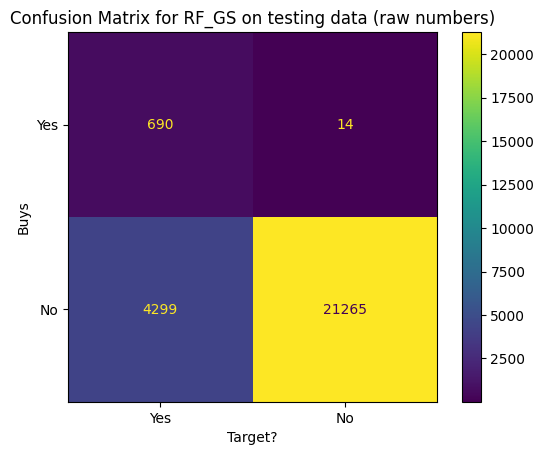

In [ ]:
rf_gs_test_CM_raw = ConfusionMatrixDisplay.from_estimator(rf_gs, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'])
configure_CM(rf_gs_test_CM_raw, "Confusion Matrix for RF_GS on testing data (raw numbers)")
plt.show()

In [ ]:
rf_gs_test_CM_pred = ConfusionMatrixDisplay.from_estimator(rf_gs, X_test, y_test, normalize='pred', labels=[1, 0], display_labels=['Yes', 'No'])
configure_CM(rf_gs_test_CM_pred, "Confusion Matrix for RF_GS on testing data (normalized over predictions)")
plt.show()

In [ ]:
len(y_test)

In [ ]:
avg_sale_price = 35000
rf_gs_TPs = cm_rf_gs_test[1, 1]
estimated_revenue = avg_sale_price * rf_gs_TPs
print("Estimated Revenue: ", estimated_revenue)

In [ ]:
FNs_rf_gs_test

In [ ]:
opportunity_cost = avg_sale_price * FNs_rf_gs_test
print("Estimated Opportunity Cost: ", opportunity_cost)

In [ ]:
value_add = estimated_revenue - opportunity_cost
print("Estimated Value Add: ", value_add)

RF_GS Feature Importances

In [ ]:
fi_rf_gs = rf_gs.feature_importances_
fi_rf_gs_df = pd.DataFrame({'Feature': X.columns, 'Importance': fi_rf_gs})
fi_rf_gs_df.sort_values('Importance', inplace=True, ascending=False)
fi_rf_gs_df['Importance (%)'] = (fi_rf_gs_df['Importance'] * 100).map('{:.2f}'.format)

import altair as alt

fi_rf_gs_chart = alt.Chart(fi_rf_gs_df).mark_bar().encode(
    x='Importance',
    y=alt.Y('Feature', sort='-x')
).properties(title="Feature Importances for RF_GS")

In [ ]:
fi_rf_gs_top = fi_rf_gs_df.head(20)
fi_rf_gs_top20_chart = alt.Chart(fi_rf_gs_top).mark_bar().encode(
    x='Importance',
    y=alt.Y('Feature', sort='-x')
).properties(title="Top 20 Most Important Features for RF_GS")

In [ ]:
fi_rf_gs_top20_chart

alt.Chart(...)

In [ ]:
fi_rf_gs_df = fi_rf_gs_df.drop('Importance', axis=1)
fi_rf_gs_df.reset_index(drop=True, inplace=True)
fi_rf_gs_df

Testing RF_GS4

In [ ]:
# computing metrics
preds_rf_gs4_test = rf_gs4.predict(X_test)
recall_rf_gs4_test = recall_score(y_test, preds_rf_gs4_test)
precision_rf_gs4_test = precision_score(y_test, preds_rf_gs4_test)
f1_rf_gs4_test = f1_score(y_test, preds_rf_gs4_test)
f2_rf_gs4_test = fbeta_score(y_test, preds_rf_gs4_test, beta=2)
accuracy_rf_gs4_test = accuracy_score(y_test, preds_rf_gs4_test)
cm_rf_gs4_test = confusion_matrix(y_test, preds_rf_gs4_test)
FNs_rf_gs4_test = cm_rf_gs4_test[0, 1]
FPs_rf_gs4_test = cm_rf_gs4_test[1, 0]

# appending to lists
test_preds.append(preds_rf_gs4_test)
recall_tests.append(recall_rf_gs4_test)
precision_tests.append(precision_rf_gs4_test)
f1_tests.append(f1_rf_gs4_test)
f2_tests.append(f2_rf_gs4_test)
accuracy_tests.append(accuracy_rf_gs4_test)
test_FNs.append(FNs_rf_gs4_test)
test_FPs.append(FNs_rf_gs4_test)

print("rf_gs4's Scores on Test Data: ")
print("   Recall: ", recall_rf_gs4_test)
print("   Precision: ", precision_rf_gs4_test)
print("   F1: ", f1_rf_gs4_test)
print("   F2: ", f2_rf_gs4_test)
print("   Accuracy: ", accuracy_rf_gs4_test)

ConfusionMatrixDisplay.from_estimator(rf_gs4, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'], normalize='true')

Testing RF_Rand

In [ ]:
preds_rf_rand_test = rf_rand.predict(X_test)
recall_rf_rand_test = recall_score(y_test, preds_rf_rand_test)
precision_rf_rand_test = precision_score(y_test, preds_rf_rand_test)
f1_rf_rand_test = f1_score(y_test, preds_rf_rand_test)
f2_rf_rand_test = fbeta_score(y_test, preds_rf_rand_test, beta=2)
accuracy_rf_rand_test = accuracy_score(y_test, preds_rf_rand_test)
cm_rf_rand = confusion_matrix(y_test, preds_rf_rand_test)
FNs_rf_rand_test = cm_rf_rand[0, 1]
FPs_rf_rand_test = cm_rf_rand[1, 0]

# appending to lists
test_preds.append(preds_rf_rand_test)
recall_tests.append(recall_rf_rand_test)
precision_tests.append(precision_rf_rand_test)
f1_tests.append(f1_rf_rand_test)
f2_tests.append(f2_rf_rand_test)
accuracy_tests.append(accuracy_rf_rand_test)
test_FNs.append(FNs_rf_rand_test)
test_FPs.append(FNs_rf_rand_test)

# Printing results
print("rf_rand's Scores on Test Data: ")
print("   Recall: ", recall_rf_rand_test)
print("   Precision: ", precision_rf_rand_test)
print("   F1: ", f1_rf_rand_test)
print("   F2: ", f2_rf_rand_test)
print("   Accuracy: ", accuracy_rf_rand_test)

# Displaying Confusion Matrix
# rf_rand_test_CM =

ConfusionMatrixDisplay.from_estimator(rf_rand, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'], normalize='true')

# plt.xlabel('Target')
# plt.ylabel('Buyer')
# plt.xticks(ticks=[1, 0], labels=['Yes', 'No'])
# plt.yticks(ticks=[0, 1], labels=['No', 'Yes'])
# plt.show()

97% of Positives captured. 75% of Negatives captured.

raw numbers

In [ ]:
ConfusionMatrixDisplay.from_estimator(rf_rand, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'])

normalized over predictions

In [ ]:
ConfusionMatrixDisplay.from_estimator(rf_rand, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'], normalize='pred')

Testing RF30 (second on Recall with stronger F1 and Precision Scores

In [ ]:
cm_rf30

array([[20892,  4672],
       [   13,   691]])

rf30's Scores on Test Data: 
   Recall:  0.9815340909090909
   Precision:  0.12884579526384488
   F1:  0.2277896818856107
   F2:  0.42242327912947797
   F3:  0.5906487733994359
   F4:  0.7065014735069467
   F10:  0.92117524385254
   Accuracy:  0.8216461093345515


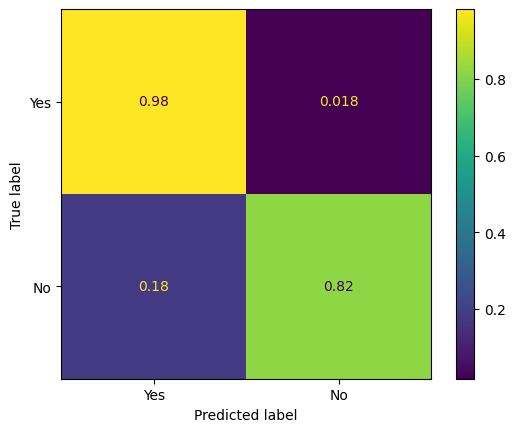

In [ ]:
preds_rf30_test = rf30.predict(X_test)
recall_rf30_test = recall_score(y_test, preds_rf30_test)
precision_rf30_test = precision_score(y_test, preds_rf30_test)
f1_rf30_test = f1_score(y_test, preds_rf30_test)
f2_rf30_test = fbeta_score(y_test, preds_rf30_test, beta=2)
f3_rf30_test = fbeta_score(y_test, preds_rf30_test, beta=3)
f4_rf30_test = fbeta_score(y_test, preds_rf30_test, beta=4)
f10_rf30_test = fbeta_score(y_test, preds_rf30_test, beta=10)
accuracy_rf30_test = accuracy_score(y_test, preds_rf30_test)
cm_rf30 = confusion_matrix(y_test, preds_rf30_test)
FNs_rf30_test = cm_rf30[1, 0]
FPs_rf30_test = cm_rf30[0, 1]

# appending to lists
tested_models.append("RF30")
test_preds.append(preds_rf30_test)
recall_tests.append(recall_rf30_test)
precision_tests.append(precision_rf30_test)
f1_tests.append(f1_rf30_test)
f4_tests.append(f4_rf30_test)
f10_tests.append(f10_rf30_test)
accuracy_tests.append(accuracy_rf30_test)
test_FNs.append(FNs_rf30_test)
test_FPs.append(FNs_rf30_test)

# Printing results
print("rf30's Scores on Test Data: ")
print("   Recall: ", recall_rf30_test)
print("   Precision: ", precision_rf30_test)
print("   F1: ", f1_rf30_test)
print("   F2: ", f2_rf30_test)
print("   F3: ", f3_rf30_test)
print("   F4: ", f4_rf30_test)
print("   F10: ", f10_rf30_test)
print("   Accuracy: ", accuracy_rf30_test)

# Displaying Confusion Matrix
# rf30a_test_CM =

ConfusionMatrixDisplay.from_estimator(rf30, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'], normalize='true')

RF30's Feature Importances

In [ ]:
fi_rf30 = rf30.feature_importances_
fi_rf30_df = pd.DataFrame({'Feature': X.columns, 'Importance': fi_rf30})
fi_rf30_df.sort_values('Importance', inplace=True, ascending=False)
fi_rf30_df['Importance (%)'] = (fi_rf30_df['Importance'] * 100).map('{:.2f}'.format)

import altair as alt

fi_rf30_chart = alt.Chart(fi_rf30_df).mark_bar().encode(
    x='Importance',
    y=alt.Y('Feature', sort='-x')
)

In [ ]:
fi_rf30_chart

In [ ]:
fi_rf30_df = fi_rf30_df.drop('Importance', axis=1)
fi_rf30_df.reset_index(drop=True, inplace=True)
fi_rf30_df

Testing RF30A (Recall winner)

rf30a's Scores on Test Data: 
   Recall:  0.9886363636363636
   Precision:  0.10314167160640189
   F1:  0.18679549114331723
   F2:  0.36386449184441655
   F3:  0.5906487733994359
   F4:  0.6568954030646236
   F10:  0.9111836988645203
   Accuracy:  0.7693010507080859


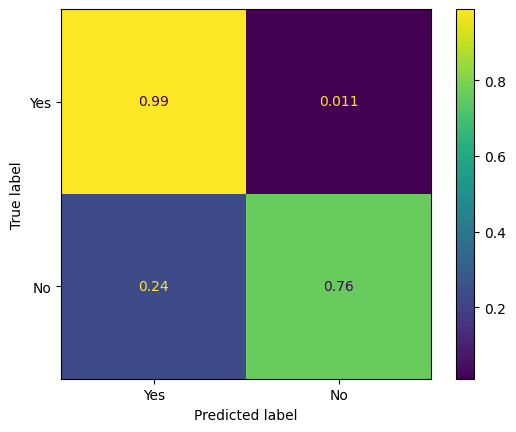

In [ ]:
preds_rf30a_test = rf30a.predict(X_test)
recall_rf30a_test = recall_score(y_test, preds_rf30a_test)
precision_rf30a_test = precision_score(y_test, preds_rf30a_test)
f1_rf30a_test = f1_score(y_test, preds_rf30a_test)
f2_rf30a_test = fbeta_score(y_test, preds_rf30a_test, beta=2)
f3_rf30a_test = fbeta_score(y_test, preds_rf30a_test, beta=3)
f4_rf30a_test = fbeta_score(y_test, preds_rf30a_test, beta=4)
f10_rf30a_test = fbeta_score(y_test, preds_rf30a_test, beta=10)

accuracy_rf30a_test = accuracy_score(y_test, preds_rf30a_test)
cm_rf30a = confusion_matrix(y_test, preds_rf30a_test)
FNs_rf30a_test = cm_rf30a[0, 1]
FPs_rf30a_test = cm_rf30a[1, 0]

# appending to lists
tested_models.append("RF30A")
test_preds.append(preds_rf30a_test)
recall_tests.append(recall_rf30a_test)
precision_tests.append(precision_rf30a_test)
f1_tests.append(f1_rf30a_test)
f4_tests.append(f4_rf30a_test)
f10_tests.append(f10_rf30a_test)
accuracy_tests.append(accuracy_rf30a_test)
test_FNs.append(FNs_rf30a_test)
test_FPs.append(FNs_rf30a_test)

# Printing results
print("rf30a's Scores on Test Data: ")
print("   Recall: ", recall_rf30a_test)
print("   Precision: ", precision_rf30a_test)
print("   F1: ", f1_rf30a_test)
print("   F2: ", f2_rf30a_test)
print("   F3: ", f3_rf30_test)
print("   F4: ", f4_rf30a_test)
print("   F10: ", f10_rf30a_test)
print("   Accuracy: ", accuracy_rf30a_test)

# Displaying Confusion Matrix
# rf30a_test_CM =

ConfusionMatrixDisplay.from_estimator(rf30a, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'], normalize='true')

# plt.xlabel('Target')
# plt.ylabel('Buyer')
# plt.xticks(ticks=[1, 0], labels=['Yes', 'No'])
# plt.yticks(ticks=[0, 1], labels=['No', 'Yes'])
# plt.show()

98% of true positives captured. 75% of true negatives captured.

Raw numbers (non-normalized)

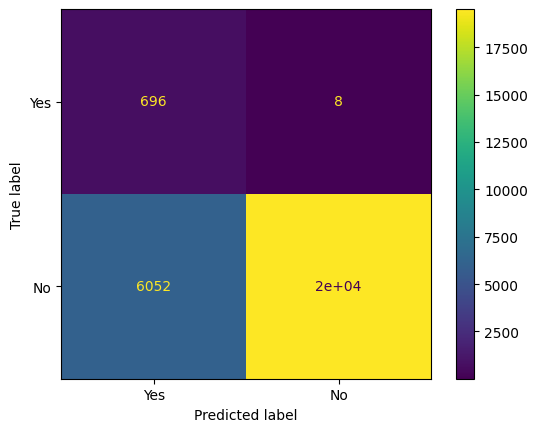

In [ ]:
ConfusionMatrixDisplay.from_estimator(rf30a, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'])

Normalized over predictions

In [ ]:
ConfusionMatrixDisplay.from_estimator(rf30a, X_test, y_test, labels=[1, 0], display_labels=['Yes', 'No'], normalize='pred')

RF30A has slightly less than a 10% hit rate for targets.

RF30A's feature importances

In [ ]:
fi_rf30a = rf30a.feature_importances_
fi_rf30a_df = pd.DataFrame({'Feature': X.columns, 'Importance': fi_rf30})
fi_rf30a_df.sort_values('Importance', inplace=True, ascending=False)

fi_rf30a_chart = alt.Chart(fi_rf30a_df).mark_bar().encode(
    x=alt.X('Feature', sort='-y'),
    y='Importance'
)
fi_rf30a_chart

In [ ]:
fi_rf30a_df['Importance (%)'] = (fi_rf30a_df['Importance'] * 100).map('{:.2f}'.format)
fi_rf30a_df = fi_rf30a_df.drop('Importance', axis=1)
fi_rf30a_df.reset_index(drop=True, inplace=True)
fi_rf30a_df

Merged FI importance table for the three test winners

In [ ]:
agg_FIs = fi_rf_gs_df.merge(fi_rf30_df, on='Feature', suffixes=(" GS", " RF30")).merge(fi_rf30a_df, on='Feature')
#agg_FIs['Importance'] = (agg_FIs['Importance'] * 100).round(2)
agg_FIs.rename({'Importance (%)': 'Importance (%) RF30A'}, axis=1, inplace=True)
agg_FIs['Mean Importance (%)'] = ((agg_FIs['Importance (%) GS'].astype(float) + agg_FIs['Importance (%) RF30'].astype(float) + agg_FIs['Importance (%) RF30A'].astype(float)) / 3).round(2)
agg_FIs.sort_values('Mean Importance (%)', inplace=True, ascending=False)
agg_FIs.reset_index(drop=True, inplace=True)
agg_FIs

NameError: name 'fi_rf_gs_df' is not defined

In [ ]:
agg_FIs.to_csv("Agg FIs for best RFs")

In [ ]:
agg_FIs_top_15 = agg_FIs.head(15)

In [ ]:
agg_FIs_chart = alt.Chart(data=agg_FIs_top_15).mark_bar().encode(
    x='Mean Importance (%)',
    y=alt.Y('Feature', sort='-x')
).properties(
    title='Top 15 Most Important Features on Average for Top 3 Tested Random Forest Models'
)
agg_FIs_chart

Test Results

In [ ]:
tested_RFs_DF = pd.DataFrame({
    'Model': tested_models,
    'Recall': recall_tests,
    'Precision': precision_tests,
    'F1': f1_tests,
    'F4': f4_tests,
    'F10': f10_tests,
    'Accuracy': accuracy_tests,
    'FNs': test_FNs,
    'FPs': test_FPs
})

In [ ]:
# Define a function to multiply by 100 and round to two decimal places
def multiply_and_round(value):
    if isinstance(value, float):  # Check if the value is a float
        return round(value * 100, 2)  # Multiply by 100 and round to two decimal places
    else:
        return value  # If not a float, return the original value

# Apply the function to every element of the DataFrame
tested_RFs_DF = tested_RFs_DF.applymap(multiply_and_round)


In [ ]:
tested_rfs_by_recall = tested_RFs_DF.sort_values('Recall', ascending=False)
tested_rfs_by_F1 = tested_RFs_DF.sort_values('F1', ascending=False)
tested_rfs_by_F4 = tested_RFs_DF.sort_values('F4', ascending=False)
tested_rfs_by_F10 = tested_RFs_DF.sort_values('F10', ascending=False)

In [ ]:
tested_rfs_by_recall

In [ ]:
tested_rfs_by_F1

In [ ]:
tested_rfs_by_F4

In [ ]:
tested_rfs_by_F10

,Model,Recall,Precision,F1,F4,F10,Accuracy,FNs,FPs
0,RF_GS,98.01,13.83,24.24,72.17,92.44,83.58,14,14
1,RF30,98.15,12.88,22.78,70.65,92.12,82.16,4672,4672
2,RF30A,98.86,10.31,18.68,65.69,91.12,76.93,6052,6052


Saving RF_GS

In [ ]:
import pickle

outfile = open('RF_GS.pkl', 'wb')
pickle.dump(rf_gs, outfile)
outfile.close()